In [1]:
# On importe les bibliothèques utiles pour le projet
import keras
import tensorflow as tf
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import functools
import os
import cv2
import glob
import keras_segmentation
import imgaug.augmenters as iaa
from imgaug.augmentables.segmaps import SegmentationMapsOnImage
# Les functions écrites dans un fichier externe
from functions import *

from collections import namedtuple
from types import MethodType
from time import time

from keras_segmentation.models.unet import vgg_unet, resnet50_unet
from keras_segmentation.models.fcn import fcn_8_vgg, fcn_8_resnet50, fcn_32_resnet50
from keras_segmentation.models.segnet import vgg_segnet, resnet50_segnet
from keras import backend as K
from keras.utils import Sequence, to_categorical
from keras.callbacks import Callback, TensorBoard, ModelCheckpoint, EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.image as mpimg
import keras.utils as image

from dilatednet import DilatedNet
# Import des modèles créé en interne
from models import build_vgg16_unet

In [2]:
tf.__version__

'2.10.0'

In [3]:
keras.__version__

'2.10.0'

In [4]:
physical_devices = tf.config.list_physical_devices('GPU')
print("Num GPUs Available:", len(physical_devices))

Num GPUs Available: 1


In [5]:
print(tf.config.list_physical_devices('GPU'))

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## Modification des images (Nom + suppression de certain masks) + normalisation de pixels
* Travailler uniquement les jeux de Train et Validation pour pouvoir entraîner et évaluer les modèles (capacité à prédire correctement) (Les masks de tests ne sont pas utilisable);
* Garder le set Validation pour en faire un set de Test ;
* Créer un nouveau set de Validation en faisant un split sur le set Train : 80% pour l'entraînement, 20% pour la validation.

### Définition des sous catégories

In [6]:
# Adaptation from the official Cityscapes scripts
# https://github.com/mcordts/cityscapesScripts/blob/master/cityscapesscripts/helpers/labels.py

#--------------------------------------------------------------------------------
# Definitions : 
#--------------------------------------------------------------------------------
# Create tuple subclasses with named fields
Label = namedtuple( 'Label' , [

    'name'        , # The identifier of this label, e.g. 'car', 'person', ... .
                    # We use them to uniquely name the 30 classes

    'id'          , # An integer ID that is associated with this label.

    'categoryId'       , # IDs of labels which match to pixel values
                    # corresponding to the 8 main categories.

    'category'    , # The name of the category that this label belongs to
    ] )

#--------------------------------------------------------------------------------
# A list of all labels
#--------------------------------------------------------------------------------

labels = [
    #name                             id    catId   category
    Label(  'unlabeled'            ,  0 ,      0 , 'void'),
    Label(  'ego vehicle'          ,  1 ,      0 , 'void'),
    Label(  'rectification border' ,  2 ,      0 , 'void'),
    Label(  'out of roi'           ,  3 ,      0 , 'void'),
    Label(  'static'               ,  4 ,      0 , 'void'),
    Label(  'dynamic'              ,  5 ,      0 , 'void'),
    Label(  'ground'               ,  6 ,      0 , 'void'),
    Label(  'road'                 ,  7 ,      1 , 'flat'),
    Label(  'sidewalk'             ,  8 ,      1 , 'flat'),
    Label(  'parking'              ,  9 ,      1 , 'flat'),
    Label(  'rail track'           , 10 ,      1 , 'flat'),
    Label(  'building'             , 11 ,      2 , 'construction'),
    Label(  'wall'                 , 12 ,      2 , 'construction'),
    Label(  'fence'                , 13 ,      2 , 'construction'),
    Label(  'guard rail'           , 14 ,      2 , 'construction'),
    Label(  'bridge'               , 15 ,      2 , 'construction'),
    Label(  'tunnel'               , 16 ,      2 , 'construction'),
    Label(  'pole'                 , 17 ,      3 , 'object'),
    Label(  'polegroup'            , 18 ,      3 , 'object'),
    Label(  'traffic light'        , 19 ,      3 , 'object'),
    Label(  'traffic sign'         , 20 ,      3 , 'object'),
    Label(  'vegetation'           , 21 ,      4 , 'nature'),
    Label(  'terrain'              , 22 ,      4 , 'nature'),
    Label(  'sky'                  , 23 ,      5 , 'sky'),
    Label(  'person'               , 24 ,      6 , 'human'),
    Label(  'rider'                , 25 ,      6 , 'human'),
    Label(  'car'                  , 26 ,      7 , 'vehicle'),
    Label(  'truck'                , 27 ,      7 , 'vehicle'),
    Label(  'bus'                  , 28 ,      7 , 'vehicle'),
    Label(  'caravan'              , 29 ,      7 , 'vehicle'),
    Label(  'trailer'              , 30 ,      7 , 'vehicle'),
    Label(  'train'                , 31 ,      7 , 'vehicle'),
    Label(  'motorcycle'           , 32 ,      7 , 'vehicle'),
    Label(  'bicycle'              , 33 ,      7 , 'vehicle'),
    Label(  'license plate'        , -1 ,      7 , 'vehicle')]

In [7]:
# Nettoyage et préparation des images d'entraînement
#chemin_source_images_train = 'datas/images/train/'
#chemin_nouveau_dossier_images_train = 'datas/images/train_clean'

#regroupement_renommage_datas(chemin_source_images_train, chemin_nouveau_dossier_images_train, type="images")

In [8]:
# Nettoyage et préparation des masks d'entraînement
#chemin_source_masks_train = 'datas/masks/train/'
#chemin_nouveau_dossier_masks_train = 'datas/masks/train_clean'

#regroupement_renommage_datas(chemin_source_masks_train, chemin_nouveau_dossier_masks_train, type="masks")

In [9]:
# Nettoyage et préparation des images de validation
#chemin_source_images_val = 'datas/images/val/'
#chemin_nouveau_dossier_images_val = 'datas/images/val_clean'

#regroupement_renommage_datas(chemin_source_images_val, chemin_nouveau_dossier_images_val, type="images")

In [10]:
# Nettoyage et préparation des masks de validation
#chemin_source_masks_val = 'datas/masks/val/'
#chemin_nouveau_dossier_masks_val = 'datas/masks/val_clean'

#regroupement_renommage_datas(chemin_source_masks_val, chemin_nouveau_dossier_masks_val, type="masks")

In [11]:
# Nettoyage et préparation des images de test
#chemin_source_images_test = 'datas/images/test/'
#chemin_nouveau_dossier_images_test = 'datas/images/test_clean'

#regroupement_renommage_datas(chemin_source_images_test, chemin_nouveau_dossier_images_test, type="images")

In [12]:
# Nettoyage et préparation des masks de test
#chemin_source_masks_test = 'datas/masks/test/'
#chemin_nouveau_dossier_masks_test = 'datas/masks/test_clean'

#regroupement_renommage_datas(chemin_source_masks_test, chemin_nouveau_dossier_masks_test, type="masks")

In [13]:
checkpoint_path = '/checkpoints'

# Set origin folders
train_image_dir = 'datas/images/train'
train_mask_dir = 'datas/masks/train'
val_image_dir = 'datas/images/val'
val_mask_dir = 'datas/masks/val'

# Set final destination folders
train_input_dir = 'datas/images/train_clean'
train_masks30_dir = 'datas/masks/train_clean'
test_input_dir = 'datas/images/test_clean'
test_masks30_dir = 'datas/masks/test_clean'
val_input_dir = 'datas/images/val_clean'
val_masks30_dir = 'datas/masks/val_clean'

# Set final destination folders for masks colors
train_mask30_color = 'datas/masks/train_color_original'
test_mask30_color = 'datas/masks/test_color_original'
val_mask30_color = 'datas/masks/val_color_original'

# Set masks folders with 8 main categories
train_target_dir = 'datas/masks/train_clean_normalized'
val_target_dir = 'datas/masks/val_clean_normalized'
test_target_dir = 'datas/masks/test_clean_normalized'

In [14]:
# Call the function for move file (train to train_clean and val to test_clean)
#move_files(train_image_dir, train_input_dir, is_mask=False)
#move_files(train_mask_dir, train_masks30_dir, is_mask=True)
#move_masks_colors(train_mask_dir,train_mask30_color)
#move_files(val_image_dir, test_input_dir, is_mask=False)
#move_files(val_mask_dir, test_masks30_dir, is_mask=True)
#move_masks_colors(val_mask_dir,test_mask30_color)

In [15]:
# Call the function for rename file delete suffix
#rename_file(train_input_dir, is_mask=False)
#rename_file(train_masks30_dir, is_mask=True)
#rename_file(test_input_dir, is_mask=False)
#rename_file(test_masks30_dir, is_mask=True)

In [16]:
print('Train Images Count: ', len(os.listdir(train_input_dir)), '- 1st file name: ', sorted(os.listdir(train_input_dir))[0])
print('Train Masks Count: ', len(os.listdir(train_masks30_dir)), '- 1st file name: ', sorted(os.listdir(train_masks30_dir))[0])
print('Test Images Count: ', len(os.listdir(test_input_dir)), '- 1st file name: ', sorted(os.listdir(test_input_dir))[0])
print('Test Masks Count: ', len(os.listdir(test_masks30_dir)), '- 1st file name: ', sorted(os.listdir(test_masks30_dir))[0])

Train Images Count:  2380 - 1st file name:  aachen_000000_000019.png
Train Masks Count:  2380 - 1st file name:  aachen_000000_000019.png
Test Images Count:  500 - 1st file name:  frankfurt_000000_000294.png
Test Masks Count:  500 - 1st file name:  frankfurt_000000_000294.png


In [17]:
# Sort the images and masks of Train dataset
train_input_fname = sorted(
    [os.path.join(
        train_input_dir, fname) for fname in os.listdir(train_input_dir)])

train_target_fname = sorted(
    [os.path.join(
        train_masks30_dir, fname) for fname in os.listdir(train_masks30_dir)])

#train_maskColor_fname = sorted(
#    [os.path.join(
#        train_mask30_color, fname) for fname in os.listdir(train_mask30_color)])

In [18]:
# Split into train and validation data (80% train and 20% val)
#val_input_path = train_input_fname[2380:]
#val_target_path = train_target_fname[2380:]
#val_mask30color_path = train_maskColor_fname[2380:]

In [19]:
# Move files from Train to Val
#move_files(val_input_path, val_input_dir)
#move_files(val_target_path, val_masks30_dir)
#move_masks_colors(val_mask30color_path, val_mask30_color)

In [20]:
# Check files
print('Val Images Count: ', len(os.listdir(val_input_dir)), '- 1st file name: ', sorted(os.listdir(val_input_dir))[0])
print('Val Masks Count: ', len(os.listdir(val_masks30_dir)), '- 1st file name: ', sorted(os.listdir(val_masks30_dir))[0])

Val Images Count:  595 - 1st file name:  stuttgart_000104_000019.png
Val Masks Count:  595 - 1st file name:  stuttgart_000104_000019.png


In [21]:
# Save the masks for TRAIN
#old_to_new_mask(train_input_dir, train_masks30_dir, train_target_dir, labels)

# Save the masks for VAL
#old_to_new_mask(val_input_dir, val_masks30_dir, val_target_dir, labels)

# Save the masks for TEST
#old_to_new_mask(test_input_dir, test_masks30_dir, test_target_dir, labels)

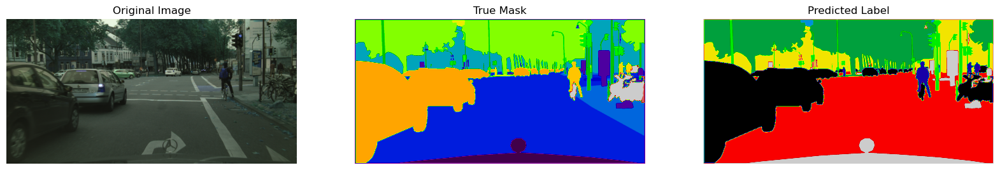

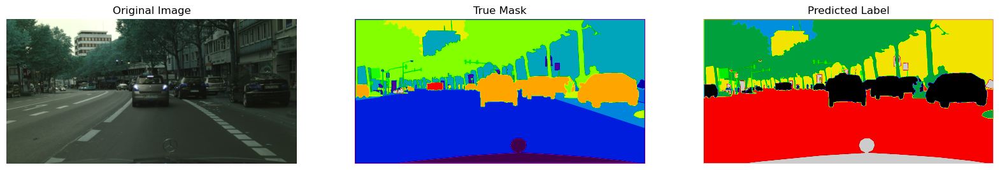

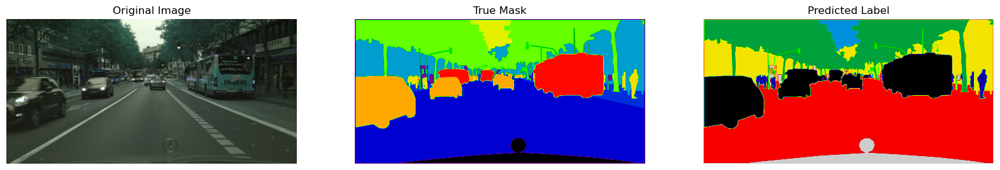

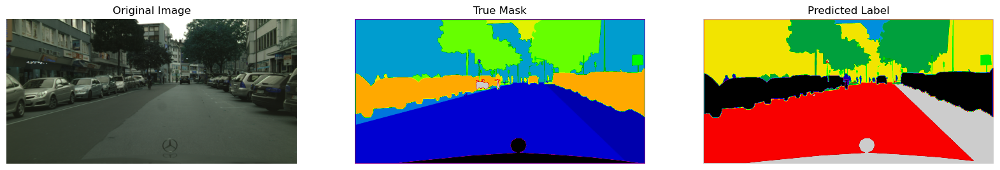

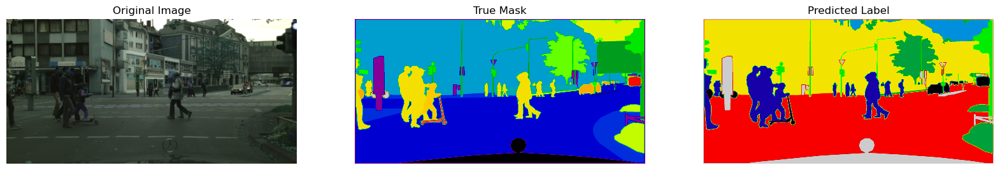

In [22]:
# Call the function
visualize_img_msk30_msk8(train_input_dir, train_masks30_dir,
                         train_target_dir, n=10)

In [23]:
# Normalisation des masks d'entrainement (Pour les models keras_segmentation)
#chemin_source_masks_train = 'datas/masks/train_clean'
#chemin_masks_train_normalized = 'datas/masks/train_clean_normalized'

#normalisation_mask(chemin_source_masks_train, chemin_masks_train_normalized)

In [24]:
# Normalisation des masks de validation (Pour les models keras_segmentation)
#chemin_source_masks_val = 'datas/masks/val_clean'
#chemin_masks_val_normalized = 'datas/masks/val_clean_normalized'

#normalisation_mask(chemin_source_masks_val, chemin_masks_val_normalized)

# Importation des images (Train/Validation/Test)

In [25]:
# On initialise le tableau comparatif
tab_compare = []

In [26]:
# Set all paths to folders: project, model, images, masks
train_input_dir = 'datas/images/train_clean'
train_mask_dir = 'datas/masks/train_clean'
train_target_dir = 'datas/masks/train_clean_normalized'
val_input_dir = 'datas/images/val_clean'
val_mask_dir = 'datas/masks/val_clean'
val_target_dir = 'datas/mask/val_clean_normalized'
test_input_dir = 'datas/images/test_clean'
test_mask_dir = 'datas/masks/test_clean'
test_target_dir = 'datas/masks/test_clean_normalized'

In [27]:
train_input_path = sorted(glob.glob(train_input_dir + '/*.png'))
train_mask_path = sorted(glob.glob(train_mask_dir +'/*.png'))
train_target_path = sorted(glob.glob(train_target_dir +'/*.png'))
print('TRAIN -- Number of images: ', len(train_input_path), 
      ' - Number of original masks: ', len(train_mask_path))
print(train_input_path[0] + '\n')

val_input_path = sorted(glob.glob(val_input_dir + '/*.png'))
val_mask_path = sorted(glob.glob(val_mask_dir +'/*.png'))
val_target_path = sorted(glob.glob(val_target_dir +'/*.png'))
print('VAL -- Number of images: ', len(val_input_path), 
      ' - Number of original masks: ', len(val_mask_path))
print(val_input_path[0] + '\n')

test_input_path = sorted(glob.glob(test_input_dir + '/*.png'))
test_mask_path = sorted(glob.glob(test_mask_dir +'/*.png'))
test_target_path = sorted(glob.glob(test_target_dir +'/*.png'))
print('TEST -- Number of images: ', len(test_input_path), 
      ' - Number of original masks: ', len(test_mask_path))
print(test_input_path[0])

TRAIN -- Number of images:  2380  - Number of original masks:  2380
datas/images/train_clean\aachen_000000_000019.png

VAL -- Number of images:  595  - Number of original masks:  595
datas/images/val_clean\stuttgart_000104_000019.png

TEST -- Number of images:  500  - Number of original masks:  500
datas/images/test_clean\frankfurt_000000_000294.png


In [28]:
cats = {'void': [0, 1, 2, 3, 4, 5, 6],
 'flat': [7, 8, 9, 10],
 'construction': [11, 12, 13, 14, 15, 16],
 'object': [17, 18, 19, 20],
 'nature': [21, 22],
 'sky': [23],
 'human': [24, 25],
 'vehicle': [26, 27, 28, 29, 30, 31, 32, 33, -1]}

In [29]:
def dice_coeff(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    score = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return score

def dice_loss(y_true, y_pred):
    loss = 1 - dice_coeff(y_true, y_pred)
    return loss

def total_loss(y_true, y_pred):
    loss = binary_crossentropy(y_true, y_pred) + (3*dice_loss(y_true, y_pred))
    return loss

In [30]:
# sanity check jeu d'entraînement, de test, validation
for i in range(len(train_input_path)):
    assert train_input_path[1].split('\\')[-1]  == train_mask_path[1].split('\\')[-1]
    
for i in range(len(test_input_path)):
    assert test_input_path[1].split('\\')[-1]  == test_mask_path[1].split('\\')[-1]
    
for i in range(len(val_input_path)):
    assert val_input_path[1].split('\\')[-1]  == val_mask_path[1].split('\\')[-1]

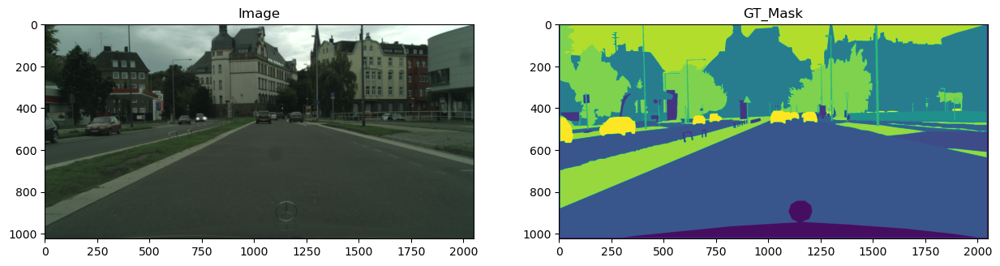

In [31]:
i = 1
test_image = image.img_to_array(image.load_img(f'{train_input_path[i]}'))/255.
test_mask = image.img_to_array(image.load_img(f'{train_mask_path[i]}', color_mode = "grayscale"))
test_mask = np.squeeze(test_mask)

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(1, 2, 1)
ax.set_title('Image')
ax.imshow(test_image)

ax1 = fig.add_subplot(1, 2, 2)
ax1.set_title('GT_Mask')
ax1.imshow(test_mask)

# Création data generator

In [33]:
batch_size = 8
samples = 50000
steps = samples//batch_size
img_height, img_width = 128, 128
classes = 8
filters_n = 64

In [33]:
class DataGenerator(Sequence):
    def __init__(self, input_path, target_path, batch_size, augmentation):
        self.input_path = input_path
        self.target_path = target_path
        self.batch_size = batch_size
        self.augmentation = augmentation
        
        # Définir les indexes
        self.indexes = np.arange(len(self.input_path))

        # Ajoutez la data augmentation
        if self.augmentation:
            self.seq = iaa.Sequential([
                iaa.Dropout([0.05, 0.2]),      # drop 5% or 20% of all pixels
                iaa.Sharpen((0.0, 1.0)),       # sharpen the image
                iaa.Affine(rotate=(-45, 45)),  # rotate by -45 to 45 degrees (affects segmaps)
                iaa.ElasticTransformation(alpha=50, sigma=5)  # apply water effect (affects segmaps)
            ], random_order=True)
        
    def __len__(self):
        return int(np.ceil(len(self.input_path) / float(self.batch_size)))

    def __getitem__(self, idx):
        indexes = self.indexes[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_x, batch_y = [], []
        drawn = 0

        for i in indexes:
            _image = img_to_array(load_img(f'{self.input_path[i]}', target_size=(img_height, img_width)))/255.   
            mask = img_to_array(load_img(f'{self.target_path[i]}', color_mode = "grayscale", target_size=(img_height, img_width)))
            
            if self.augmentation:
                mask = mask.astype(np.uint8)
                # Appliquer la data augmentation à l'image et au masque
                augmented = self.seq(image=_image, segmentation_maps=SegmentationMapsOnImage(mask, shape=_image.shape))
                _image_aug = augmented[0]  # Premier élément du tuple est l'image augmentée
                mask_aug = augmented[1].get_arr().squeeze()  # Deuxième élément du tuple est le masque augmenté
            
            mask = np.squeeze(mask)
            mask_f = np.zeros((mask.shape[0], mask.shape[1], 8))
            for label in range(-1, 34):
                if label in cats['void']:
                    mask_f[:,:,0] = np.logical_or(mask_f[:,:,0], (mask==label))
                elif label in cats['flat']:
                    mask_f[:,:,1] = np.logical_or(mask_f[:,:,1], (mask==label))
                elif label in cats['construction']:
                    mask_f[:,:,2] = np.logical_or(mask_f[:,:,2], (mask==label))
                elif label in cats['object']:
                    mask_f[:,:,3] = np.logical_or(mask_f[:,:,3], (mask==label))
                elif label in cats['nature']:
                    mask_f[:,:,4] = np.logical_or(mask_f[:,:,4], (mask==label))
                elif label in cats['sky']:
                    mask_f[:,:,5] = np.logical_or(mask_f[:,:,5], (mask==label))
                elif label in cats['human']:
                    mask_f[:,:,6] = np.logical_or(mask_f[:,:,6], (mask==label))
                elif label in cats['vehicle']:
                    mask_f[:,:,7] = np.logical_or(mask_f[:,:,7], (mask==label))
            
            mask_f = np.resize(mask_f,(img_height*img_width, 8))
            batch_y.append(mask_f)
            batch_x.append(_image)
            drawn += 1
        
        return np.array(batch_x), np.array(batch_y)

# Génération des modèles de segmentation

## Test du modèle Unet

In [35]:
unet = DilatedNet(128, 128, 8,use_ctx_module=True, bn=True)
#p_unet = multi_gpu_model(unet, 4)
unet.compile(optimizer='adam', loss='categorical_crossentropy', metrics=[dice_coeff, 'accuracy', tf.keras.metrics.MeanIoU(num_classes=8, name='mean_iou')])
tb = TensorBoard(log_dir='logs', write_graph=True)
mc = ModelCheckpoint(mode='max', filepath='models-dr/pdilated.h5', monitor='acc', save_best_only='True', save_weights_only='True', verbose=1)
es = EarlyStopping(mode='max', monitor='acc', patience=6, verbose=1)
callbacks = [tb, mc, es]
# datagenerator du jeu d'entraînement avec la data augmentation
train_gen_data_augm = DataGenerator(train_input_path, train_mask_path, batch_size, True)
# datagenerator du jeu de validation avec la data augmentation
val_gen_data_augm = DataGenerator(val_input_path, val_mask_path, batch_size, True)
# datagenerator du jeu de test avec la data augmentation
test_gen_data_augm = DataGenerator(test_input_path, test_mask_path, batch_size, True)
# datagenerator du jeu d'entraînement
train_gen = DataGenerator(train_input_path, train_mask_path, batch_size, False)
# datagenerator du jeu de validation
val_gen = DataGenerator(val_input_path, val_mask_path, batch_size, False)
# datagenerator du jeu de test
test_gen = DataGenerator(test_input_path, test_mask_path, batch_size, False)

. . . . .Building DilatedNet. . . . .
. . . . .Building network successful. . . . .


### Test du modèle Unet basic avec la data augmentation

In [38]:
# Libérer la mémoire GPU à la fin de l'entraînement
# tf.keras.backend.clear_session()
#cuda.select_device(0)
#cuda.close()

In [37]:
start_train = time()
hist_unet_data_augm = unet.fit(train_gen_data_augm, validation_data=val_gen_data_augm, steps_per_epoch=steps, epochs=3, callbacks=callbacks, workers=8)
training_time = time() - start_train
#print('Saving final weights')
#unet.save_weights('dilated_augm.h5')

Epoch 1/3
6250/6250 [==============================] - 7623s 1s/step - loss: 0.5792 - dice_coeff: 0.7190 - accuracy: 0.8019 - mean_iou: 0.4386 - val_loss: 0.5970 - val_dice_coeff: 0.7671 - val_accuracy: 0.8206 - val_mean_iou: 0.4502
Epoch 2/3
6250/6250 [==============================] - 7602s 1s/step - loss: 0.3259 - dice_coeff: 0.8347 - accuracy: 0.8870 - mean_iou: 0.4661 - val_loss: 0.6034 - val_dice_coeff: 0.8111 - val_accuracy: 0.8502 - val_mean_iou: 0.4895
Epoch 3/3
6250/6250 [==============================] - 7602s 1s/step - loss: 0.2418 - dice_coeff: 0.8702 - accuracy: 0.9096 - mean_iou: 0.5161 - val_loss: 0.7293 - val_dice_coeff: 0.8205 - val_accuracy: 0.8502 - val_mean_iou: 0.5285


In [39]:
hist_unet_data_augm.history

{'loss': [0.5792397856712341, 0.3258987069129944, 0.24180549383163452],
 'dice_coeff': [0.7189717888832092, 0.8347361087799072, 0.8702263832092285],
 'accuracy': [0.8018895387649536, 0.8869688510894775, 0.909600555896759],
 'mean_iou': [0.4385915696620941, 0.4661416709423065, 0.5160602927207947],
 'val_loss': [0.597006618976593, 0.6034238934516907, 0.7293086647987366],
 'val_dice_coeff': [0.7671072483062744,
  0.8111317157745361,
  0.8204569220542908],
 'val_accuracy': [0.8206135630607605, 0.8501526117324829, 0.8501560091972351],
 'val_mean_iou': [0.4501616060733795, 0.4895237684249878, 0.5284600853919983]}

[]

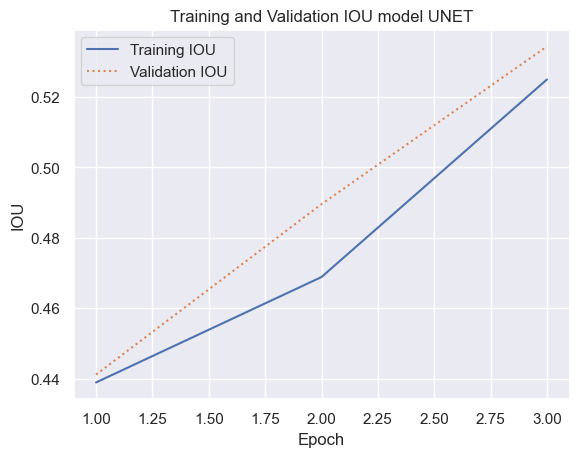

In [48]:
# Affichage des courbes pour le mean_IOU d'entraînement et de validation
sns.set()
acc = hist_unet_data_augm.history['mean_io_u']
val = hist_unet_data_augm.history['val_mean_io_u']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training IOU')
plt.plot(epochs, val, ':', label='Validation IOU')
plt.title('Training and Validation IOU model UNET')
plt.xlabel('Epoch')
plt.ylabel('IOU')
plt.legend(loc='upper left')
plt.plot()

[]

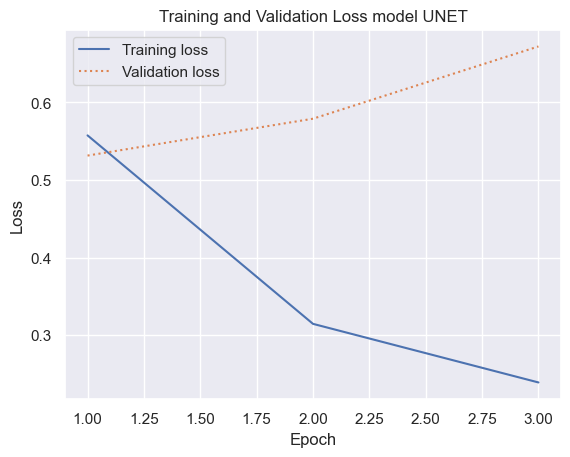

In [49]:
# Affichage des courbes pour la perte d’entraînement et pour la perte de validation 
sns.set()
acc = hist_unet_data_augm.history['loss']
val = hist_unet_data_augm.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training loss')
plt.plot(epochs, val, ':', label='Validation loss')
plt.title('Training and Validation Loss model UNET')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.plot()

In [40]:
# Définir le modèle et les données de test
scores_unet_data_augm = unet.evaluate(test_gen_data_augm)
scores_unet_data_augm

63/63 [==============================] - 38s 597ms/step - loss: 0.8796 - dice_coeff: 0.8012 - accuracy: 0.8321 - mean_iou: 0.5363


[0.8795768618583679, 0.801246702671051, 0.8321480751037598, 0.5363385677337646]

In [41]:
# Insertion du score d'évaluation pour le modèle unet avec la data augmentation
tab_compare.append(['Unet data augmentation',scores_unet_data_augm[3], hist_unet_data_augm.history['loss'],training_time,eval_time])

In [54]:
# Test modèle
start_eval = time()
val_preds_dm_unet = unet.predict(test_gen_data_augm)
eval_time = time() - start_eval

63/63 [==============================] - 46s 640ms/step


In [56]:
val_preds_dm_unet.shape

(500, 16384, 8)

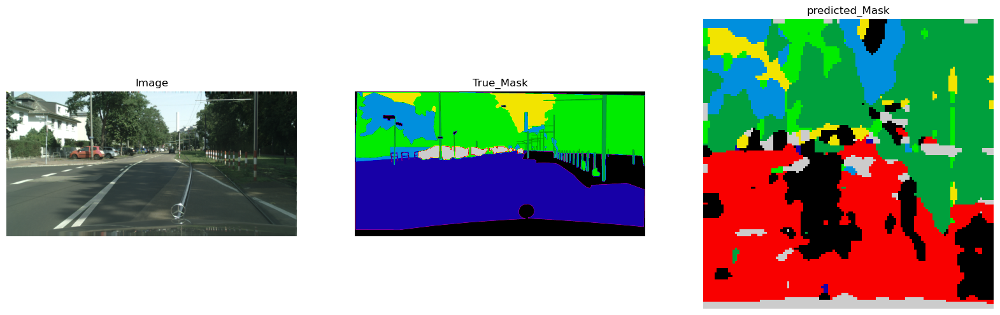

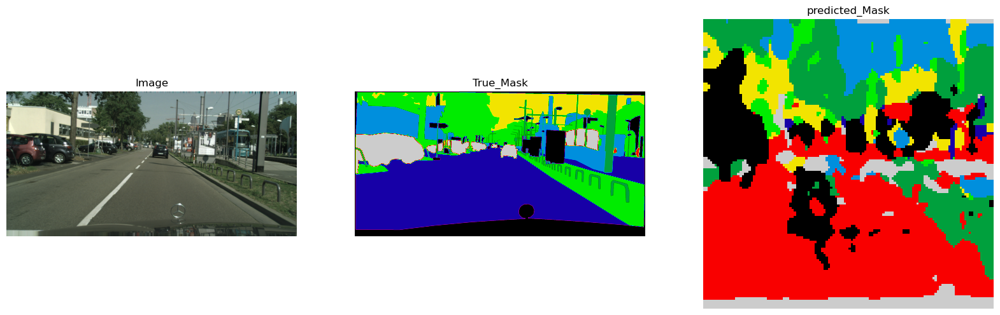

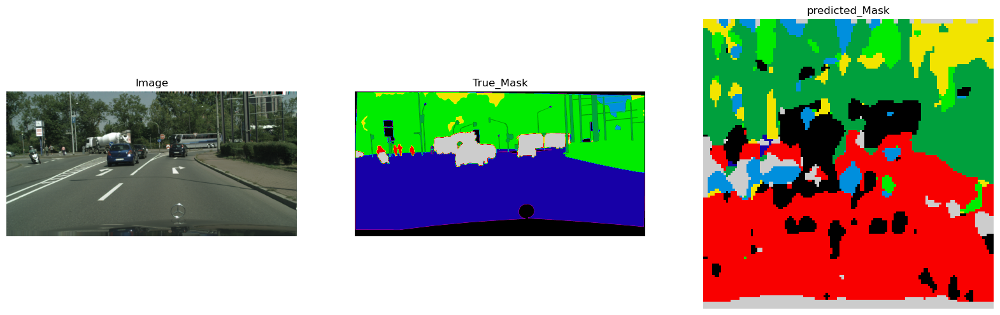

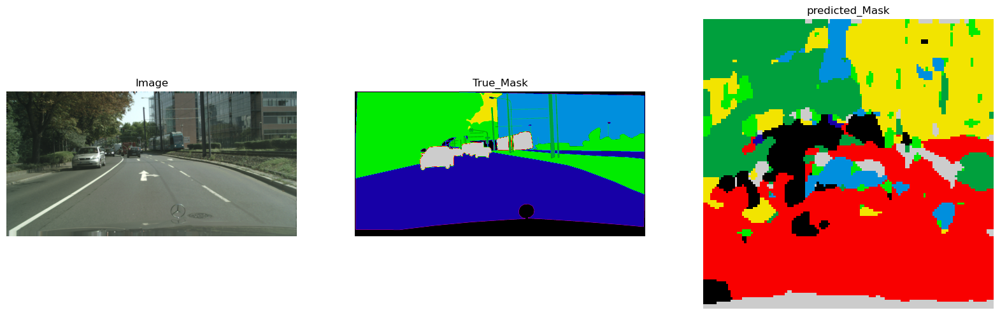

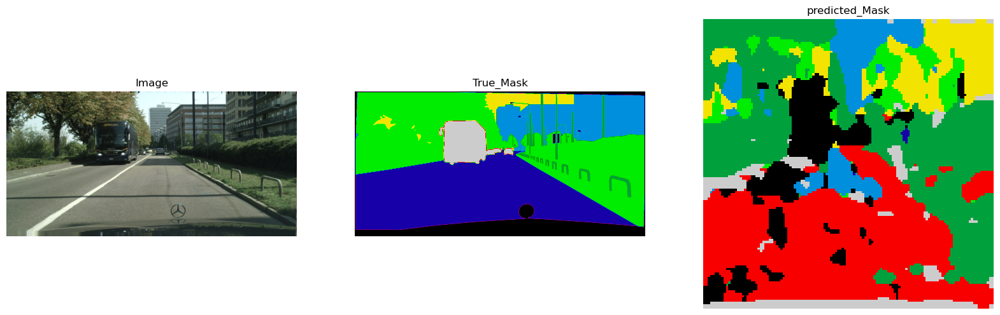

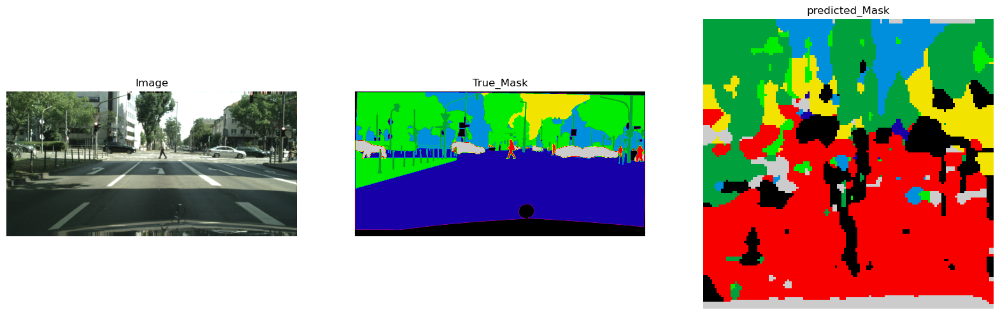

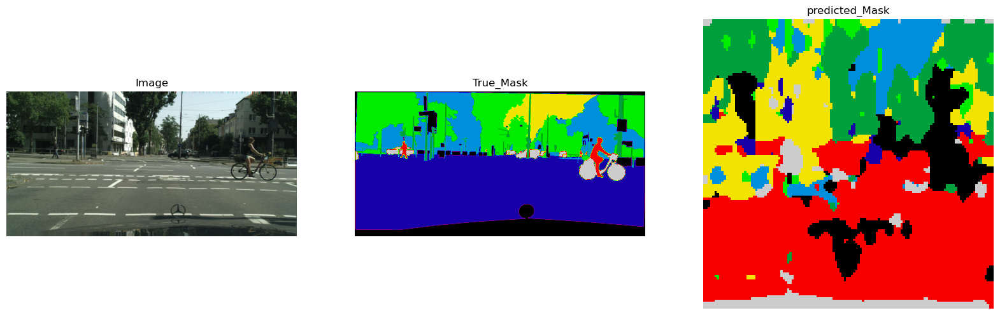

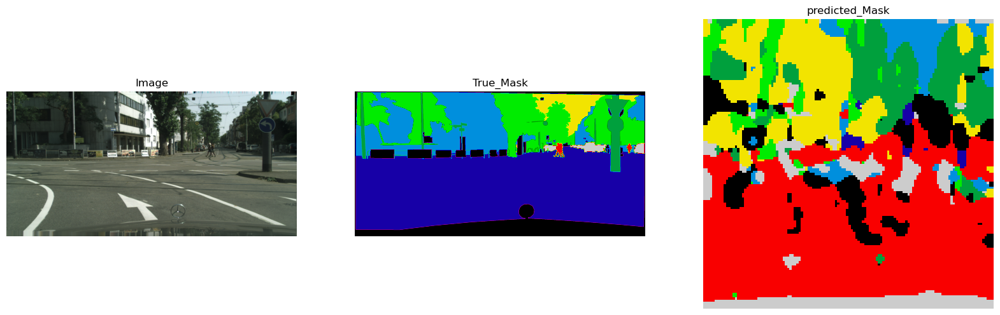

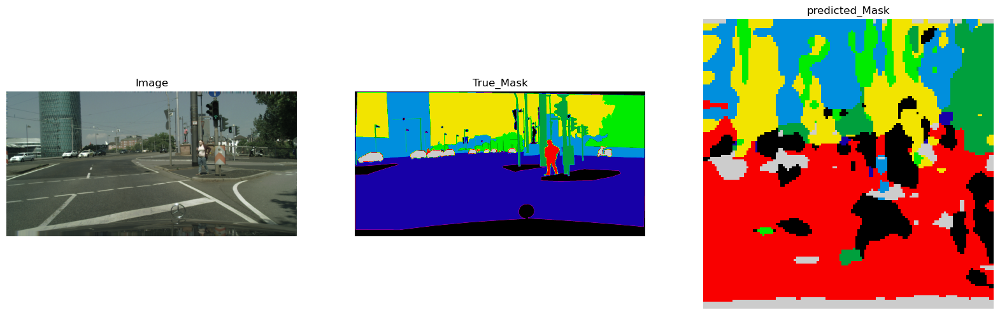

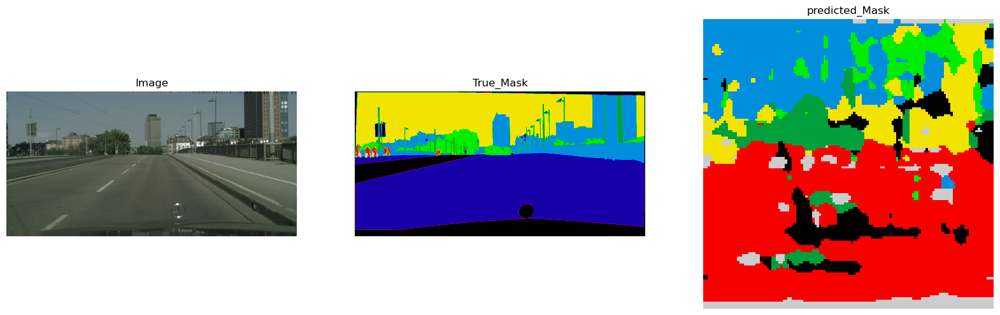

In [60]:
for i in range(10,20):
    image = img_to_array(load_img(f'{test_input_path[i]}'))/255.
    mask = img_to_array(load_img(f'{test_target_path[i]}', color_mode = "grayscale"))
    mask = np.squeeze(mask)
    pred_mask = np.argmax(val_preds_dm_unet[i], axis=-1)
    pred_mask = pred_mask.reshape((128, 128))
    pred_mask = np.expand_dims(pred_mask, axis=-1)
    pred_mask = np.squeeze(pred_mask)


    fig = plt.figure(figsize=(20, 20))
    ax = fig.add_subplot(1, 3, 1)
    ax.set_title('Image')
    ax.imshow(image)
    ax.axis('off')

    ax2 = fig.add_subplot(1, 3, 2)
    ax2.set_title('True_Mask')
    ax2.imshow(mask, cmap='nipy_spectral')
    ax2.axis('off')

    ax1 = fig.add_subplot(1, 3, 3)
    ax1.set_title('predicted_Mask')
    ax1.imshow(pred_mask, cmap='nipy_spectral_r')
    ax1.axis('off')

### Rejet du modèle Unet
- Comme on peut le voir sur les tests fait au-dessus les résultats ne sont pas clairs et ne sont pas utilisables
- Ce modèle nécessite beaucoup de ressources ce qui n'est pas recommandé si on veut l'installer dans une voiture autonome

In [42]:
# Save model Unet avec data augmentation
unet.save("unet_model")

INFO:tensorflow:Assets written to: unet_model\assets


INFO:tensorflow:Assets written to: unet_model\assets


## Test des modèles VGG16

### Test du modèle créé à partir du modèle pré-entrainé vgg16_U-Net

In [32]:
batch_size = 8
samples = 50000
steps = samples//batch_size
img_height, img_width = 256, 256
classes = 8

In [33]:
class DataGeneratorV2(Sequence):
    def __init__(self, input_path, target_path, batch_size, augmentation):
        self.input_path = input_path
        self.target_path = target_path
        self.batch_size = batch_size
        self.augmentation = augmentation
        
        # Définir les indexes
        self.indexes = np.arange(len(self.input_path))
        
        # Ajoutez la data augmentation
        if self.augmentation:
            self.seq = iaa.Sequential([
                iaa.Dropout([0.05, 0.2]),      # drop 5% or 20% of all pixels
                iaa.Sharpen((0.0, 1.0)),       # sharpen the image
                iaa.Affine(rotate=(-45, 45)),  # rotate by -45 to 45 degrees (affects segmaps)
                iaa.ElasticTransformation(alpha=50, sigma=5)  # apply water effect (affects segmaps)
            ], random_order=True)
        
    def __len__(self):
        return int(np.ceil(len(self.input_path) / float(self.batch_size)))

    def __getitem__(self, idx):
        indexes = self.indexes[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_x, batch_y = [], []
        drawn = 0
        for i in indexes:
            _image = img_to_array(load_img(f'{self.input_path[i]}', target_size=(img_height, img_width)))/255.   
            mask = img_to_array(load_img(f'{self.target_path[i]}', color_mode = "grayscale", target_size=(img_height, img_width)))
            
            if self.augmentation:
                mask = mask.astype(np.uint8)
                # Appliquer la data augmentation à l'image et au masque
                augmented = self.seq(image=_image, segmentation_maps=SegmentationMapsOnImage(mask, shape=_image.shape))
                _image_aug = augmented[0]  # Premier élément du tuple est l'image augmentée
                mask_aug = augmented[1].get_arr().squeeze()  # Deuxième élément du tuple est le masque augmenté
            
            mask = np.squeeze(mask)
            mask_f = np.zeros((mask.shape[0], mask.shape[1], 8))
            for label in range(-1, 34):
                if label in cats['void']:
                    mask_f[:,:,0] = np.logical_or(mask_f[:,:,0], (mask==label))
                elif label in cats['flat']:
                    mask_f[:,:,1] = np.logical_or(mask_f[:,:,1], (mask==label))
                elif label in cats['construction']:
                    mask_f[:,:,2] = np.logical_or(mask_f[:,:,2], (mask==label))
                elif label in cats['object']:
                    mask_f[:,:,3] = np.logical_or(mask_f[:,:,3], (mask==label))
                elif label in cats['nature']:
                    mask_f[:,:,4] = np.logical_or(mask_f[:,:,4], (mask==label))
                elif label in cats['sky']:
                    mask_f[:,:,5] = np.logical_or(mask_f[:,:,5], (mask==label))
                elif label in cats['human']:
                    mask_f[:,:,6] = np.logical_or(mask_f[:,:,6], (mask==label))
                elif label in cats['vehicle']:
                    mask_f[:,:,7] = np.logical_or(mask_f[:,:,7], (mask==label))
            
            mask_f = np.expand_dims(mask_f, axis=0)
            batch_y.append(mask_f)
            batch_x.append(_image)
            drawn += 1
        
        # Empilez les tableaux dans le batch
        batch_x = np.stack(batch_x, axis=0)
        batch_y = np.concatenate(batch_y, axis=0)
        
        return batch_x, batch_y

In [34]:
tb = TensorBoard(log_dir='logs', write_graph=True)
mc = ModelCheckpoint(mode='max', filepath='models-dr/pdilated.h5', monitor='acc', save_best_only='True', save_weights_only='True', verbose=1)
es = EarlyStopping(mode='max', monitor='acc', patience=6, verbose=1)
#vis = visualize()
callbacks = [tb, mc, es]
# datagenerator des jeux de données avec data augmentation
train_gen_vgg16_dm = DataGeneratorV2(train_input_path, train_mask_path, batch_size, True)
val_gen_vgg16_dm = DataGeneratorV2(val_input_path, val_mask_path, batch_size, True)
test_gen_vgg16_dm = DataGeneratorV2(test_input_path, test_mask_path, batch_size, True)

# datagenerator des jeux de données sans data augmentation
train_gen_vgg16 = DataGeneratorV2(train_input_path, train_mask_path, batch_size, False)
val_gen_vgg16 = DataGeneratorV2(val_input_path, val_mask_path, batch_size, False)
test_gen_vgg16 = DataGeneratorV2(test_input_path, test_mask_path, batch_size, False)

### Test du modèle VGG16 U-net avec data augmentation

In [35]:
input_shape = (256, 256, 3)
build_vgg16_dm = build_vgg16_unet(input_shape)
build_vgg16_dm.compile(optimizer='adam', loss='categorical_crossentropy', metrics=[dice_coeff, 'accuracy', tf.keras.metrics.MeanIoU(num_classes=8, name='mean_iou')])

In [36]:
start_train = time()
hist_build_vgg16_dm = build_vgg16_dm.fit(train_gen_vgg16_dm, validation_data=val_gen_vgg16_dm, steps_per_epoch=steps, epochs=3, callbacks=callbacks, workers=8)
training_time = time() - start_train

Epoch 1/3
6250/6250 [==============================] - 2705s 431ms/step - loss: 0.3315 - dice_coeff: 0.8401 - accuracy: 0.8949 - mean_iou: 0.4378 - val_loss: 0.3124 - val_dice_coeff: 0.8719 - val_accuracy: 0.9079 - val_mean_iou: 0.4485
Epoch 2/3
6250/6250 [==============================] - 2338s 374ms/step - loss: 0.1697 - dice_coeff: 0.9152 - accuracy: 0.9424 - mean_iou: 0.4445 - val_loss: 0.3364 - val_dice_coeff: 0.9010 - val_accuracy: 0.9167 - val_mean_iou: 0.4516
Epoch 3/3
6250/6250 [==============================] - 2783s 445ms/step - loss: 0.1036 - dice_coeff: 0.9469 - accuracy: 0.9636 - mean_iou: 0.4528 - val_loss: 0.3883 - val_dice_coeff: 0.9021 - val_accuracy: 0.9141 - val_mean_iou: 0.4569


In [37]:
hist_build_vgg16_dm.history

{'loss': [0.3314744532108307, 0.16966237127780914, 0.10360860079526901],
 'dice_coeff': [0.8401432037353516, 0.9152319431304932, 0.9468731880187988],
 'accuracy': [0.8949368000030518, 0.9423790574073792, 0.9636427760124207],
 'mean_iou': [0.43781766295433044, 0.4445027709007263, 0.45278385281562805],
 'val_loss': [0.31243041157722473, 0.33638796210289, 0.3882581293582916],
 'val_dice_coeff': [0.8718770146369934,
  0.9009503126144409,
  0.9021491408348083],
 'val_accuracy': [0.9078577160835266, 0.9167488813400269, 0.9140908122062683],
 'val_mean_iou': [0.44846850633621216,
  0.4516306221485138,
  0.45687973499298096]}

[]

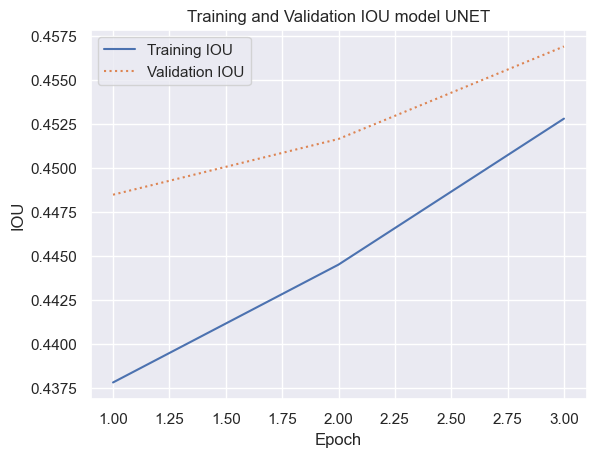

In [38]:
# Affichage des courbes pour le mean_IOU d'entraînement et de validation
sns.set()
acc = hist_build_vgg16_dm.history['mean_iou']
val = hist_build_vgg16_dm.history['val_mean_iou']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training IOU')
plt.plot(epochs, val, ':', label='Validation IOU')
plt.title('Training and Validation IOU model UNET')
plt.xlabel('Epoch')
plt.ylabel('IOU')
plt.legend(loc='upper left')
plt.plot()

[]

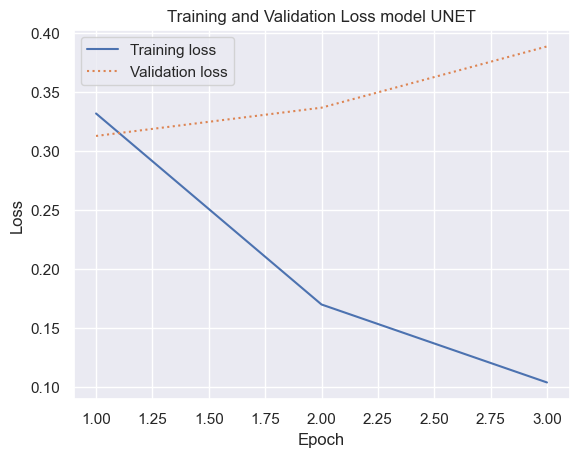

In [39]:
# Affichage des courbes pour la perte d’entraînement et pour la perte de validation 
sns.set()
acc = hist_build_vgg16_dm.history['loss']
val = hist_build_vgg16_dm.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training loss')
plt.plot(epochs, val, ':', label='Validation loss')
plt.title('Training and Validation Loss model UNET')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.plot()

In [40]:
scores_vgg16_unet_dm = build_vgg16_dm.evaluate(test_gen_vgg16_dm)
scores_vgg16_unet_dm

63/63 [==============================] - 49s 774ms/step - loss: 0.4480 - dice_coeff: 0.8883 - accuracy: 0.9009 - mean_iou: 0.4531


[0.44795024394989014,
 0.888307511806488,
 0.9009078145027161,
 0.4531201422214508]

In [41]:
# Test modèle
start_eval = time()
val_preds_dm = build_vgg16_dm.predict(test_gen_vgg16_dm)
eval_time = time() - start_eval

63/63 [==============================] - 43s 670ms/step


In [42]:
# Insertion du score d'évaluation pour le modèle VGG16
tab_compare.append(['VGG16 Unet Data augmentation',scores_vgg16_unet_dm[3], hist_build_vgg16_dm.history['loss'],training_time,eval_time])

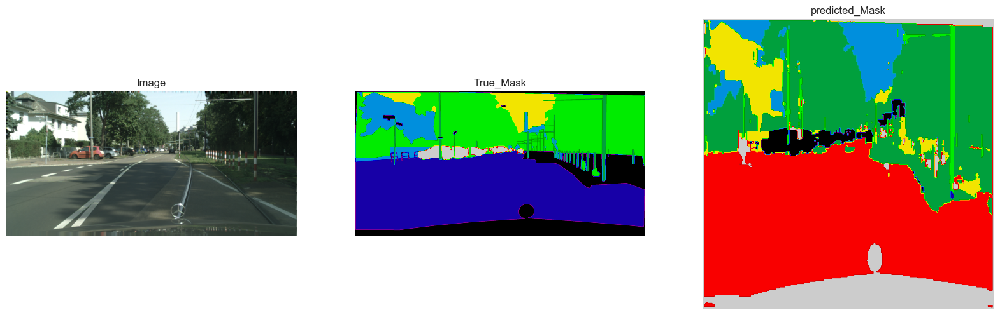

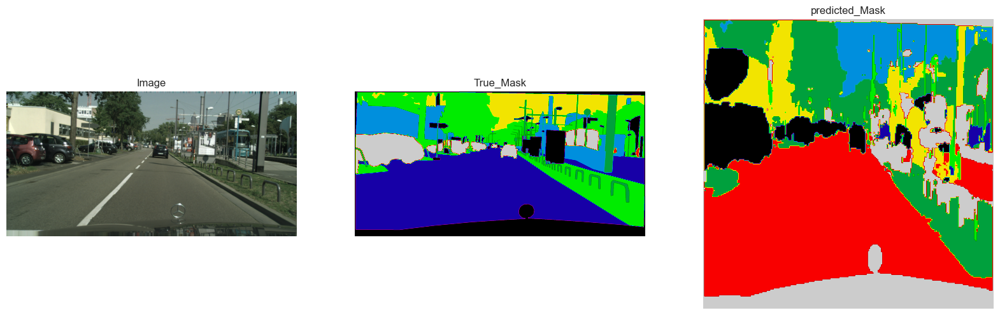

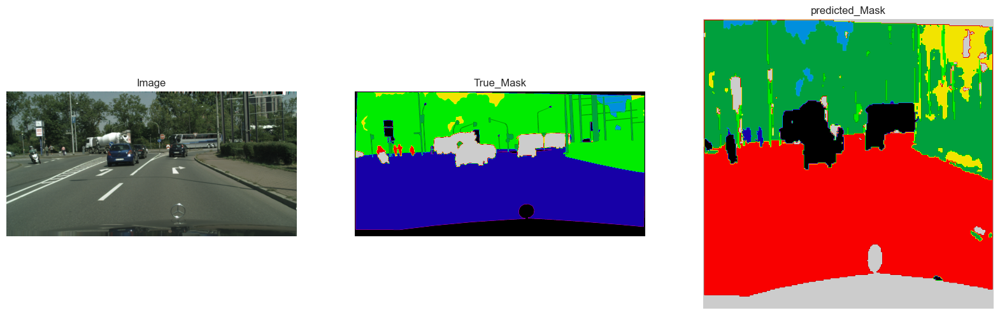

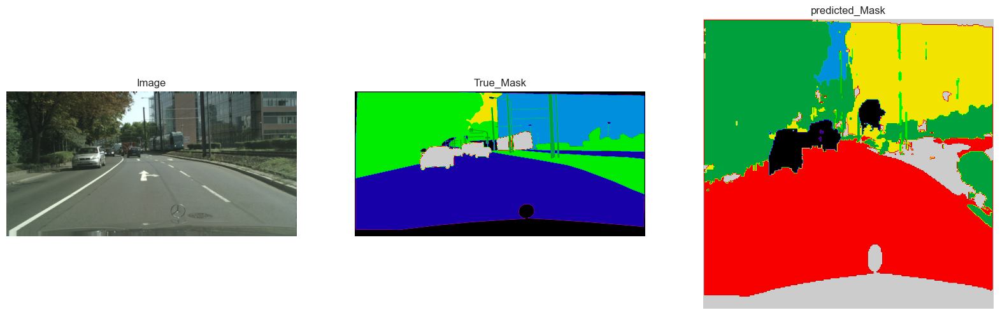

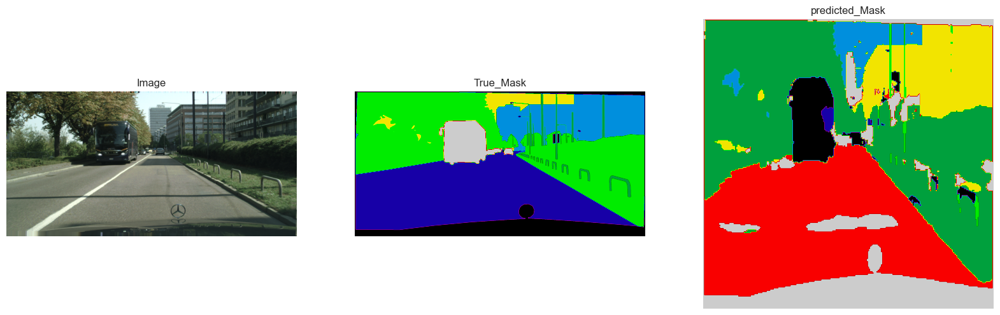

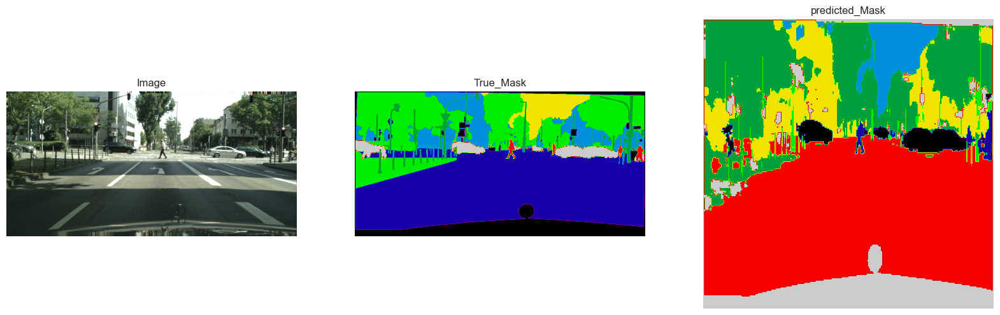

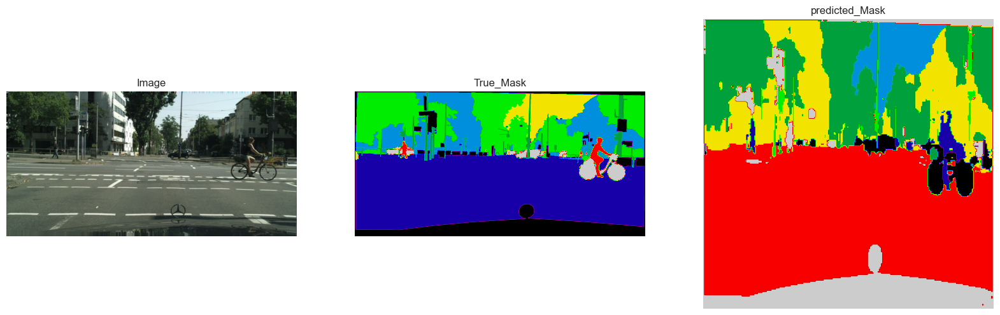

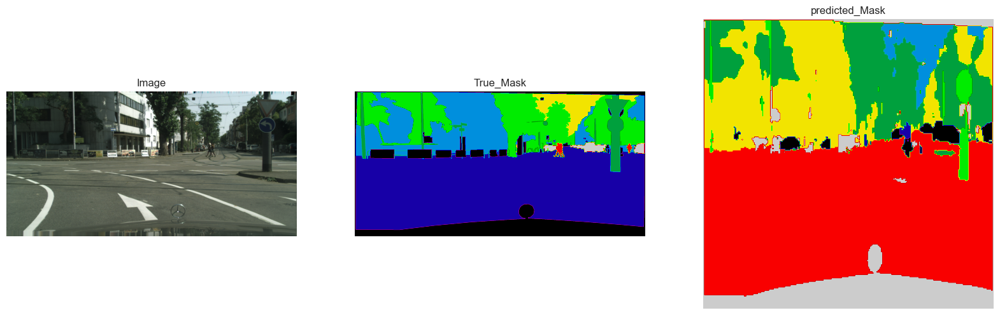

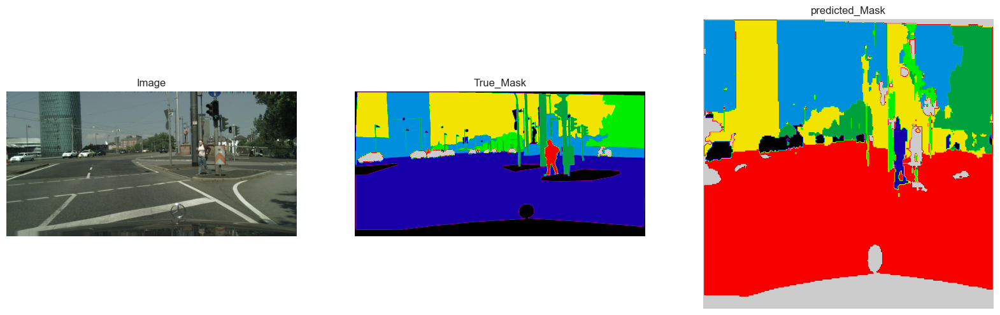

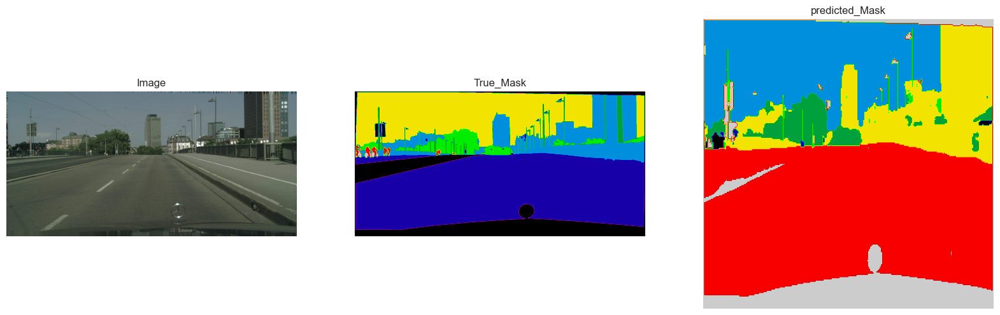

In [43]:
# Display results for validation image #10

for i in range(10,20):
    image = img_to_array(load_img(f'{test_input_path[i]}'))/255.
    mask = img_to_array(load_img(f'{test_target_path[i]}', color_mode = "grayscale"))
    mask = np.squeeze(mask)
    pred_mask = np.argmax(val_preds_dm[i], axis=-1)
    pred_mask = np.expand_dims(pred_mask, axis=-1)
    pred_mask = np.squeeze(pred_mask)


    fig = plt.figure(figsize=(20, 20))
    ax = fig.add_subplot(1, 3, 1)
    ax.set_title('Image')
    ax.imshow(image)
    ax.axis('off')

    ax2 = fig.add_subplot(1, 3, 2)
    ax2.set_title('True_Mask')
    ax2.imshow(mask, cmap='nipy_spectral')
    ax2.axis('off')

    ax1 = fig.add_subplot(1, 3, 3)
    ax1.set_title('predicted_Mask')
    ax1.imshow(pred_mask, cmap='nipy_spectral_r')
    ax1.axis('off')

In [44]:
build_vgg16_dm.save("VGG16_Unet_DM")

INFO:tensorflow:Assets written to: VGG16_Unet_DM\assets


INFO:tensorflow:Assets written to: VGG16_Unet_DM\assets


### Test du modèle VVG16 U-net sans data augmentation

In [45]:
input_shape = (256, 256, 3)
build_vgg16 = build_vgg16_unet(input_shape)
build_vgg16.compile(optimizer='adam', loss='categorical_crossentropy', metrics=[dice_coeff, 'accuracy', tf.keras.metrics.MeanIoU(num_classes=8, name='mean_iou')])

In [46]:
start_train = time()
hist_build_vgg16 = build_vgg16.fit(train_gen_vgg16, validation_data=val_gen_vgg16, steps_per_epoch=steps, epochs=3, callbacks=callbacks, workers=8)
training_time = time() - start_train

Epoch 1/3
6250/6250 [==============================] - ETA: 0s - loss: 0.3303 - dice_coeff: 0.8397 - accuracy: 0.8954 - mean_iou: 0.4377WARNING:tensorflow:Can save best model only with acc available, skipping.


6250/6250 [==============================] - 2070s 331ms/step - loss: 0.3303 - dice_coeff: 0.8397 - accuracy: 0.8954 - mean_iou: 0.4377 - val_loss: 0.2882 - val_dice_coeff: 0.8756 - val_accuracy: 0.9111 - val_mean_iou: 0.4375
Epoch 2/3
6250/6250 [==============================] - ETA: 0s - loss: 0.1631 - dice_coeff: 0.9185 - accuracy: 0.9445 - mean_iou: 0.4408WARNING:tensorflow:Can save best model only with acc available, skipping.


6250/6250 [==============================] - 2460s 393ms/step - loss: 0.1631 - dice_coeff: 0.9185 - accuracy: 0.9445 - mean_iou: 0.4408 - val_loss: 0.3534 - val_dice_coeff: 0.8977 - val_accuracy: 0.9148 - val_mean_iou: 0.4438
Epoch 3/3
6250/6250 [==============================] - ETA: 0s - loss: 0.1056 - dice_coeff: 0.9460 - accuracy: 0.9630 - mean_iou: 0.4504WARNING:tensorflow:Can save best model only with acc available, skipping.


6250/6250 [==============================] - 2512s 402ms/step - loss: 0.1056 - dice_coeff: 0.9460 - accuracy: 0.9630 - mean_iou: 0.4504 - val_loss: 0.3485 - val_dice_coeff: 0.8993 - val_accuracy: 0.9138 - val_mean_iou: 0.4423


In [47]:
hist_build_vgg16.history

{'loss': [0.3303050994873047, 0.16311286389827728, 0.1056101992726326],
 'dice_coeff': [0.8396545052528381, 0.9185352921485901, 0.9460306763648987],
 'accuracy': [0.8954287171363831, 0.9445092678070068, 0.9629688858985901],
 'mean_iou': [0.43765202164649963, 0.44076675176620483, 0.45041993260383606],
 'val_loss': [0.28822240233421326, 0.3533504605293274, 0.34851041436195374],
 'val_dice_coeff': [0.8755746483802795,
  0.8976525068283081,
  0.8993036150932312],
 'val_accuracy': [0.9111039638519287, 0.9147519469261169, 0.913761556148529],
 'val_mean_iou': [0.4375215470790863, 0.44383111596107483, 0.4423409700393677]}

[]

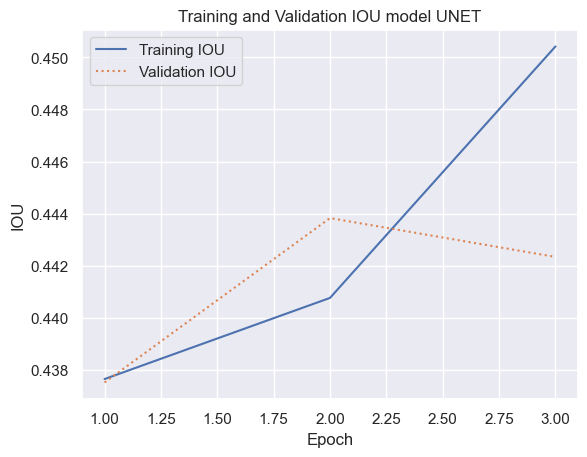

In [48]:
# Affichage des courbes pour le mean_IOU d'entraînement et de validation
sns.set()
acc = hist_build_vgg16.history['mean_iou']
val = hist_build_vgg16.history['val_mean_iou']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training IOU')
plt.plot(epochs, val, ':', label='Validation IOU')
plt.title('Training and Validation IOU model UNET')
plt.xlabel('Epoch')
plt.ylabel('IOU')
plt.legend(loc='upper left')
plt.plot()

[]

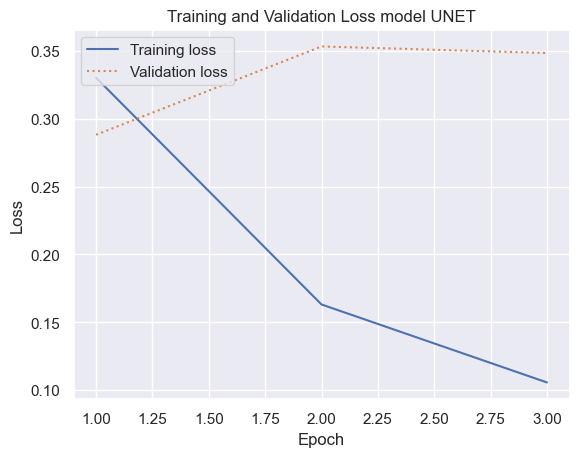

In [49]:
# Affichage des courbes pour la perte d’entraînement et pour la perte de validation 
sns.set()
acc = hist_build_vgg16.history['loss']
val = hist_build_vgg16.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training loss')
plt.plot(epochs, val, ':', label='Validation loss')
plt.title('Training and Validation Loss model UNET')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.plot()

In [50]:
scores_vgg16_unet = build_vgg16.evaluate(test_gen_vgg16)
scores_vgg16_unet

63/63 [==============================] - 39s 609ms/step - loss: 0.4096 - dice_coeff: 0.8857 - accuracy: 0.9006 - mean_iou: 0.4419


[0.4096389412879944,
 0.8856898546218872,
 0.9006422162055969,
 0.4418957829475403]

In [51]:
# Test modèle
start_eval = time()
val_preds = build_vgg16.predict(test_gen_vgg16)
eval_time = time() - start_eval

63/63 [==============================] - 38s 591ms/step


In [52]:
# Insertion du score d'évaluation pour le modèle VGG16
tab_compare.append(['VGG16 Unet',scores_vgg16_unet[3], hist_build_vgg16.history['loss'],training_time,eval_time])

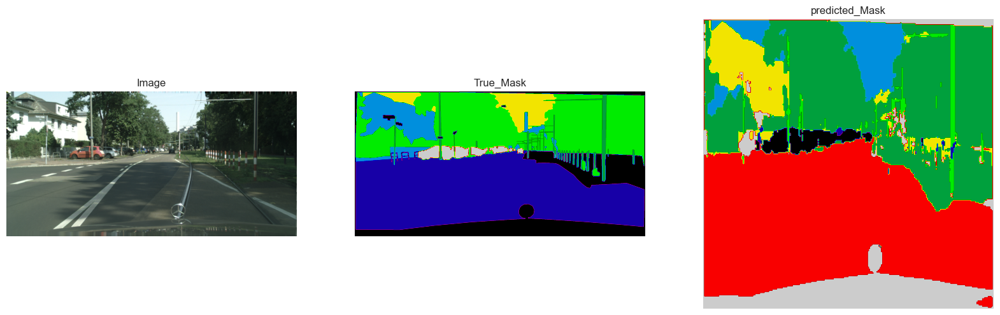

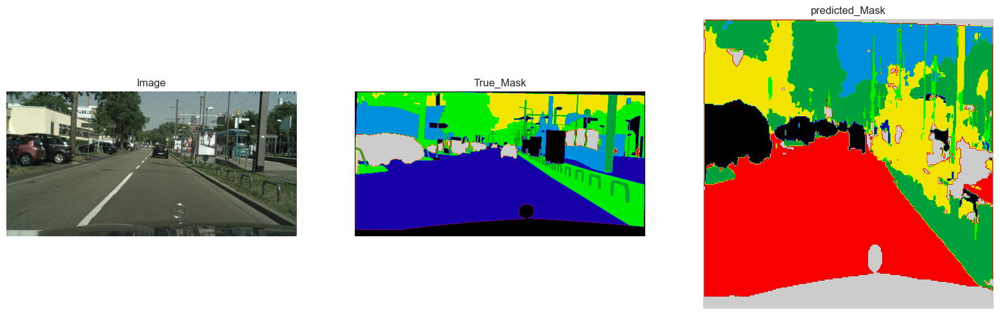

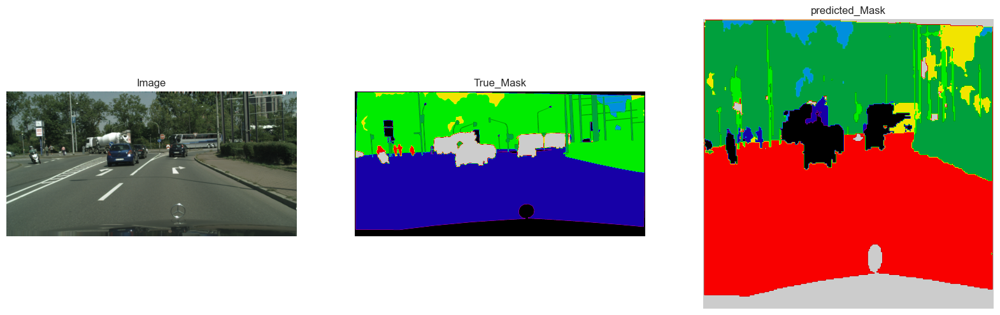

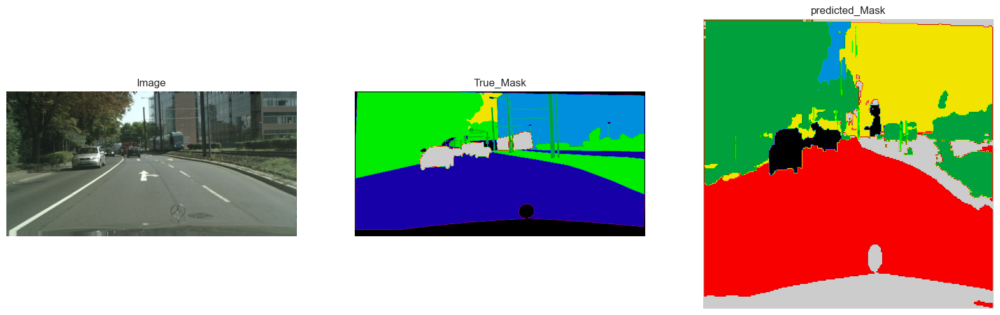

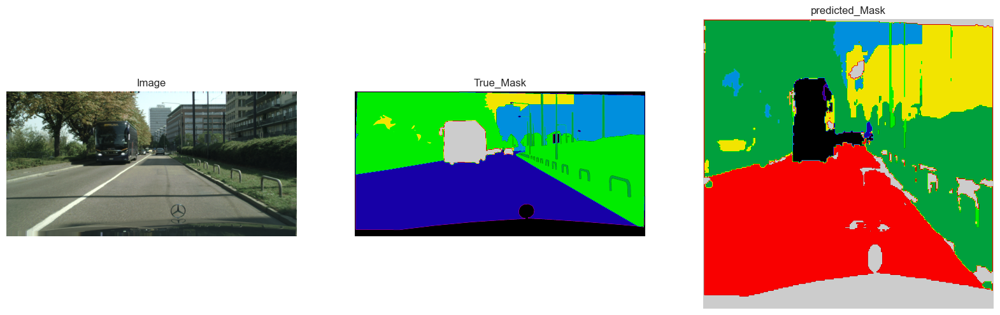

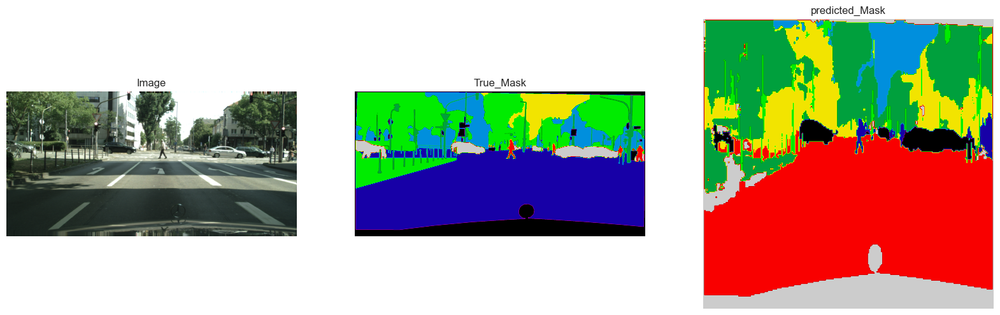

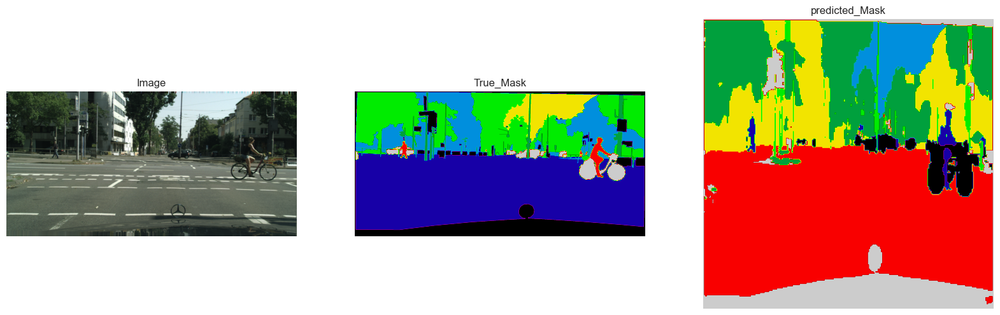

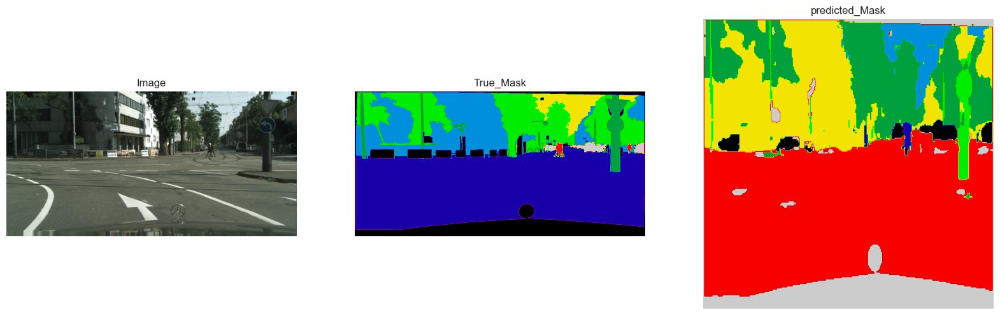

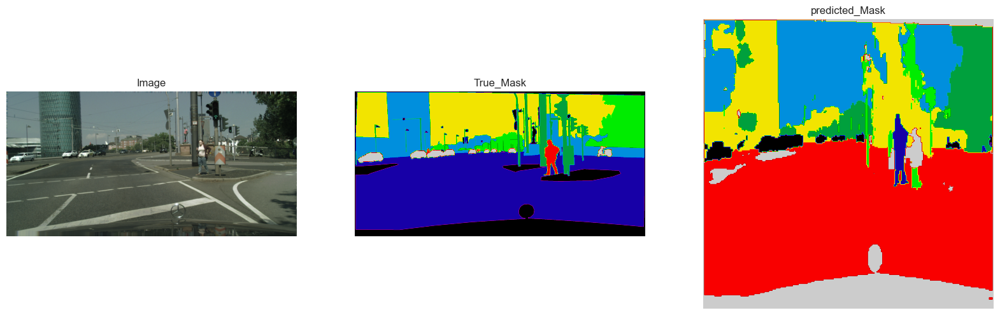

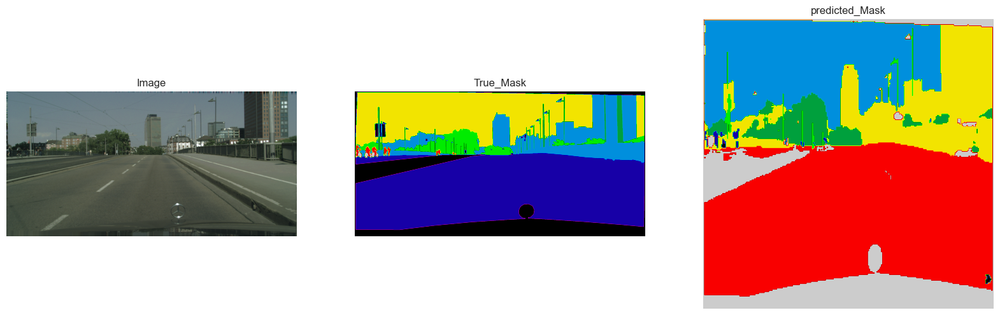

In [53]:
# Display results for validation image #10

for i in range(10,20):
    image = img_to_array(load_img(f'{test_input_path[i]}'))/255.
    mask = img_to_array(load_img(f'{test_target_path[i]}', color_mode = "grayscale"))
    mask = np.squeeze(mask)
    pred_mask = np.argmax(val_preds[i], axis=-1)
    pred_mask = np.expand_dims(pred_mask, axis=-1)
    pred_mask = np.squeeze(pred_mask)


    fig = plt.figure(figsize=(20, 20))
    ax = fig.add_subplot(1, 3, 1)
    ax.set_title('Image')
    ax.imshow(image)
    ax.axis('off')

    ax2 = fig.add_subplot(1, 3, 2)
    ax2.set_title('True_Mask')
    ax2.imshow(mask, cmap='nipy_spectral')
    ax2.axis('off')

    ax1 = fig.add_subplot(1, 3, 3)
    ax1.set_title('predicted_Mask')
    ax1.imshow(pred_mask, cmap='nipy_spectral_r')
    ax1.axis('off')

In [54]:
build_vgg16.save("VGG16_Unet")

INFO:tensorflow:Assets written to: VGG16_Unet\assets


INFO:tensorflow:Assets written to: VGG16_Unet\assets


### Test du modèle VGG16_U-Net du projet image-segmentation-keras

In [55]:
img_height, img_width = 256, 512

In [56]:
model_name= 'vgg_unet'
vgg_unet = vgg_unet(n_classes=8 , input_height=256, input_width=512)

In [57]:
# Set checkpoints
callbacks = [ModelCheckpoint(checkpoint_path +f'/{model_name}.h5', 
                             save_best_only=True)]
start_train = time()

hist_vgg_unet = vgg_unet.train(
    train_images =  "datas/images/train_clean",
    train_annotations = "datas/masks/train_clean_normalized",
    input_height=img_height,
    input_width=img_width,
    n_classes=8,
    val_images="datas/images/val_clean",
    val_annotations="datas/masks/val_clean_normalized",
    validate=True,
    do_augment=True, # enable augmentation
    checkpoints_path = "tmp/vgg_unet_1" , epochs=5
)

training_time = time() - start_train

# Save the model
vgg_unet.save('vgg_unet.h5')

Verifying training dataset


100%|██████████████████████████████████████████████████████████████████████████████| 2380/2380 [02:16<00:00, 17.42it/s]


Dataset verified! 
Verifying validation dataset


100%|████████████████████████████████████████████████████████████████████████████████| 595/595 [00:33<00:00, 17.78it/s]


Dataset verified! 
Epoch 1/5
512/512 [==============================] - ETA: 0s - loss: 1.1590 - accuracy: 0.6123 - mean_io_u: 0.4375
Epoch 1: saving model to tmp\vgg_unet_1.00001
512/512 [==============================] - 706s 1s/step - loss: 1.1590 - accuracy: 0.6123 - mean_io_u: 0.4375 - val_loss: 1.0633 - val_accuracy: 0.6208 - val_mean_io_u: 0.4375
Epoch 2/5
512/512 [==============================] - ETA: 0s - loss: 0.9805 - accuracy: 0.6699 - mean_io_u: 0.4375
Epoch 2: saving model to tmp\vgg_unet_1.00002
512/512 [==============================] - 683s 1s/step - loss: 0.9805 - accuracy: 0.6699 - mean_io_u: 0.4375 - val_loss: 0.7807 - val_accuracy: 0.7379 - val_mean_io_u: 0.4375
Epoch 3/5
512/512 [==============================] - ETA: 0s - loss: 0.9085 - accuracy: 0.6975 - mean_io_u: 0.4375
Epoch 3: saving model to tmp\vgg_unet_1.00003
512/512 [==============================] - 676s 1s/step - loss: 0.9085 - accuracy: 0.6975 - mean_io_u: 0.4375 - val_loss: 0.8342 - val_accuracy: 0

In [58]:
hist_vgg_unet.history

{'loss': [1.1589802503585815,
  0.9805290699005127,
  0.9085077047348022,
  0.8545544147491455,
  0.8102412819862366],
 'accuracy': [0.6122987866401672,
  0.6699475646018982,
  0.6975306272506714,
  0.7149292230606079,
  0.7319719195365906],
 'mean_io_u': [0.4375000596046448,
  0.4375000298023224,
  0.4374999403953552,
  0.43750011920928955,
  0.4375],
 'val_loss': [1.0632996559143066,
  0.7807272672653198,
  0.8341845870018005,
  0.7622088193893433,
  0.6963064074516296],
 'val_accuracy': [0.6208229660987854,
  0.7379173040390015,
  0.7174975872039795,
  0.7496957778930664,
  0.7778647541999817],
 'val_mean_io_u': [0.4375, 0.4375, 0.4375, 0.4375, 0.4375]}

[]

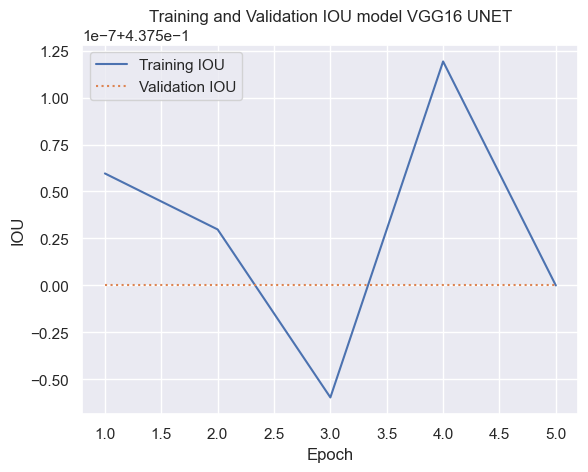

In [59]:
# Affichage des courbes pour le mean_IOU d'entraînement et de validation
sns.set()
acc = hist_vgg_unet.history['mean_io_u']
val = hist_vgg_unet.history['val_mean_io_u']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training IOU')
plt.plot(epochs, val, ':', label='Validation IOU')
plt.title('Training and Validation IOU model VGG16 UNET')
plt.xlabel('Epoch')
plt.ylabel('IOU')
plt.legend(loc='upper left')
plt.plot()

[]

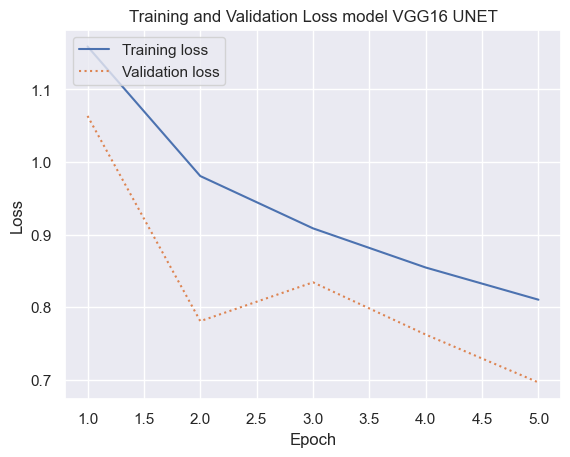

In [60]:
# Affichage des courbes pour la perte d’entraînement et pour la perte de validation 
sns.set()
acc = hist_vgg_unet.history['loss']
val = hist_vgg_unet.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training loss')
plt.plot(epochs, val, ':', label='Validation loss')
plt.title('Training and Validation Loss model VGG16 UNET')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.plot()

In [61]:
start_eval = time()
score_vgg_unet = vgg_unet.evaluate_segmentation(inp_images_dir=test_input_dir , annotations_dir=test_target_dir)
eval_time = time() - start_eval

score_vgg_unet

0it [00:00, ?it/s]

1/1 [==============================] - 2s 2s/step


1it [00:02,  2.15s/it]

1/1 [==============================] - 0s 20ms/step


2it [00:02,  1.03it/s]

1/1 [==============================] - 0s 21ms/step


3it [00:02,  1.67it/s]

1/1 [==============================] - 0s 20ms/step


4it [00:02,  2.38it/s]

1/1 [==============================] - 0s 19ms/step


5it [00:02,  3.13it/s]

1/1 [==============================] - 0s 19ms/step


6it [00:02,  3.85it/s]

1/1 [==============================] - 0s 19ms/step


7it [00:03,  4.44it/s]

1/1 [==============================] - 0s 19ms/step


8it [00:03,  5.06it/s]

1/1 [==============================] - 0s 17ms/step


9it [00:03,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


10it [00:03,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


11it [00:03,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


12it [00:03,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


13it [00:03,  6.85it/s]

1/1 [==============================] - 0s 19ms/step


14it [00:04,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


15it [00:04,  6.75it/s]

1/1 [==============================] - 0s 20ms/step


16it [00:04,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


17it [00:04,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


18it [00:04,  6.78it/s]

1/1 [==============================] - 0s 20ms/step


19it [00:04,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


20it [00:04,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


21it [00:05,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


22it [00:05,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


23it [00:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


24it [00:05,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


25it [00:05,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


26it [00:05,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


27it [00:06,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


28it [00:06,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


29it [00:06,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


30it [00:06,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


31it [00:06,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


32it [00:06,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


33it [00:07,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


34it [00:07,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


35it [00:07,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


36it [00:07,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


37it [00:07,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


38it [00:07,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


39it [00:08,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


40it [00:08,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


41it [00:08,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


42it [00:08,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


43it [00:08,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


44it [00:08,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


45it [00:08,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


46it [00:09,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


47it [00:09,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


48it [00:09,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


49it [00:09,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


50it [00:09,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


51it [00:10,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


52it [00:10,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


53it [00:10,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


54it [00:10,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


55it [00:10,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


56it [00:10,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


57it [00:10,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


58it [00:11,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


59it [00:11,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


60it [00:11,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


61it [00:11,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


62it [00:11,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


63it [00:11,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


64it [00:12,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


65it [00:12,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


66it [00:12,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


67it [00:12,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


68it [00:12,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


69it [00:12,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


70it [00:13,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


71it [00:13,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


72it [00:13,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


73it [00:13,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


74it [00:13,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


75it [00:13,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


76it [00:13,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


77it [00:14,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


78it [00:14,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


79it [00:14,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


80it [00:14,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


81it [00:14,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


82it [00:14,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


83it [00:15,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


84it [00:15,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


85it [00:16,  2.66it/s]

1/1 [==============================] - 0s 17ms/step


86it [00:16,  3.08it/s]

1/1 [==============================] - 0s 18ms/step


87it [00:16,  3.44it/s]

1/1 [==============================] - 0s 18ms/step


88it [00:16,  3.80it/s]

1/1 [==============================] - 0s 18ms/step


89it [00:16,  4.10it/s]

1/1 [==============================] - 0s 18ms/step


90it [00:17,  4.34it/s]

1/1 [==============================] - 0s 18ms/step


91it [00:17,  4.52it/s]

1/1 [==============================] - 0s 18ms/step


92it [00:17,  5.06it/s]

1/1 [==============================] - 0s 20ms/step


93it [00:17,  5.45it/s]

1/1 [==============================] - 0s 17ms/step


94it [00:17,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


95it [00:17,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


96it [00:18,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


97it [00:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


98it [00:18,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


99it [00:18,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


100it [00:18,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


101it [00:18,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


102it [00:18,  6.75it/s]

1/1 [==============================] - 0s 20ms/step


103it [00:19,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


104it [00:19,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


105it [00:19,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


106it [00:19,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


107it [00:19,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


108it [00:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


109it [00:20,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


110it [00:20,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


111it [00:20,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


112it [00:20,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


113it [00:20,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


114it [00:20,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


115it [00:21,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


116it [00:21,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


117it [00:21,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


118it [00:21,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


119it [00:21,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


120it [00:21,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


121it [00:22,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


122it [00:22,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


123it [00:22,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


124it [00:22,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


125it [00:22,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


126it [00:22,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


127it [00:23,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


128it [00:23,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


129it [00:23,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


130it [00:23,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


131it [00:23,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


132it [00:23,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


133it [00:23,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


134it [00:24,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


135it [00:24,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


136it [00:24,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


137it [00:24,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


138it [00:24,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


139it [00:24,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


140it [00:25,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


141it [00:25,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


142it [00:25,  5.90it/s]

1/1 [==============================] - 0s 17ms/step


143it [00:25,  5.92it/s]

1/1 [==============================] - 0s 17ms/step


144it [00:25,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


145it [00:25,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


146it [00:26,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


147it [00:26,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


148it [00:26,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


149it [00:26,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


150it [00:26,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


151it [00:26,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


152it [00:27,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


153it [00:27,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


154it [00:27,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


155it [00:27,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


156it [00:27,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


157it [00:27,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


158it [00:28,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


159it [00:28,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


160it [00:28,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


161it [00:28,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


162it [00:28,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


163it [00:28,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


164it [00:29,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


165it [00:29,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


166it [00:29,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


167it [00:29,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


168it [00:29,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


169it [00:29,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


170it [00:29,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


171it [00:30,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


172it [00:30,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


173it [00:30,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


174it [00:30,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


175it [00:30,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


176it [00:30,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


177it [00:31,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


178it [00:31,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


179it [00:31,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


180it [00:31,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


181it [00:31,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


182it [00:31,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


183it [00:31,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


184it [00:32,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


185it [00:32,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


186it [00:32,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


187it [00:32,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


188it [00:32,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


189it [00:32,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


190it [00:33,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


191it [00:33,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


192it [00:33,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


193it [00:33,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


194it [00:33,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


195it [00:33,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


196it [00:34,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


197it [00:34,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


198it [00:34,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


199it [00:34,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


200it [00:34,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


201it [00:34,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


202it [00:35,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


203it [00:35,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


204it [00:35,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


205it [00:35,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


206it [00:35,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


207it [00:35,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


208it [00:35,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


209it [00:36,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


210it [00:36,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


211it [00:36,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


212it [00:36,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


213it [00:36,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


214it [00:36,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


215it [00:37,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


216it [00:37,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


217it [00:37,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


218it [00:37,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


219it [00:37,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


220it [00:37,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


221it [00:37,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


222it [00:38,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


223it [00:38,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


224it [00:38,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


225it [00:38,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


226it [00:38,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


227it [00:38,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


228it [00:39,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


229it [00:39,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


230it [00:39,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


231it [00:39,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


232it [00:39,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


233it [00:39,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


234it [00:40,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


235it [00:40,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


236it [00:40,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


237it [00:40,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


238it [00:40,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


239it [00:40,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


240it [00:41,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


241it [00:41,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


242it [00:41,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


243it [00:41,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


244it [00:41,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


245it [00:41,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


246it [00:41,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


247it [00:42,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


248it [00:42,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


249it [00:42,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


250it [00:42,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


251it [00:42,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


252it [00:42,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


253it [00:43,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


254it [00:43,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


255it [00:43,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


256it [00:43,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


257it [00:43,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


258it [00:43,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


259it [00:44,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


260it [00:44,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


261it [00:44,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


262it [00:44,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


263it [00:44,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


264it [00:44,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


265it [00:45,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


266it [00:45,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


267it [00:45,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


268it [00:45,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


269it [00:45,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


270it [00:45,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


271it [00:46,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


272it [00:46,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


273it [00:46,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


274it [00:46,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


275it [00:46,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


276it [00:46,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


277it [00:47,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


278it [00:47,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


279it [00:47,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


280it [00:47,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


281it [00:47,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


282it [00:47,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


283it [00:47,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


284it [00:48,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


285it [00:48,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


286it [00:48,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


287it [00:48,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


288it [00:48,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


289it [00:48,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


290it [00:49,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


291it [00:49,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


292it [00:49,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


293it [00:49,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


294it [00:49,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


295it [00:49,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


296it [00:50,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


297it [00:50,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


298it [00:50,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


299it [00:50,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


300it [00:50,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


301it [00:50,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


302it [00:50,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


303it [00:51,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


304it [00:51,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


305it [00:51,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


306it [00:51,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


307it [00:51,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


308it [00:51,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


309it [00:52,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


310it [00:52,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


311it [00:52,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


312it [00:52,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


313it [00:52,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


314it [00:52,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


315it [00:53,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


316it [00:53,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


317it [00:53,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


318it [00:53,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


319it [00:53,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


320it [00:53,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


321it [00:54,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


322it [00:54,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


323it [00:54,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


324it [00:54,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


325it [00:54,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


326it [00:54,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


327it [00:54,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


328it [00:55,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


329it [00:55,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


330it [00:55,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


331it [00:55,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


332it [00:55,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


333it [00:55,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


334it [00:56,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


335it [00:56,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


336it [00:56,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


337it [00:56,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


338it [00:56,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


339it [00:56,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


340it [00:57,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


341it [00:57,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


342it [00:57,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


343it [00:57,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


344it [00:57,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


345it [00:57,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


346it [00:58,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


347it [00:58,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


348it [00:58,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


349it [00:58,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


350it [00:58,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


351it [00:58,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


352it [00:59,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


353it [00:59,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


354it [00:59,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


355it [00:59,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


356it [00:59,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


357it [00:59,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


358it [01:00,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


359it [01:00,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


360it [01:00,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


361it [01:00,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


362it [01:00,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


363it [01:00,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


364it [01:01,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


365it [01:01,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


366it [01:01,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


367it [01:01,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


368it [01:01,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


369it [01:01,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


370it [01:01,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


371it [01:02,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


372it [01:02,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


373it [01:02,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


374it [01:02,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


375it [01:02,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


376it [01:02,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


377it [01:03,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


378it [01:03,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


379it [01:03,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


380it [01:03,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


381it [01:03,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


382it [01:03,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


383it [01:04,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


384it [01:04,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


385it [01:04,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


386it [01:04,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


387it [01:04,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


388it [01:04,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


389it [01:05,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


390it [01:05,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


391it [01:05,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


392it [01:05,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


393it [01:05,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


394it [01:05,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


395it [01:05,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


396it [01:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


397it [01:06,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


398it [01:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


399it [01:06,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


400it [01:06,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


401it [01:06,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


402it [01:07,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


403it [01:07,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


404it [01:07,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


405it [01:07,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


406it [01:07,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


407it [01:07,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


408it [01:07,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


409it [01:08,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


410it [01:08,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


411it [01:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


412it [01:08,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


413it [01:08,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


414it [01:08,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


415it [01:09,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


416it [01:09,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


417it [01:09,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


418it [01:09,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


419it [01:09,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


420it [01:09,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


421it [01:10,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


422it [01:10,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


423it [01:10,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


424it [01:10,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


425it [01:10,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


426it [01:10,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


427it [01:10,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


428it [01:11,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


429it [01:11,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


430it [01:11,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


431it [01:11,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


432it [01:11,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


433it [01:11,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


434it [01:12,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


435it [01:12,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


436it [01:12,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


437it [01:12,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


438it [01:12,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


439it [01:12,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


440it [01:12,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


441it [01:13,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


442it [01:13,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


443it [01:13,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


444it [01:13,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


445it [01:13,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


446it [01:13,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


447it [01:14,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


448it [01:14,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


449it [01:14,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


450it [01:14,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


451it [01:14,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


452it [01:14,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


453it [01:14,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


454it [01:15,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


455it [01:15,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


456it [01:15,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


457it [01:15,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


458it [01:15,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


459it [01:15,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


460it [01:16,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


461it [01:16,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


462it [01:16,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


463it [01:16,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


464it [01:16,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


465it [01:16,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


466it [01:17,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


467it [01:17,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


468it [01:17,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


469it [01:17,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


470it [01:17,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


471it [01:17,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


472it [01:18,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


473it [01:18,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


474it [01:18,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


475it [01:18,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


476it [01:18,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


477it [01:18,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


478it [01:19,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


479it [01:19,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


480it [01:19,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


481it [01:19,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


482it [01:19,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


483it [01:19,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


484it [01:20,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


485it [01:20,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


486it [01:20,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


487it [01:20,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


488it [01:20,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


489it [01:20,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


490it [01:21,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


491it [01:21,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


492it [01:21,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


493it [01:21,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


494it [01:21,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


495it [01:21,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


496it [01:22,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


497it [01:22,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


498it [01:22,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


499it [01:22,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


500it [01:22,  6.05it/s]


{'frequency_weighted_IU': 0.619223660801216,
 'mean_IU': 0.42179239278684233,
 'class_wise_IU': array([0.48999245, 0.80891655, 0.56630864, 0.00679687, 0.6223755 ,
        0.6257559 , 0.00112898, 0.25306424])}

In [62]:
# Insertion du score d'évaluation pour le modèle VGG16 image-segmentation-keras
tab_compare.append(['VGG16 Unet image-segmentation',score_vgg_unet['mean_IU'], hist_vgg_unet.history['loss'],training_time,eval_time])

[132 368 113 391 176]
1/1 [==============================] - 0s 18ms/step


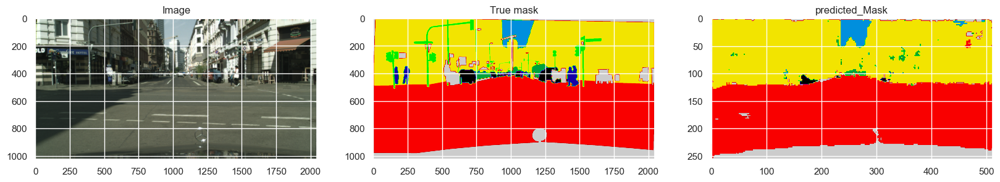

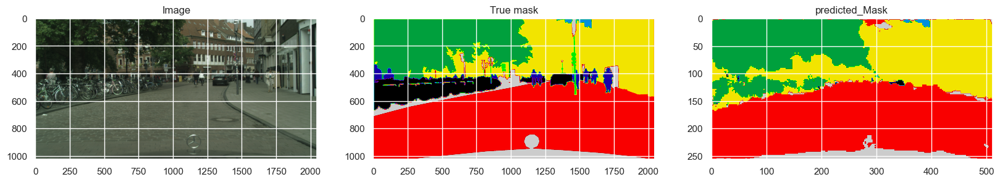

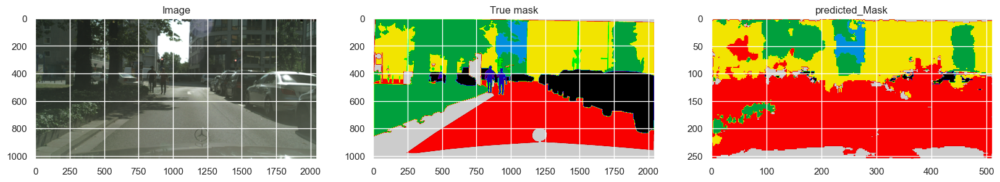

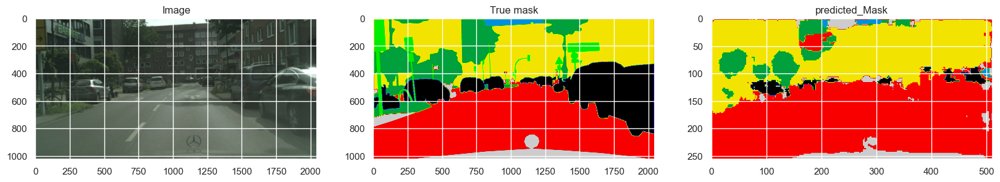

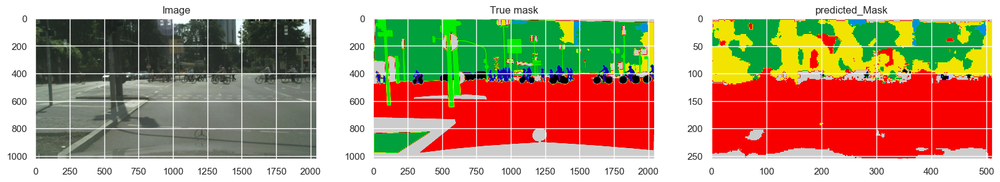

In [63]:
# Plot image, mask and prediction
plot_image_mask_prediction(vgg_unet, test_input_path, test_target_path, 
                           img_height, img_width, random=True, n=5)

### Test du modèle VGG16_fcn du projet image-segmentation-keras

In [64]:
# Name of model
model_name= 'fcn_8_vgg'
vgg_fcn = fcn_8_vgg(n_classes=8 , input_height=256, input_width=512)

In [65]:
# Set checkpoints
callbacks = [ModelCheckpoint(checkpoint_path +f'/{model_name}.h5', 
                             save_best_only=True)]

start_train = time()

hist_vgg_fcn = vgg_fcn.train(
    train_images =  "datas/images/train_clean",
    train_annotations = "datas/masks/train_clean_normalized",
    input_height=img_height,
    input_width=img_width,
    n_classes=8,
    val_images="datas/images/val_clean",
    val_annotations="datas/masks/val_clean_normalized",
    validate=True,
    do_augment=False, # enable augmentation
    callbacks=callbacks,
    checkpoints_path = "tmp/vgg_fcn_1" , epochs=5
)
training_time = time() - start_train

# Save the model
vgg_fcn.save('vgg_fcn.h5')

Verifying training dataset


100%|██████████████████████████████████████████████████████████████████████████████| 2380/2380 [02:06<00:00, 18.81it/s]


Dataset verified! 
Verifying validation dataset


100%|████████████████████████████████████████████████████████████████████████████████| 595/595 [00:31<00:00, 18.91it/s]


Dataset verified! 
Epoch 1/5
512/512 [==============================] - 283s 549ms/step - loss: 1.8958 - accuracy: 0.5442 - mean_io_u_1: 0.4375 - val_loss: 0.8346 - val_accuracy: 0.7323 - val_mean_io_u_1: 0.4375
Epoch 2/5
512/512 [==============================] - 260s 508ms/step - loss: 0.7346 - accuracy: 0.7669 - mean_io_u_1: 0.4375 - val_loss: 0.6026 - val_accuracy: 0.8154 - val_mean_io_u_1: 0.4375
Epoch 3/5
512/512 [==============================] - 260s 507ms/step - loss: 0.5958 - accuracy: 0.8165 - mean_io_u_1: 0.4375 - val_loss: 0.5497 - val_accuracy: 0.8299 - val_mean_io_u_1: 0.4375
Epoch 4/5
512/512 [==============================] - 264s 517ms/step - loss: 0.5531 - accuracy: 0.8300 - mean_io_u_1: 0.4377 - val_loss: 0.5145 - val_accuracy: 0.8484 - val_mean_io_u_1: 0.4375
Epoch 5/5
512/512 [==============================] - 312s 609ms/step - loss: 0.4987 - accuracy: 0.8479 - mean_io_u_1: 0.4391 - val_loss: 0.5975 - val_accuracy: 0.8187 - val_mean_io_u_1: 0.4375


In [66]:
hist_vgg_fcn.history

{'loss': [1.895797848701477,
  0.7345683574676514,
  0.5958396196365356,
  0.553146481513977,
  0.49865490198135376],
 'accuracy': [0.5442050695419312,
  0.7669431567192078,
  0.8164924383163452,
  0.8299881219863892,
  0.8479360938072205],
 'mean_io_u_1': [0.4375448524951935,
  0.43751296401023865,
  0.4375041723251343,
  0.43768957257270813,
  0.4391140043735504],
 'val_loss': [0.8346132040023804,
  0.6025649905204773,
  0.5496548414230347,
  0.5145018100738525,
  0.5975041389465332],
 'val_accuracy': [0.7323458790779114,
  0.8153626322746277,
  0.8299241065979004,
  0.8483818769454956,
  0.8187010288238525],
 'val_mean_io_u_1': [0.4375,
  0.4375007152557373,
  0.4375000596046448,
  0.43750500679016113,
  0.4375000298023224]}

[]

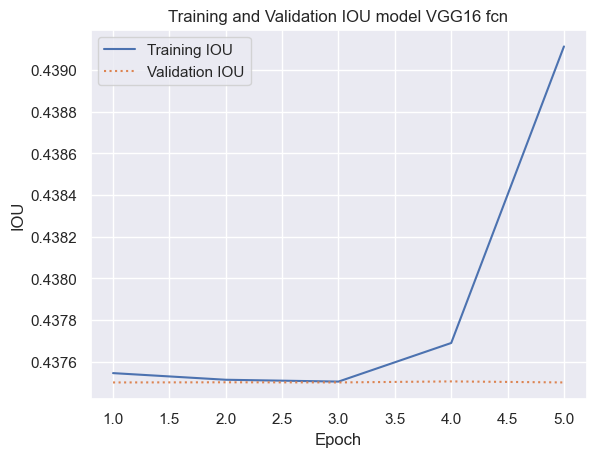

In [67]:
# Affichage des courbes pour le mean_IOU d'entraînement et de validation
sns.set()
acc = hist_vgg_fcn.history['mean_io_u_1']
val = hist_vgg_fcn.history['val_mean_io_u_1']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training IOU')
plt.plot(epochs, val, ':', label='Validation IOU')
plt.title('Training and Validation IOU model VGG16 fcn')
plt.xlabel('Epoch')
plt.ylabel('IOU')
plt.legend(loc='upper left')
plt.plot()

[]

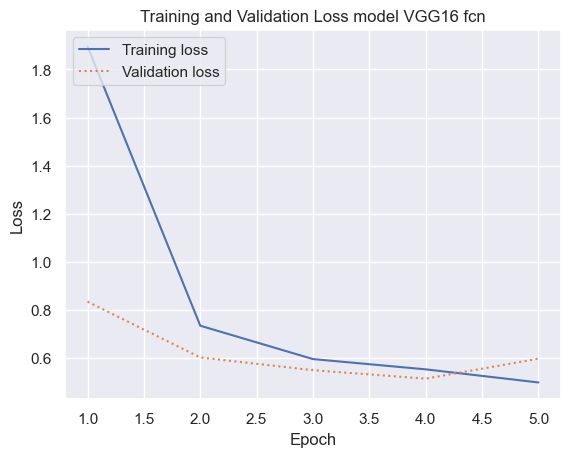

In [68]:
# Affichage des courbes pour la perte d’entraînement et pour la perte de validation 
sns.set()
acc = hist_vgg_fcn.history['loss']
val = hist_vgg_fcn.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training loss')
plt.plot(epochs, val, ':', label='Validation loss')
plt.title('Training and Validation Loss model VGG16 fcn')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.plot()

In [69]:
start_eval = time()
score_vgg_fcn = vgg_fcn.evaluate_segmentation(inp_images_dir=test_input_dir , annotations_dir=test_target_dir)
eval_time = time() - start_eval
score_vgg_fcn

0it [00:00, ?it/s]

1/1 [==============================] - 1s 756ms/step


1it [00:00,  1.12it/s]

1/1 [==============================] - 0s 22ms/step


2it [00:01,  1.90it/s]

1/1 [==============================] - 0s 21ms/step


3it [00:01,  2.43it/s]

1/1 [==============================] - 0s 21ms/step


4it [00:01,  2.78it/s]

1/1 [==============================] - 0s 22ms/step


5it [00:01,  3.02it/s]

1/1 [==============================] - 0s 21ms/step


6it [00:02,  3.17it/s]

1/1 [==============================] - 0s 21ms/step


7it [00:02,  3.27it/s]

1/1 [==============================] - 0s 21ms/step


8it [00:02,  3.39it/s]

1/1 [==============================] - 0s 21ms/step


9it [00:03,  3.42it/s]

1/1 [==============================] - 0s 21ms/step


10it [00:03,  3.43it/s]

1/1 [==============================] - 0s 29ms/step


11it [00:03,  3.48it/s]

1/1 [==============================] - 0s 21ms/step


12it [00:03,  3.52it/s]

1/1 [==============================] - 0s 23ms/step


13it [00:04,  3.54it/s]

1/1 [==============================] - 0s 22ms/step


14it [00:04,  3.53it/s]

1/1 [==============================] - 0s 23ms/step


15it [00:04,  3.55it/s]

1/1 [==============================] - 0s 23ms/step


16it [00:05,  3.57it/s]

1/1 [==============================] - 0s 20ms/step


17it [00:05,  3.56it/s]

1/1 [==============================] - 0s 21ms/step


18it [00:05,  3.56it/s]

1/1 [==============================] - 0s 22ms/step


19it [00:05,  3.60it/s]

1/1 [==============================] - 0s 24ms/step


20it [00:06,  3.60it/s]

1/1 [==============================] - 0s 21ms/step


21it [00:06,  3.55it/s]

1/1 [==============================] - 0s 23ms/step


22it [00:06,  3.62it/s]

1/1 [==============================] - 0s 20ms/step


23it [00:07,  3.59it/s]

1/1 [==============================] - 0s 22ms/step


24it [00:07,  3.64it/s]

1/1 [==============================] - 0s 20ms/step


25it [00:07,  3.66it/s]

1/1 [==============================] - 0s 20ms/step


26it [00:07,  3.65it/s]

1/1 [==============================] - 0s 22ms/step


27it [00:08,  3.68it/s]

1/1 [==============================] - 0s 22ms/step


28it [00:08,  3.68it/s]

1/1 [==============================] - 0s 21ms/step


29it [00:08,  3.64it/s]

1/1 [==============================] - 0s 21ms/step


30it [00:08,  3.62it/s]

1/1 [==============================] - 0s 23ms/step


31it [00:09,  3.65it/s]

1/1 [==============================] - 0s 21ms/step


32it [00:09,  3.76it/s]

1/1 [==============================] - 0s 21ms/step


33it [00:09,  3.91it/s]

1/1 [==============================] - 0s 20ms/step


34it [00:09,  4.02it/s]

1/1 [==============================] - 0s 21ms/step


35it [00:10,  4.07it/s]

1/1 [==============================] - 0s 19ms/step


36it [00:10,  4.15it/s]

1/1 [==============================] - 0s 22ms/step


37it [00:10,  3.93it/s]

1/1 [==============================] - 0s 24ms/step


38it [00:10,  3.73it/s]

1/1 [==============================] - 0s 25ms/step


39it [00:11,  3.54it/s]

1/1 [==============================] - 0s 23ms/step


40it [00:11,  3.39it/s]

1/1 [==============================] - 0s 24ms/step


41it [00:11,  3.30it/s]

1/1 [==============================] - 0s 23ms/step


42it [00:12,  3.25it/s]

1/1 [==============================] - 0s 24ms/step


43it [00:12,  3.21it/s]

1/1 [==============================] - 0s 23ms/step


44it [00:12,  3.21it/s]

1/1 [==============================] - 0s 22ms/step


45it [00:13,  3.20it/s]

1/1 [==============================] - 0s 23ms/step


46it [00:13,  3.19it/s]

1/1 [==============================] - 0s 23ms/step


47it [00:13,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


48it [00:14,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


49it [00:14,  3.11it/s]

1/1 [==============================] - 0s 23ms/step


50it [00:14,  3.11it/s]

1/1 [==============================] - 0s 23ms/step


51it [00:15,  3.15it/s]

1/1 [==============================] - 0s 23ms/step


52it [00:15,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


53it [00:15,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


54it [00:16,  3.19it/s]

1/1 [==============================] - 0s 23ms/step


55it [00:16,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


56it [00:16,  3.19it/s]

1/1 [==============================] - 0s 23ms/step


57it [00:17,  3.16it/s]

1/1 [==============================] - 0s 22ms/step


58it [00:17,  3.13it/s]

1/1 [==============================] - 0s 23ms/step


59it [00:17,  3.11it/s]

1/1 [==============================] - 0s 23ms/step


60it [00:17,  3.14it/s]

1/1 [==============================] - 0s 22ms/step


61it [00:18,  3.14it/s]

1/1 [==============================] - 0s 23ms/step


62it [00:18,  3.15it/s]

1/1 [==============================] - 0s 23ms/step


63it [00:18,  3.16it/s]

1/1 [==============================] - 0s 22ms/step


64it [00:19,  3.12it/s]

1/1 [==============================] - 0s 23ms/step


65it [00:19,  3.10it/s]

1/1 [==============================] - 0s 24ms/step


66it [00:19,  3.13it/s]

1/1 [==============================] - 0s 23ms/step


67it [00:20,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


68it [00:20,  3.15it/s]

1/1 [==============================] - 0s 22ms/step


69it [00:20,  3.02it/s]

1/1 [==============================] - 0s 22ms/step


70it [00:21,  3.09it/s]

1/1 [==============================] - 0s 23ms/step


71it [00:21,  3.10it/s]

1/1 [==============================] - 0s 24ms/step


72it [00:21,  3.13it/s]

1/1 [==============================] - 0s 22ms/step


73it [00:22,  3.13it/s]

1/1 [==============================] - 0s 22ms/step


74it [00:22,  3.12it/s]

1/1 [==============================] - 0s 23ms/step


75it [00:22,  3.11it/s]

1/1 [==============================] - 0s 24ms/step


76it [00:23,  3.13it/s]

1/1 [==============================] - 0s 24ms/step


77it [00:23,  3.12it/s]

1/1 [==============================] - 0s 24ms/step


78it [00:23,  3.14it/s]

1/1 [==============================] - 0s 23ms/step


79it [00:24,  3.13it/s]

1/1 [==============================] - 0s 24ms/step


80it [00:24,  3.17it/s]

1/1 [==============================] - 0s 24ms/step


81it [00:24,  3.13it/s]

1/1 [==============================] - 0s 24ms/step


82it [00:25,  3.15it/s]

1/1 [==============================] - 0s 22ms/step


83it [00:25,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


84it [00:25,  3.10it/s]

1/1 [==============================] - 0s 23ms/step


85it [00:25,  3.09it/s]

1/1 [==============================] - 0s 23ms/step


86it [00:26,  3.10it/s]

1/1 [==============================] - 0s 24ms/step


87it [00:26,  3.10it/s]

1/1 [==============================] - 0s 22ms/step


88it [00:26,  3.14it/s]

1/1 [==============================] - 0s 22ms/step


89it [00:27,  3.14it/s]

1/1 [==============================] - 0s 23ms/step


90it [00:27,  3.14it/s]

1/1 [==============================] - 0s 23ms/step


91it [00:27,  3.16it/s]

1/1 [==============================] - 0s 22ms/step


92it [00:28,  3.13it/s]

1/1 [==============================] - 0s 24ms/step


93it [00:28,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


94it [00:28,  3.15it/s]

1/1 [==============================] - 0s 24ms/step


95it [00:29,  3.15it/s]

1/1 [==============================] - 0s 23ms/step


96it [00:29,  3.17it/s]

1/1 [==============================] - 0s 24ms/step


97it [00:29,  3.18it/s]

1/1 [==============================] - 0s 23ms/step


98it [00:30,  3.18it/s]

1/1 [==============================] - 0s 23ms/step


99it [00:30,  3.18it/s]

1/1 [==============================] - 0s 23ms/step


100it [00:30,  3.18it/s]

1/1 [==============================] - 0s 23ms/step


101it [00:31,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


102it [00:31,  3.14it/s]

1/1 [==============================] - 0s 21ms/step


103it [00:31,  3.18it/s]

1/1 [==============================] - 0s 20ms/step


104it [00:31,  3.39it/s]

1/1 [==============================] - 0s 20ms/step


105it [00:32,  3.62it/s]

1/1 [==============================] - 0s 22ms/step


106it [00:32,  3.74it/s]

1/1 [==============================] - 0s 21ms/step


107it [00:32,  3.87it/s]

1/1 [==============================] - 0s 20ms/step


108it [00:32,  3.97it/s]

1/1 [==============================] - 0s 19ms/step


109it [00:33,  4.04it/s]

1/1 [==============================] - 0s 20ms/step


110it [00:33,  4.03it/s]

1/1 [==============================] - 0s 23ms/step


111it [00:33,  3.75it/s]

1/1 [==============================] - 0s 26ms/step


112it [00:34,  3.42it/s]

1/1 [==============================] - 0s 19ms/step


113it [00:34,  3.61it/s]

1/1 [==============================] - 0s 25ms/step


114it [00:34,  3.37it/s]

1/1 [==============================] - 0s 25ms/step


115it [00:34,  3.27it/s]

1/1 [==============================] - 0s 25ms/step


116it [00:35,  3.17it/s]

1/1 [==============================] - 0s 24ms/step


117it [00:35,  3.09it/s]

1/1 [==============================] - 0s 24ms/step


118it [00:35,  3.05it/s]

1/1 [==============================] - 0s 24ms/step


119it [00:36,  3.09it/s]

1/1 [==============================] - 0s 27ms/step


120it [00:36,  3.09it/s]

1/1 [==============================] - 0s 25ms/step


121it [00:36,  3.12it/s]

1/1 [==============================] - 0s 24ms/step


122it [00:37,  3.09it/s]

1/1 [==============================] - 0s 24ms/step


123it [00:37,  3.09it/s]

1/1 [==============================] - 0s 25ms/step


124it [00:37,  3.08it/s]

1/1 [==============================] - 0s 24ms/step


125it [00:38,  3.08it/s]

1/1 [==============================] - 0s 24ms/step


126it [00:38,  3.05it/s]

1/1 [==============================] - 0s 24ms/step


127it [00:38,  3.04it/s]

1/1 [==============================] - 0s 25ms/step


128it [00:39,  3.00it/s]

1/1 [==============================] - 0s 25ms/step


129it [00:39,  3.02it/s]

1/1 [==============================] - 0s 25ms/step


130it [00:39,  3.08it/s]

1/1 [==============================] - 0s 25ms/step


131it [00:40,  3.06it/s]

1/1 [==============================] - 0s 24ms/step


132it [00:40,  3.06it/s]

1/1 [==============================] - 0s 25ms/step


133it [00:40,  3.08it/s]

1/1 [==============================] - 0s 26ms/step


134it [00:41,  3.11it/s]

1/1 [==============================] - 0s 24ms/step


135it [00:41,  3.11it/s]

1/1 [==============================] - 0s 24ms/step


136it [00:41,  3.11it/s]

1/1 [==============================] - 0s 25ms/step


137it [00:42,  3.06it/s]

1/1 [==============================] - 0s 27ms/step


138it [00:42,  3.06it/s]

1/1 [==============================] - 0s 24ms/step


139it [00:42,  3.05it/s]

1/1 [==============================] - 0s 24ms/step


140it [00:43,  3.07it/s]

1/1 [==============================] - 0s 23ms/step


141it [00:43,  3.05it/s]

1/1 [==============================] - 0s 24ms/step


142it [00:43,  3.04it/s]

1/1 [==============================] - 0s 24ms/step


143it [00:44,  3.00it/s]

1/1 [==============================] - 0s 25ms/step


144it [00:44,  3.03it/s]

1/1 [==============================] - 0s 24ms/step


145it [00:44,  3.05it/s]

1/1 [==============================] - 0s 23ms/step


146it [00:45,  3.03it/s]

1/1 [==============================] - 0s 26ms/step


147it [00:45,  3.05it/s]

1/1 [==============================] - 0s 25ms/step


148it [00:45,  3.05it/s]

1/1 [==============================] - 0s 24ms/step


149it [00:46,  3.08it/s]

1/1 [==============================] - 0s 24ms/step


150it [00:46,  3.11it/s]

1/1 [==============================] - 0s 23ms/step


151it [00:46,  3.07it/s]

1/1 [==============================] - 0s 24ms/step


152it [00:47,  3.09it/s]

1/1 [==============================] - 0s 26ms/step


153it [00:47,  3.08it/s]

1/1 [==============================] - 0s 25ms/step


154it [00:47,  3.04it/s]

1/1 [==============================] - 0s 25ms/step


155it [00:48,  3.08it/s]

1/1 [==============================] - 0s 23ms/step


156it [00:48,  3.02it/s]

1/1 [==============================] - 0s 23ms/step


157it [00:48,  3.06it/s]

1/1 [==============================] - 0s 22ms/step


158it [00:49,  3.10it/s]

1/1 [==============================] - 0s 26ms/step


159it [00:49,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


160it [00:49,  3.18it/s]

1/1 [==============================] - 0s 23ms/step


161it [00:49,  3.21it/s]

1/1 [==============================] - 0s 24ms/step


162it [00:50,  3.21it/s]

1/1 [==============================] - 0s 22ms/step


163it [00:50,  3.21it/s]

1/1 [==============================] - 0s 24ms/step


164it [00:50,  3.20it/s]

1/1 [==============================] - 0s 24ms/step


165it [00:51,  3.23it/s]

1/1 [==============================] - 0s 24ms/step


166it [00:51,  3.19it/s]

1/1 [==============================] - 0s 24ms/step


167it [00:51,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


168it [00:52,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


169it [00:52,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


170it [00:52,  3.15it/s]

1/1 [==============================] - 0s 24ms/step


171it [00:53,  3.35it/s]

1/1 [==============================] - 0s 23ms/step


172it [00:53,  3.35it/s]

1/1 [==============================] - 0s 23ms/step


173it [00:53,  3.38it/s]

1/1 [==============================] - 0s 25ms/step


174it [00:53,  3.38it/s]

1/1 [==============================] - 0s 25ms/step


175it [00:54,  3.38it/s]

1/1 [==============================] - 0s 22ms/step


176it [00:54,  3.35it/s]

1/1 [==============================] - 0s 22ms/step


177it [00:54,  3.32it/s]

1/1 [==============================] - 0s 21ms/step


178it [00:55,  3.32it/s]

1/1 [==============================] - 0s 22ms/step


179it [00:55,  3.36it/s]

1/1 [==============================] - 0s 22ms/step


180it [00:55,  3.40it/s]

1/1 [==============================] - 0s 23ms/step


181it [00:55,  3.41it/s]

1/1 [==============================] - 0s 22ms/step


182it [00:56,  3.39it/s]

1/1 [==============================] - 0s 26ms/step


183it [00:56,  3.39it/s]

1/1 [==============================] - 0s 23ms/step


184it [00:56,  3.38it/s]

1/1 [==============================] - 0s 26ms/step


185it [00:57,  3.39it/s]

1/1 [==============================] - 0s 24ms/step


186it [00:57,  3.39it/s]

1/1 [==============================] - 0s 24ms/step


187it [00:57,  3.41it/s]

1/1 [==============================] - 0s 23ms/step


188it [00:58,  3.43it/s]

1/1 [==============================] - 0s 23ms/step


189it [00:58,  3.44it/s]

1/1 [==============================] - 0s 23ms/step


190it [00:58,  3.41it/s]

1/1 [==============================] - 0s 22ms/step


191it [00:58,  3.41it/s]

1/1 [==============================] - 0s 26ms/step


192it [00:59,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


193it [00:59,  3.25it/s]

1/1 [==============================] - 0s 24ms/step


194it [00:59,  3.21it/s]

1/1 [==============================] - 0s 28ms/step


195it [01:00,  3.12it/s]

1/1 [==============================] - 0s 24ms/step


196it [01:00,  3.13it/s]

1/1 [==============================] - 0s 24ms/step


197it [01:00,  3.12it/s]

1/1 [==============================] - 0s 26ms/step


198it [01:01,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


199it [01:01,  3.19it/s]

1/1 [==============================] - 0s 25ms/step


200it [01:01,  3.18it/s]

1/1 [==============================] - 0s 24ms/step


201it [01:02,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


202it [01:02,  3.16it/s]

1/1 [==============================] - 0s 25ms/step


203it [01:02,  3.18it/s]

1/1 [==============================] - 0s 25ms/step


204it [01:03,  3.18it/s]

1/1 [==============================] - 0s 24ms/step


205it [01:03,  3.18it/s]

1/1 [==============================] - 0s 24ms/step


206it [01:03,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


207it [01:04,  3.15it/s]

1/1 [==============================] - 0s 23ms/step


208it [01:04,  3.17it/s]

1/1 [==============================] - 0s 24ms/step


209it [01:04,  3.18it/s]

1/1 [==============================] - 0s 24ms/step


210it [01:04,  3.19it/s]

1/1 [==============================] - 0s 23ms/step


211it [01:05,  3.20it/s]

1/1 [==============================] - 0s 25ms/step


212it [01:05,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


213it [01:05,  3.17it/s]

1/1 [==============================] - 0s 24ms/step


214it [01:06,  3.18it/s]

1/1 [==============================] - 0s 23ms/step


215it [01:06,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


216it [01:06,  3.14it/s]

1/1 [==============================] - 0s 24ms/step


217it [01:07,  3.16it/s]

1/1 [==============================] - 0s 25ms/step


218it [01:07,  3.17it/s]

1/1 [==============================] - 0s 26ms/step


219it [01:07,  3.24it/s]

1/1 [==============================] - 0s 25ms/step


220it [01:08,  3.28it/s]

1/1 [==============================] - 0s 24ms/step


221it [01:08,  3.23it/s]

1/1 [==============================] - 0s 24ms/step


222it [01:08,  3.26it/s]

1/1 [==============================] - 0s 24ms/step


223it [01:08,  3.29it/s]

1/1 [==============================] - 0s 25ms/step


224it [01:09,  3.42it/s]

1/1 [==============================] - 0s 24ms/step


225it [01:09,  3.31it/s]

1/1 [==============================] - 0s 24ms/step


226it [01:09,  3.28it/s]

1/1 [==============================] - 0s 24ms/step


227it [01:10,  3.25it/s]

1/1 [==============================] - 0s 25ms/step


228it [01:10,  3.22it/s]

1/1 [==============================] - 0s 24ms/step


229it [01:10,  3.24it/s]

1/1 [==============================] - 0s 23ms/step


230it [01:11,  3.31it/s]

1/1 [==============================] - 0s 23ms/step


231it [01:11,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


232it [01:11,  3.33it/s]

1/1 [==============================] - 0s 24ms/step


233it [01:12,  3.31it/s]

1/1 [==============================] - 0s 23ms/step


234it [01:12,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


235it [01:12,  3.32it/s]

1/1 [==============================] - 0s 23ms/step


236it [01:12,  3.32it/s]

1/1 [==============================] - 0s 23ms/step


237it [01:13,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


238it [01:13,  3.29it/s]

1/1 [==============================] - 0s 23ms/step


239it [01:13,  3.30it/s]

1/1 [==============================] - 0s 23ms/step


240it [01:14,  3.34it/s]

1/1 [==============================] - 0s 24ms/step


241it [01:14,  3.36it/s]

1/1 [==============================] - 0s 24ms/step


242it [01:14,  3.36it/s]

1/1 [==============================] - 0s 24ms/step


243it [01:15,  3.34it/s]

1/1 [==============================] - 0s 25ms/step


244it [01:15,  3.34it/s]

1/1 [==============================] - 0s 23ms/step


245it [01:15,  3.32it/s]

1/1 [==============================] - 0s 24ms/step


246it [01:15,  3.29it/s]

1/1 [==============================] - 0s 23ms/step


247it [01:16,  3.29it/s]

1/1 [==============================] - 0s 23ms/step


248it [01:16,  3.30it/s]

1/1 [==============================] - 0s 23ms/step


249it [01:16,  3.32it/s]

1/1 [==============================] - 0s 23ms/step


250it [01:17,  3.37it/s]

1/1 [==============================] - 0s 24ms/step


251it [01:17,  3.32it/s]

1/1 [==============================] - 0s 25ms/step


252it [01:17,  3.25it/s]

1/1 [==============================] - 0s 24ms/step


253it [01:18,  3.16it/s]

1/1 [==============================] - 0s 25ms/step


254it [01:18,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


255it [01:18,  3.16it/s]

1/1 [==============================] - 0s 26ms/step


256it [01:19,  3.15it/s]

1/1 [==============================] - 0s 23ms/step


257it [01:19,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


258it [01:19,  3.17it/s]

1/1 [==============================] - 0s 24ms/step


259it [01:19,  3.19it/s]

1/1 [==============================] - 0s 26ms/step


260it [01:20,  3.20it/s]

1/1 [==============================] - 0s 23ms/step


261it [01:20,  3.18it/s]

1/1 [==============================] - 0s 23ms/step


262it [01:20,  3.15it/s]

1/1 [==============================] - 0s 23ms/step


263it [01:21,  3.16it/s]

1/1 [==============================] - 0s 23ms/step


264it [01:21,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


265it [01:21,  3.15it/s]

1/1 [==============================] - 0s 25ms/step


266it [01:22,  3.14it/s]

1/1 [==============================] - 0s 25ms/step


267it [01:22,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


268it [01:22,  3.15it/s]

1/1 [==============================] - 0s 23ms/step


269it [01:23,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


270it [01:23,  3.19it/s]

1/1 [==============================] - 0s 24ms/step


271it [01:23,  3.19it/s]

1/1 [==============================] - 0s 24ms/step


272it [01:24,  3.21it/s]

1/1 [==============================] - 0s 25ms/step


273it [01:24,  3.25it/s]

1/1 [==============================] - 0s 24ms/step


274it [01:24,  3.23it/s]

1/1 [==============================] - 0s 20ms/step


275it [01:24,  3.28it/s]

1/1 [==============================] - 0s 24ms/step


276it [01:25,  3.30it/s]

1/1 [==============================] - 0s 25ms/step


277it [01:25,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


278it [01:25,  3.27it/s]

1/1 [==============================] - 0s 27ms/step


279it [01:26,  3.24it/s]

1/1 [==============================] - 0s 26ms/step


280it [01:26,  3.29it/s]

1/1 [==============================] - 0s 26ms/step


281it [01:26,  3.29it/s]

1/1 [==============================] - 0s 25ms/step


282it [01:27,  3.24it/s]

1/1 [==============================] - 0s 24ms/step


283it [01:27,  3.29it/s]

1/1 [==============================] - 0s 23ms/step


284it [01:27,  3.27it/s]

1/1 [==============================] - 0s 22ms/step


285it [01:28,  3.27it/s]

1/1 [==============================] - 0s 24ms/step


286it [01:28,  3.22it/s]

1/1 [==============================] - 0s 26ms/step


287it [01:28,  3.21it/s]

1/1 [==============================] - 0s 25ms/step


288it [01:28,  3.22it/s]

1/1 [==============================] - 0s 24ms/step


289it [01:29,  3.22it/s]

1/1 [==============================] - 0s 24ms/step


290it [01:29,  3.24it/s]

1/1 [==============================] - 0s 22ms/step


291it [01:29,  3.22it/s]

1/1 [==============================] - 0s 23ms/step


292it [01:30,  3.20it/s]

1/1 [==============================] - 0s 24ms/step


293it [01:30,  3.19it/s]

1/1 [==============================] - 0s 25ms/step


294it [01:30,  3.22it/s]

1/1 [==============================] - 0s 25ms/step


295it [01:31,  3.22it/s]

1/1 [==============================] - 0s 26ms/step


296it [01:31,  3.22it/s]

1/1 [==============================] - 0s 25ms/step


297it [01:31,  3.19it/s]

1/1 [==============================] - 0s 26ms/step


298it [01:32,  3.21it/s]

1/1 [==============================] - 0s 24ms/step


299it [01:32,  3.18it/s]

1/1 [==============================] - 0s 26ms/step


300it [01:32,  3.12it/s]

1/1 [==============================] - 0s 27ms/step


301it [01:33,  3.12it/s]

1/1 [==============================] - 0s 24ms/step


302it [01:33,  3.08it/s]

1/1 [==============================] - 0s 27ms/step


303it [01:33,  3.14it/s]

1/1 [==============================] - 0s 24ms/step


304it [01:34,  3.12it/s]

1/1 [==============================] - 0s 24ms/step


305it [01:34,  3.09it/s]

1/1 [==============================] - 0s 24ms/step


306it [01:34,  3.09it/s]

1/1 [==============================] - 0s 26ms/step


307it [01:34,  3.15it/s]

1/1 [==============================] - 0s 24ms/step


308it [01:35,  3.20it/s]

1/1 [==============================] - 0s 24ms/step


309it [01:35,  3.23it/s]

1/1 [==============================] - 0s 26ms/step


310it [01:35,  3.20it/s]

1/1 [==============================] - 0s 23ms/step


311it [01:36,  3.19it/s]

1/1 [==============================] - 0s 25ms/step


312it [01:36,  3.15it/s]

1/1 [==============================] - 0s 24ms/step


313it [01:36,  3.16it/s]

1/1 [==============================] - 0s 27ms/step


314it [01:37,  3.21it/s]

1/1 [==============================] - 0s 25ms/step


315it [01:37,  3.19it/s]

1/1 [==============================] - 0s 24ms/step


316it [01:37,  3.15it/s]

1/1 [==============================] - 0s 25ms/step


317it [01:38,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


318it [01:38,  3.20it/s]

1/1 [==============================] - 0s 24ms/step


319it [01:38,  3.15it/s]

1/1 [==============================] - 0s 26ms/step


320it [01:39,  3.10it/s]

1/1 [==============================] - 0s 24ms/step


321it [01:39,  3.14it/s]

1/1 [==============================] - 0s 26ms/step


322it [01:39,  3.11it/s]

1/1 [==============================] - 0s 24ms/step


323it [01:40,  3.09it/s]

1/1 [==============================] - 0s 25ms/step


324it [01:40,  3.09it/s]

1/1 [==============================] - 0s 25ms/step


325it [01:40,  3.11it/s]

1/1 [==============================] - 0s 25ms/step


326it [01:40,  3.15it/s]

1/1 [==============================] - 0s 26ms/step


327it [01:41,  3.12it/s]

1/1 [==============================] - 0s 24ms/step


328it [01:41,  3.15it/s]

1/1 [==============================] - 0s 25ms/step


329it [01:41,  3.15it/s]

1/1 [==============================] - 0s 26ms/step


330it [01:42,  3.15it/s]

1/1 [==============================] - 0s 24ms/step


331it [01:42,  3.19it/s]

1/1 [==============================] - 0s 23ms/step


332it [01:42,  3.23it/s]

1/1 [==============================] - 0s 23ms/step


333it [01:43,  3.22it/s]

1/1 [==============================] - 0s 23ms/step


334it [01:43,  3.28it/s]

1/1 [==============================] - 0s 24ms/step


335it [01:43,  3.31it/s]

1/1 [==============================] - 0s 24ms/step


336it [01:44,  3.33it/s]

1/1 [==============================] - 0s 25ms/step


337it [01:44,  3.33it/s]

1/1 [==============================] - 0s 24ms/step


338it [01:44,  3.28it/s]

1/1 [==============================] - 0s 24ms/step


339it [01:45,  3.22it/s]

1/1 [==============================] - 0s 25ms/step


340it [01:45,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


341it [01:45,  3.20it/s]

1/1 [==============================] - 0s 25ms/step


342it [01:45,  3.19it/s]

1/1 [==============================] - 0s 25ms/step


343it [01:46,  3.21it/s]

1/1 [==============================] - 0s 27ms/step


344it [01:46,  3.19it/s]

1/1 [==============================] - 0s 24ms/step


345it [01:46,  3.20it/s]

1/1 [==============================] - 0s 26ms/step


346it [01:47,  3.23it/s]

1/1 [==============================] - 0s 25ms/step


347it [01:47,  3.18it/s]

1/1 [==============================] - 0s 25ms/step


348it [01:47,  3.20it/s]

1/1 [==============================] - 0s 26ms/step


349it [01:48,  3.22it/s]

1/1 [==============================] - 0s 25ms/step


350it [01:48,  3.21it/s]

1/1 [==============================] - 0s 28ms/step


351it [01:48,  3.23it/s]

1/1 [==============================] - 0s 24ms/step


352it [01:49,  3.22it/s]

1/1 [==============================] - 0s 25ms/step


353it [01:49,  3.22it/s]

1/1 [==============================] - 0s 25ms/step


354it [01:49,  3.20it/s]

1/1 [==============================] - 0s 24ms/step


355it [01:50,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


356it [01:50,  3.16it/s]

1/1 [==============================] - 0s 24ms/step


357it [01:50,  3.18it/s]

1/1 [==============================] - 0s 25ms/step


358it [01:50,  3.13it/s]

1/1 [==============================] - 0s 24ms/step


359it [01:51,  3.19it/s]

1/1 [==============================] - 0s 24ms/step


360it [01:51,  3.21it/s]

1/1 [==============================] - 0s 24ms/step


361it [01:51,  3.25it/s]

1/1 [==============================] - 0s 22ms/step


362it [01:52,  3.26it/s]

1/1 [==============================] - 0s 23ms/step


363it [01:52,  3.29it/s]

1/1 [==============================] - 0s 23ms/step


364it [01:52,  3.32it/s]

1/1 [==============================] - 0s 23ms/step


365it [01:53,  3.36it/s]

1/1 [==============================] - 0s 19ms/step


366it [01:53,  3.32it/s]

1/1 [==============================] - 0s 24ms/step


367it [01:53,  3.20it/s]

1/1 [==============================] - 0s 24ms/step


368it [01:54,  3.20it/s]

1/1 [==============================] - 0s 22ms/step


369it [01:54,  3.37it/s]

1/1 [==============================] - 0s 24ms/step


370it [01:54,  3.33it/s]

1/1 [==============================] - 0s 25ms/step


371it [01:54,  3.26it/s]

1/1 [==============================] - 0s 27ms/step


372it [01:55,  3.19it/s]

1/1 [==============================] - 0s 24ms/step


373it [01:55,  3.10it/s]

1/1 [==============================] - 0s 24ms/step


374it [01:55,  3.08it/s]

1/1 [==============================] - 0s 23ms/step


375it [01:56,  3.07it/s]

1/1 [==============================] - 0s 25ms/step


376it [01:56,  3.06it/s]

1/1 [==============================] - 0s 23ms/step


377it [01:56,  3.06it/s]

1/1 [==============================] - 0s 23ms/step


378it [01:57,  3.05it/s]

1/1 [==============================] - 0s 25ms/step


379it [01:57,  2.99it/s]

1/1 [==============================] - 0s 25ms/step


380it [01:57,  2.94it/s]

1/1 [==============================] - 0s 24ms/step


381it [01:58,  2.92it/s]

1/1 [==============================] - 0s 23ms/step


382it [01:58,  2.94it/s]

1/1 [==============================] - 0s 25ms/step


383it [01:58,  2.99it/s]

1/1 [==============================] - 0s 24ms/step


384it [01:59,  2.97it/s]

1/1 [==============================] - 0s 24ms/step


385it [01:59,  2.93it/s]

1/1 [==============================] - 0s 24ms/step


386it [01:59,  2.93it/s]

1/1 [==============================] - 0s 24ms/step


387it [02:00,  2.93it/s]

1/1 [==============================] - 0s 26ms/step


388it [02:00,  2.95it/s]

1/1 [==============================] - 0s 24ms/step


389it [02:00,  2.95it/s]

1/1 [==============================] - 0s 23ms/step


390it [02:01,  2.97it/s]

1/1 [==============================] - 0s 25ms/step


391it [02:01,  3.17it/s]

1/1 [==============================] - 0s 25ms/step


392it [02:01,  3.17it/s]

1/1 [==============================] - 0s 23ms/step


393it [02:02,  3.20it/s]

1/1 [==============================] - 0s 24ms/step


394it [02:02,  3.23it/s]

1/1 [==============================] - 0s 24ms/step


395it [02:02,  3.27it/s]

1/1 [==============================] - 0s 24ms/step


396it [02:03,  3.28it/s]

1/1 [==============================] - 0s 23ms/step


397it [02:03,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


398it [02:03,  3.23it/s]

1/1 [==============================] - 0s 23ms/step


399it [02:04,  3.24it/s]

1/1 [==============================] - 0s 24ms/step


400it [02:04,  3.26it/s]

1/1 [==============================] - 0s 23ms/step


401it [02:04,  3.25it/s]

1/1 [==============================] - 0s 25ms/step


402it [02:04,  3.28it/s]

1/1 [==============================] - 0s 22ms/step


403it [02:05,  3.32it/s]

1/1 [==============================] - 0s 24ms/step


404it [02:05,  3.31it/s]

1/1 [==============================] - 0s 23ms/step


405it [02:05,  3.37it/s]

1/1 [==============================] - 0s 23ms/step


406it [02:06,  3.39it/s]

1/1 [==============================] - 0s 23ms/step


407it [02:06,  3.35it/s]

1/1 [==============================] - 0s 24ms/step


408it [02:06,  3.35it/s]

1/1 [==============================] - 0s 25ms/step


409it [02:07,  3.27it/s]

1/1 [==============================] - 0s 23ms/step


410it [02:07,  3.27it/s]

1/1 [==============================] - 0s 23ms/step


411it [02:07,  3.24it/s]

1/1 [==============================] - 0s 27ms/step


412it [02:07,  3.24it/s]

1/1 [==============================] - 0s 24ms/step


413it [02:08,  3.21it/s]

1/1 [==============================] - 0s 23ms/step


414it [02:08,  3.18it/s]

1/1 [==============================] - 0s 24ms/step


415it [02:08,  3.22it/s]

1/1 [==============================] - 0s 24ms/step


416it [02:09,  3.22it/s]

1/1 [==============================] - 0s 24ms/step


417it [02:09,  3.21it/s]

1/1 [==============================] - 0s 24ms/step


418it [02:09,  3.22it/s]

1/1 [==============================] - 0s 25ms/step


419it [02:10,  3.26it/s]

1/1 [==============================] - 0s 23ms/step


420it [02:10,  3.26it/s]

1/1 [==============================] - 0s 23ms/step


421it [02:10,  3.25it/s]

1/1 [==============================] - 0s 18ms/step


422it [02:11,  3.34it/s]

1/1 [==============================] - 0s 23ms/step


423it [02:11,  3.31it/s]

1/1 [==============================] - 0s 24ms/step


424it [02:11,  3.30it/s]

1/1 [==============================] - 0s 22ms/step


425it [02:11,  3.33it/s]

1/1 [==============================] - 0s 24ms/step


426it [02:12,  3.32it/s]

1/1 [==============================] - 0s 24ms/step


427it [02:12,  3.27it/s]

1/1 [==============================] - 0s 24ms/step


428it [02:12,  3.26it/s]

1/1 [==============================] - 0s 22ms/step


429it [02:13,  3.32it/s]

1/1 [==============================] - 0s 24ms/step


430it [02:13,  3.31it/s]

1/1 [==============================] - 0s 23ms/step


431it [02:13,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


432it [02:14,  3.30it/s]

1/1 [==============================] - 0s 23ms/step


433it [02:14,  3.30it/s]

1/1 [==============================] - 0s 22ms/step


434it [02:14,  3.33it/s]

1/1 [==============================] - 0s 22ms/step


435it [02:14,  3.33it/s]

1/1 [==============================] - 0s 23ms/step


436it [02:15,  3.28it/s]

1/1 [==============================] - 0s 22ms/step


437it [02:15,  3.27it/s]

1/1 [==============================] - 0s 23ms/step


438it [02:15,  3.24it/s]

1/1 [==============================] - 0s 22ms/step


439it [02:16,  3.27it/s]

1/1 [==============================] - 0s 23ms/step


440it [02:16,  3.26it/s]

1/1 [==============================] - 0s 25ms/step


441it [02:16,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


442it [02:17,  3.34it/s]

1/1 [==============================] - 0s 24ms/step


443it [02:17,  3.28it/s]

1/1 [==============================] - 0s 25ms/step


444it [02:17,  3.28it/s]

1/1 [==============================] - 0s 23ms/step


445it [02:18,  3.34it/s]

1/1 [==============================] - 0s 23ms/step


446it [02:18,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


447it [02:18,  3.30it/s]

1/1 [==============================] - 0s 24ms/step


448it [02:18,  3.34it/s]

1/1 [==============================] - 0s 23ms/step


449it [02:19,  3.31it/s]

1/1 [==============================] - 0s 24ms/step


450it [02:19,  3.31it/s]

1/1 [==============================] - 0s 23ms/step


451it [02:19,  3.33it/s]

1/1 [==============================] - 0s 23ms/step


452it [02:20,  3.37it/s]

1/1 [==============================] - 0s 23ms/step


453it [02:20,  3.34it/s]

1/1 [==============================] - 0s 23ms/step


454it [02:20,  3.33it/s]

1/1 [==============================] - 0s 22ms/step


455it [02:21,  3.36it/s]

1/1 [==============================] - 0s 23ms/step


456it [02:21,  3.28it/s]

1/1 [==============================] - 0s 23ms/step


457it [02:21,  3.26it/s]

1/1 [==============================] - 0s 23ms/step


458it [02:21,  3.28it/s]

1/1 [==============================] - 0s 23ms/step


459it [02:22,  3.29it/s]

1/1 [==============================] - 0s 23ms/step


460it [02:22,  3.29it/s]

1/1 [==============================] - 0s 22ms/step


461it [02:22,  3.26it/s]

1/1 [==============================] - 0s 24ms/step


462it [02:23,  3.30it/s]

1/1 [==============================] - 0s 23ms/step


463it [02:23,  3.28it/s]

1/1 [==============================] - 0s 23ms/step


464it [02:23,  3.29it/s]

1/1 [==============================] - 0s 23ms/step


465it [02:24,  3.29it/s]

1/1 [==============================] - 0s 24ms/step


466it [02:24,  3.29it/s]

1/1 [==============================] - 0s 25ms/step


467it [02:24,  3.34it/s]

1/1 [==============================] - 0s 23ms/step


468it [02:24,  3.33it/s]

1/1 [==============================] - 0s 23ms/step


469it [02:25,  3.35it/s]

1/1 [==============================] - 0s 24ms/step


470it [02:25,  3.38it/s]

1/1 [==============================] - 0s 23ms/step


471it [02:25,  3.44it/s]

1/1 [==============================] - 0s 24ms/step


472it [02:26,  3.45it/s]

1/1 [==============================] - 0s 24ms/step


473it [02:26,  3.41it/s]

1/1 [==============================] - 0s 24ms/step


474it [02:26,  3.41it/s]

1/1 [==============================] - 0s 24ms/step


475it [02:27,  3.39it/s]

1/1 [==============================] - 0s 23ms/step


476it [02:27,  3.35it/s]

1/1 [==============================] - 0s 24ms/step


477it [02:27,  3.31it/s]

1/1 [==============================] - 0s 22ms/step


478it [02:27,  3.34it/s]

1/1 [==============================] - 0s 23ms/step


479it [02:28,  3.37it/s]

1/1 [==============================] - 0s 24ms/step


480it [02:28,  3.39it/s]

1/1 [==============================] - 0s 24ms/step


481it [02:28,  3.36it/s]

1/1 [==============================] - 0s 24ms/step


482it [02:29,  3.34it/s]

1/1 [==============================] - 0s 24ms/step


483it [02:29,  3.36it/s]

1/1 [==============================] - 0s 24ms/step


484it [02:29,  3.35it/s]

1/1 [==============================] - 0s 23ms/step


485it [02:30,  3.32it/s]

1/1 [==============================] - 0s 28ms/step


486it [02:30,  3.31it/s]

1/1 [==============================] - 0s 24ms/step


487it [02:30,  3.34it/s]

1/1 [==============================] - 0s 25ms/step


488it [02:30,  3.34it/s]

1/1 [==============================] - 0s 24ms/step


489it [02:31,  3.39it/s]

1/1 [==============================] - 0s 24ms/step


490it [02:31,  3.37it/s]

1/1 [==============================] - 0s 24ms/step


491it [02:31,  3.39it/s]

1/1 [==============================] - 0s 27ms/step


492it [02:32,  3.44it/s]

1/1 [==============================] - 0s 24ms/step


493it [02:32,  3.44it/s]

1/1 [==============================] - 0s 24ms/step


494it [02:32,  3.35it/s]

1/1 [==============================] - 0s 23ms/step


495it [02:32,  3.39it/s]

1/1 [==============================] - 0s 24ms/step


496it [02:33,  3.37it/s]

1/1 [==============================] - 0s 24ms/step


497it [02:33,  3.35it/s]

1/1 [==============================] - 0s 25ms/step


498it [02:33,  3.34it/s]

1/1 [==============================] - 0s 23ms/step


499it [02:34,  3.39it/s]

1/1 [==============================] - 0s 24ms/step


500it [02:34,  3.24it/s]


{'frequency_weighted_IU': 0.6835059342450118,
 'mean_IU': 0.4867911049678403,
 'class_wise_IU': array([0.56712228, 0.848004  , 0.62601956, 0.004513  , 0.72052142,
        0.70483176, 0.03081759, 0.39249923])}

In [70]:
# Insertion du score d'évaluation pour le modèle VGG16 FCN
tab_compare.append([model_name, score_vgg_fcn['mean_IU'], hist_vgg_fcn.history['loss'],training_time,eval_time])

[132 211 474 393 361]
1/1 [==============================] - 0s 23ms/step


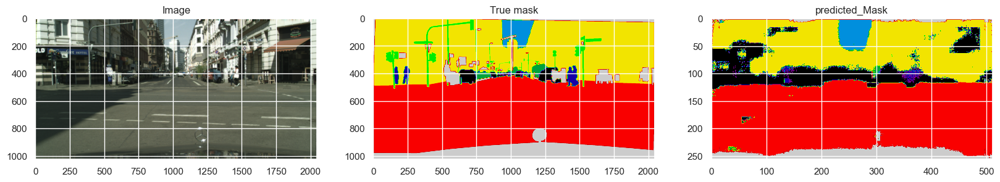

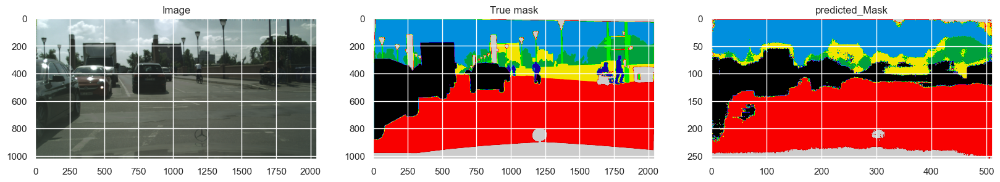

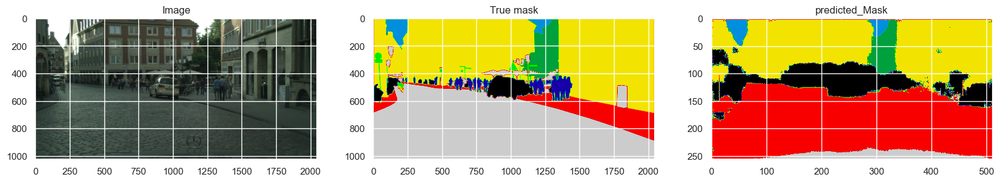

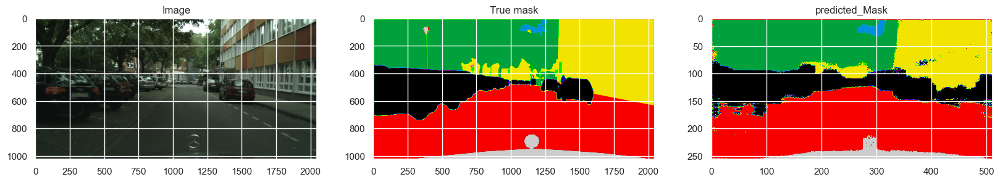

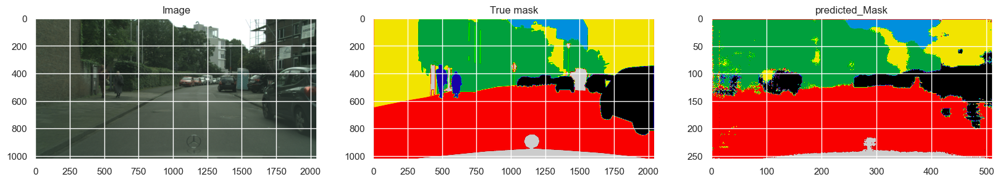

In [71]:
# Plot image, mask and prediction
plot_image_mask_prediction(vgg_fcn, test_input_path, test_target_path, 
                           img_height, img_width, random=True, n=5)

### Test du modèle VGG16_SegNet du projet image-segmentation-keras

In [72]:
model_name= 'vgg_segnet'
vgg_segnet = vgg_segnet(n_classes=8 , input_height=256, input_width=512)

In [73]:
# Set checkpoints
callbacks = [ModelCheckpoint(checkpoint_path +f'/{model_name}.h5', 
                             save_best_only=True)]
start_train = time()

hist_vgg_segnet = vgg_segnet.train(
    train_images =  "datas/images/train_clean",
    train_annotations = "datas/masks/train_clean_normalized",
    input_height=img_height,
    input_width=img_width,
    n_classes=8,
    val_images="datas/images/val_clean",
    val_annotations="datas/masks/val_clean_normalized",
    validate=True,
    do_augment=True, # enable augmentation
    checkpoints_path = "tmp/vgg_segnet_1" , epochs=5
)
training_time = time() - start_train

# Save the model
vgg_segnet.save('vgg_segnet.h5')

Verifying training dataset


100%|██████████████████████████████████████████████████████████████████████████████| 2380/2380 [02:22<00:00, 16.74it/s]


Dataset verified! 
Verifying validation dataset


100%|████████████████████████████████████████████████████████████████████████████████| 595/595 [00:35<00:00, 16.80it/s]


Dataset verified! 
Epoch 1/5
512/512 [==============================] - ETA: 0s - loss: 1.3175 - accuracy: 0.5349 - mean_io_u_2: 0.4375
Epoch 1: saving model to tmp\vgg_segnet_1.00001
512/512 [==============================] - 734s 1s/step - loss: 1.3175 - accuracy: 0.5349 - mean_io_u_2: 0.4375 - val_loss: 3.0655 - val_accuracy: 0.2437 - val_mean_io_u_2: 0.4375
Epoch 2/5
512/512 [==============================] - ETA: 0s - loss: 1.1828 - accuracy: 0.5749 - mean_io_u_2: 0.4375
Epoch 2: saving model to tmp\vgg_segnet_1.00002
512/512 [==============================] - 717s 1s/step - loss: 1.1828 - accuracy: 0.5749 - mean_io_u_2: 0.4375 - val_loss: 1.4011 - val_accuracy: 0.5155 - val_mean_io_u_2: 0.4375
Epoch 3/5
512/512 [==============================] - ETA: 0s - loss: 1.0843 - accuracy: 0.6151 - mean_io_u_2: 0.4375
Epoch 3: saving model to tmp\vgg_segnet_1.00003
512/512 [==============================] - 750s 1s/step - loss: 1.0843 - accuracy: 0.6151 - mean_io_u_2: 0.4375 - val_loss: 0.

In [74]:
hist_vgg_segnet.history

{'loss': [1.3174656629562378,
  1.1828336715698242,
  1.0843100547790527,
  1.046738862991333,
  0.9876366853713989],
 'accuracy': [0.5348987579345703,
  0.5749346613883972,
  0.6151422262191772,
  0.6389344930648804,
  0.6636230945587158],
 'mean_io_u_2': [0.4375, 0.4375, 0.4375, 0.4375, 0.4375],
 'val_loss': [3.0654611587524414,
  1.4011098146438599,
  0.9273058176040649,
  1.567638635635376,
  1.0641111135482788],
 'val_accuracy': [0.24371442198753357,
  0.5154942274093628,
  0.703434944152832,
  0.5740582942962646,
  0.6651548147201538],
 'val_mean_io_u_2': [0.4375, 0.4375, 0.4375, 0.4375024139881134, 0.4375]}

[]

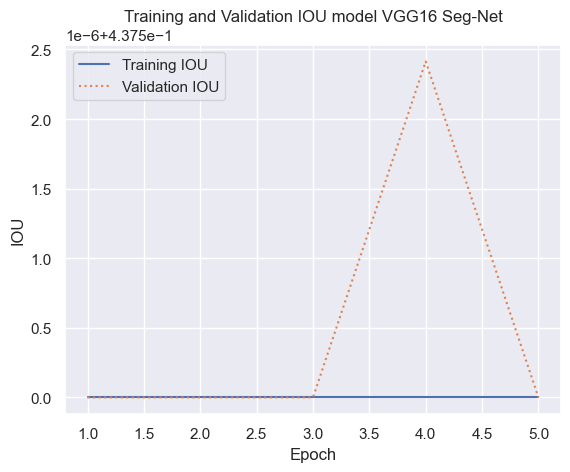

In [75]:
# Affichage des courbes pour le mean_IOU d'entraînement et de validation
sns.set()
acc = hist_vgg_segnet.history['mean_io_u_2']
val = hist_vgg_segnet.history['val_mean_io_u_2']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training IOU')
plt.plot(epochs, val, ':', label='Validation IOU')
plt.title('Training and Validation IOU model VGG16 Seg-Net')
plt.xlabel('Epoch')
plt.ylabel('IOU')
plt.legend(loc='upper left')
plt.plot()

[]

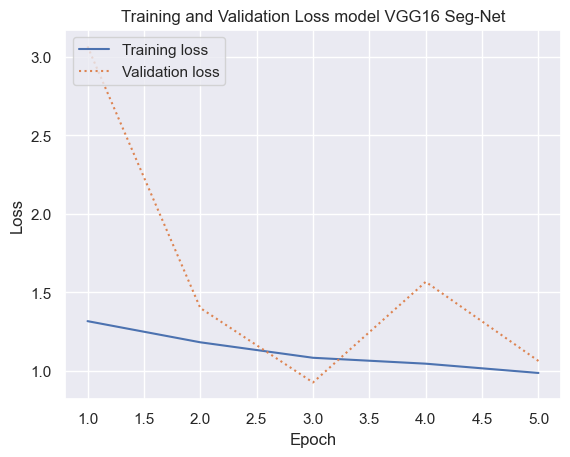

In [76]:
# Affichage des courbes pour la perte d’entraînement et pour la perte de validation 
sns.set()
acc = hist_vgg_segnet.history['loss']
val = hist_vgg_segnet.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training loss')
plt.plot(epochs, val, ':', label='Validation loss')
plt.title('Training and Validation Loss model VGG16 Seg-Net')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.plot()

In [77]:
start_eval = time()
score_vgg_segnet = vgg_segnet.evaluate_segmentation(inp_images_dir=test_input_dir , annotations_dir=test_target_dir)
eval_time = time() - start_eval
score_vgg_segnet

0it [00:00, ?it/s]

1/1 [==============================] - 1s 833ms/step


1it [00:01,  1.02s/it]

1/1 [==============================] - 0s 25ms/step


2it [00:01,  1.92it/s]

1/1 [==============================] - 0s 25ms/step


3it [00:01,  2.75it/s]

1/1 [==============================] - 0s 25ms/step


4it [00:01,  3.41it/s]

1/1 [==============================] - 0s 23ms/step


5it [00:01,  4.03it/s]

1/1 [==============================] - 0s 27ms/step


6it [00:01,  4.43it/s]

1/1 [==============================] - 0s 22ms/step


7it [00:02,  4.81it/s]

1/1 [==============================] - 0s 23ms/step


8it [00:02,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


9it [00:02,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


10it [00:02,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


11it [00:02,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


12it [00:02,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


13it [00:03,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


14it [00:03,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


15it [00:03,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


16it [00:03,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


17it [00:03,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


18it [00:03,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


19it [00:04,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


20it [00:04,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


21it [00:04,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


22it [00:04,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


23it [00:04,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


24it [00:04,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


25it [00:05,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


26it [00:05,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


27it [00:05,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


28it [00:05,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


29it [00:05,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


30it [00:05,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


31it [00:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


32it [00:06,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


33it [00:06,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


34it [00:06,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


35it [00:06,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


36it [00:06,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


37it [00:07,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


38it [00:07,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


39it [00:07,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


40it [00:07,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


41it [00:07,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


42it [00:07,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


43it [00:08,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


44it [00:08,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


45it [00:08,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


46it [00:08,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


47it [00:08,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


48it [00:08,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


49it [00:09,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


50it [00:09,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


51it [00:09,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


52it [00:09,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


53it [00:09,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


54it [00:09,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


55it [00:10,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


56it [00:10,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


57it [00:10,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


58it [00:10,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


59it [00:10,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


60it [00:10,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


61it [00:11,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


62it [00:11,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


63it [00:11,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


64it [00:11,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


65it [00:11,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


66it [00:12,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


67it [00:12,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


68it [00:12,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


69it [00:12,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


70it [00:12,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


71it [00:12,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


72it [00:13,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


73it [00:13,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


74it [00:13,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


75it [00:13,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


76it [00:13,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


77it [00:13,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


78it [00:14,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


79it [00:14,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


80it [00:14,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


81it [00:14,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


82it [00:14,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


83it [00:14,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


84it [00:15,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


85it [00:15,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


86it [00:15,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


87it [00:15,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


88it [00:15,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


89it [00:15,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


90it [00:16,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


91it [00:16,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


92it [00:16,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


93it [00:16,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


94it [00:16,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


95it [00:16,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


96it [00:17,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


97it [00:17,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


98it [00:17,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


99it [00:17,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


100it [00:17,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


101it [00:17,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


102it [00:18,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


103it [00:18,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


104it [00:18,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


105it [00:18,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


106it [00:18,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


107it [00:18,  6.11it/s]

1/1 [==============================] - 0s 30ms/step


108it [00:19,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


109it [00:19,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


110it [00:19,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


111it [00:19,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


112it [00:19,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


113it [00:19,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


114it [00:20,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


115it [00:20,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


116it [00:20,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


117it [00:20,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


118it [00:20,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


119it [00:20,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


120it [00:21,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


121it [00:21,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


122it [00:21,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


123it [00:21,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


124it [00:21,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


125it [00:21,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


126it [00:22,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


127it [00:22,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


128it [00:22,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


129it [00:22,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


130it [00:22,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


131it [00:22,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


132it [00:23,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


133it [00:23,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


134it [00:23,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


135it [00:23,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


136it [00:23,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


137it [00:23,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


138it [00:24,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


139it [00:24,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


140it [00:24,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


141it [00:24,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


142it [00:24,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


143it [00:24,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


144it [00:25,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


145it [00:25,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


146it [00:25,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


147it [00:25,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


148it [00:25,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


149it [00:25,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


150it [00:26,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


151it [00:26,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


152it [00:26,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


153it [00:26,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


154it [00:26,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


155it [00:26,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


156it [00:27,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


157it [00:27,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


158it [00:27,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


159it [00:27,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


160it [00:27,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


161it [00:27,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


162it [00:28,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


163it [00:28,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


164it [00:28,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


165it [00:28,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


166it [00:28,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


167it [00:28,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


168it [00:29,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


169it [00:29,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


170it [00:29,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


171it [00:29,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


172it [00:29,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


173it [00:29,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


174it [00:30,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


175it [00:30,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


176it [00:30,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


177it [00:30,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


178it [00:30,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


179it [00:30,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


180it [00:31,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


181it [00:31,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


182it [00:31,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


183it [00:31,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


184it [00:31,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


185it [00:31,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


186it [00:32,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


187it [00:32,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


188it [00:32,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


189it [00:32,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


190it [00:32,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


191it [00:32,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


192it [00:33,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


193it [00:33,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


194it [00:33,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


195it [00:33,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


196it [00:33,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


197it [00:33,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


198it [00:34,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


199it [00:34,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


200it [00:34,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


201it [00:34,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


202it [00:34,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


203it [00:34,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


204it [00:35,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


205it [00:35,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


206it [00:35,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


207it [00:35,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


208it [00:35,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


209it [00:35,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


210it [00:36,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


211it [00:36,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


212it [00:36,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


213it [00:36,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


214it [00:36,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


215it [00:36,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


216it [00:37,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


217it [00:37,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


218it [00:37,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


219it [00:37,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


220it [00:37,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


221it [00:37,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


222it [00:38,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


223it [00:38,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


224it [00:38,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


225it [00:38,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


226it [00:38,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


227it [00:38,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


228it [00:39,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


229it [00:39,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


230it [00:39,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


231it [00:39,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


232it [00:39,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


233it [00:39,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


234it [00:40,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


235it [00:40,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


236it [00:40,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


237it [00:40,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


238it [00:40,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


239it [00:40,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


240it [00:41,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


241it [00:41,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


242it [00:41,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


243it [00:41,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


244it [00:41,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


245it [00:41,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


246it [00:42,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


247it [00:42,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


248it [00:42,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


249it [00:42,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


250it [00:42,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


251it [00:43,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


252it [00:43,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


253it [00:43,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


254it [00:43,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


255it [00:43,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


256it [00:43,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


257it [00:44,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


258it [00:44,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


259it [00:44,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


260it [00:44,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


261it [00:44,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


262it [00:44,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


263it [00:45,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


264it [00:45,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


265it [00:45,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


266it [00:45,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


267it [00:45,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


268it [00:46,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


269it [00:46,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


270it [00:46,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


271it [00:46,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


272it [00:46,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


273it [00:46,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


274it [00:47,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


275it [00:47,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


276it [00:47,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


277it [00:47,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


278it [00:47,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


279it [00:47,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


280it [00:48,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


281it [00:48,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


282it [00:48,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


283it [00:48,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


284it [00:48,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


285it [00:48,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


286it [00:48,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


287it [00:49,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


288it [00:49,  5.96it/s]

1/1 [==============================] - 0s 30ms/step


289it [00:49,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


290it [00:49,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


291it [00:49,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


292it [00:50,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


293it [00:50,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


294it [00:50,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


295it [00:50,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


296it [00:50,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


297it [00:50,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


298it [00:51,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


299it [00:51,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


300it [00:51,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


301it [00:51,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


302it [00:51,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


303it [00:51,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


304it [00:52,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


305it [00:52,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


306it [00:52,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


307it [00:52,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


308it [00:52,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


309it [00:52,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


310it [00:53,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


311it [00:53,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


312it [00:53,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


313it [00:53,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


314it [00:53,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


315it [00:53,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


316it [00:54,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


317it [00:54,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


318it [00:54,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


319it [00:54,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


320it [00:54,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


321it [00:54,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


322it [00:55,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


323it [00:55,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


324it [00:55,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


325it [00:55,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


326it [00:55,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


327it [00:55,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


328it [00:56,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


329it [00:56,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


330it [00:56,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


331it [00:56,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


332it [00:56,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


333it [00:56,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


334it [00:57,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


335it [00:57,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


336it [00:57,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


337it [00:57,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


338it [00:57,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


339it [00:57,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


340it [00:58,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


341it [00:58,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


342it [00:58,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


343it [00:58,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


344it [00:58,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


345it [00:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


346it [00:59,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


347it [00:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


348it [00:59,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


349it [00:59,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


350it [00:59,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


351it [00:59,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


352it [01:00,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


353it [01:00,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


354it [01:00,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


355it [01:00,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


356it [01:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


357it [01:00,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


358it [01:01,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


359it [01:01,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


360it [01:01,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


361it [01:01,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


362it [01:01,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


363it [01:01,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


364it [01:01,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


365it [01:02,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


366it [01:02,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


367it [01:02,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


368it [01:02,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


369it [01:02,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


370it [01:02,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


371it [01:03,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


372it [01:03,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


373it [01:03,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


374it [01:03,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


375it [01:03,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


376it [01:04,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


377it [01:04,  5.71it/s]

1/1 [==============================] - 0s 29ms/step


378it [01:04,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


379it [01:04,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


380it [01:04,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


381it [01:04,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


382it [01:05,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


383it [01:05,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


384it [01:05,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


385it [01:05,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


386it [01:05,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


387it [01:05,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


388it [01:06,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


389it [01:06,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


390it [01:06,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


391it [01:06,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


392it [01:06,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


393it [01:06,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


394it [01:07,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


395it [01:07,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


396it [01:07,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


397it [01:07,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


398it [01:07,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


399it [01:07,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


400it [01:08,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


401it [01:08,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


402it [01:08,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


403it [01:08,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


404it [01:08,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


405it [01:08,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


406it [01:09,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


407it [01:09,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


408it [01:09,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


409it [01:09,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


410it [01:09,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


411it [01:09,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


412it [01:10,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


413it [01:10,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


414it [01:10,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


415it [01:10,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


416it [01:10,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


417it [01:10,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


418it [01:11,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


419it [01:11,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


420it [01:11,  6.14it/s]

1/1 [==============================] - 0s 27ms/step


421it [01:11,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


422it [01:11,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


423it [01:11,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


424it [01:12,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


425it [01:12,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


426it [01:12,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


427it [01:12,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


428it [01:12,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


429it [01:12,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


430it [01:13,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


431it [01:13,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


432it [01:13,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


433it [01:13,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


434it [01:13,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


435it [01:13,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


436it [01:14,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


437it [01:14,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


438it [01:14,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


439it [01:14,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


440it [01:14,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


441it [01:14,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


442it [01:15,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


443it [01:15,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


444it [01:15,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


445it [01:15,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


446it [01:15,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


447it [01:15,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


448it [01:16,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


449it [01:16,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


450it [01:16,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


451it [01:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


452it [01:16,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


453it [01:16,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


454it [01:17,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


455it [01:17,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


456it [01:17,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


457it [01:17,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


458it [01:17,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


459it [01:17,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


460it [01:18,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


461it [01:18,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


462it [01:18,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


463it [01:18,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


464it [01:18,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


465it [01:18,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


466it [01:19,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


467it [01:19,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


468it [01:19,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


469it [01:19,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


470it [01:19,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


471it [01:19,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


472it [01:20,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


473it [01:20,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


474it [01:20,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


475it [01:20,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


476it [01:20,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


477it [01:20,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


478it [01:21,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


479it [01:21,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


480it [01:21,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


481it [01:21,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


482it [01:21,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


483it [01:21,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


484it [01:22,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


485it [01:22,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


486it [01:22,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


487it [01:22,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


488it [01:22,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


489it [01:22,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


490it [01:23,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


491it [01:23,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


492it [01:23,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


493it [01:23,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


494it [01:23,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


495it [01:23,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


496it [01:23,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


497it [01:24,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


498it [01:24,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


499it [01:24,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


500it [01:24,  5.91it/s]


{'frequency_weighted_IU': 0.48584764539057174,
 'mean_IU': 0.31385628445239,
 'class_wise_IU': array([3.07959801e-01, 6.77409936e-01, 3.94808356e-01, 0.00000000e+00,
        5.22693461e-01, 4.09357218e-01, 1.10420472e-04, 1.98511083e-01])}

In [78]:
# Insertion du score d'évaluation pour le modèle VGG16 Segnet
tab_compare.append(['VGG16 Segnet', score_vgg_segnet['mean_IU'], hist_vgg_segnet.history['loss'],training_time,eval_time])

[ 76 329 378 364 123]
1/1 [==============================] - 0s 25ms/step


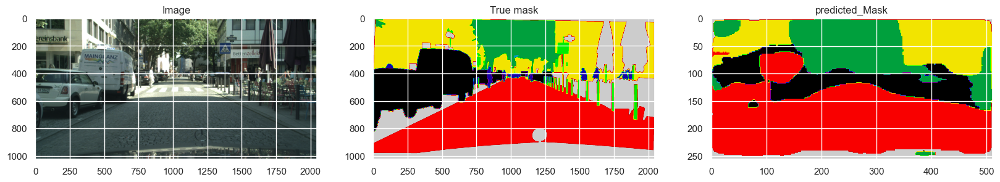

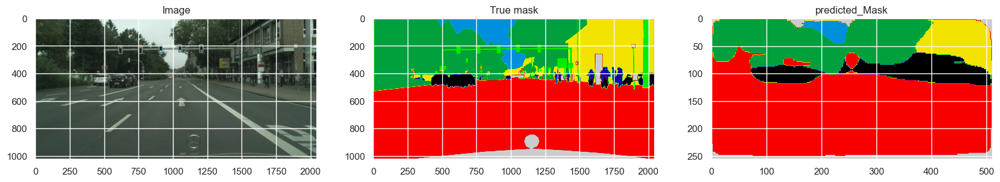

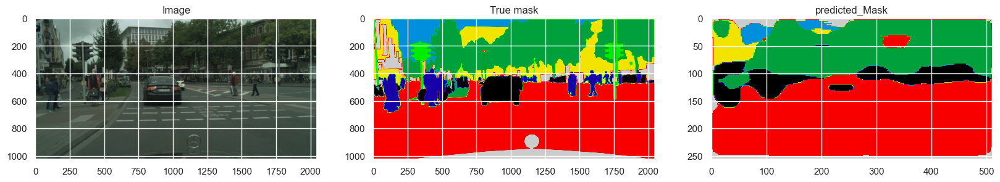

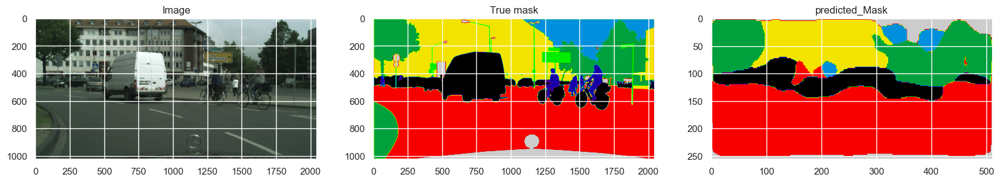

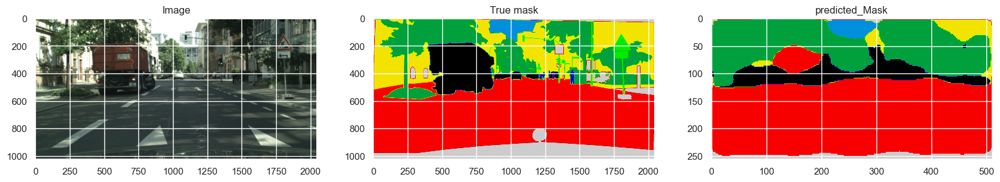

In [79]:
# Plot image, mask and prediction
plot_image_mask_prediction(vgg_segnet, test_input_path, test_target_path, 
                           img_height, img_width, random=True, n=5)

## Test des modèles resnet50

### Test du modèle resnet50_U-Net du projet image-segmentation-keras

In [80]:
model_name= 'resnet50_unet'
resnet50_unet = resnet50_unet(n_classes=8 , input_height=256, input_width=512)

In [81]:
# Set checkpoints
callbacks = [ModelCheckpoint(checkpoint_path +f'/{model_name}.h5', 
                             save_best_only=True)]
start_train = time()

hist_resnet50_unet = resnet50_unet.train(
    train_images =  "datas/images/train_clean",
    train_annotations = "datas/masks/train_clean_normalized",
    input_height=img_height,
    input_width=img_width,
    n_classes=8,
    val_images="datas/images/val_clean",
    val_annotations="datas/masks/val_clean_normalized",
    validate=True,
    do_augment=True, # enable augmentation
    checkpoints_path = "tmp/resnet50_unet_1" , epochs=5
)
training_time = time() - start_train

# Save the model
resnet50_unet.save('resnet50_unet.h5')

Verifying training dataset


100%|██████████████████████████████████████████████████████████████████████████████| 2380/2380 [02:23<00:00, 16.61it/s]


Dataset verified! 
Verifying validation dataset


100%|████████████████████████████████████████████████████████████████████████████████| 595/595 [00:35<00:00, 16.60it/s]


Dataset verified! 
Epoch 1/5
512/512 [==============================] - ETA: 0s - loss: 1.0705 - accuracy: 0.6532 - mean_io_u_3: 0.4375
Epoch 1: saving model to tmp\resnet50_unet_1.00001
512/512 [==============================] - 2342s 5s/step - loss: 1.0705 - accuracy: 0.6532 - mean_io_u_3: 0.4375 - val_loss: 0.7381 - val_accuracy: 0.7658 - val_mean_io_u_3: 0.4375
Epoch 2/5
512/512 [==============================] - ETA: 0s - loss: 0.8007 - accuracy: 0.7362 - mean_io_u_3: 0.4375
Epoch 2: saving model to tmp\resnet50_unet_1.00002
512/512 [==============================] - 2495s 5s/step - loss: 0.8007 - accuracy: 0.7362 - mean_io_u_3: 0.4375 - val_loss: 1.2439 - val_accuracy: 0.6388 - val_mean_io_u_3: 0.4375
Epoch 3/5
512/512 [==============================] - ETA: 0s - loss: 0.7559 - accuracy: 0.7540 - mean_io_u_3: 0.4375
Epoch 3: saving model to tmp\resnet50_unet_1.00003
512/512 [==============================] - 1008s 2s/step - loss: 0.7559 - accuracy: 0.7540 - mean_io_u_3: 0.4375 - 

In [82]:
hist_resnet50_unet.history

{'loss': [1.0705024003982544,
  0.8006688356399536,
  0.7558839917182922,
  0.700240969657898,
  0.6649866104125977],
 'accuracy': [0.653214693069458,
  0.736182689666748,
  0.7540357112884521,
  0.7715598940849304,
  0.7828711271286011],
 'mean_io_u_3': [0.43750208616256714,
  0.43750470876693726,
  0.4375060200691223,
  0.43750566244125366,
  0.43750518560409546],
 'val_loss': [0.7381189465522766,
  1.2439125776290894,
  0.6576237082481384,
  0.8389827013015747,
  0.5659285187721252],
 'val_accuracy': [0.7657917737960815,
  0.6387918591499329,
  0.7950623035430908,
  0.7304754257202148,
  0.8277909755706787],
 'val_mean_io_u_3': [0.4375, 0.4375, 0.4375, 0.4375, 0.4375]}

[]

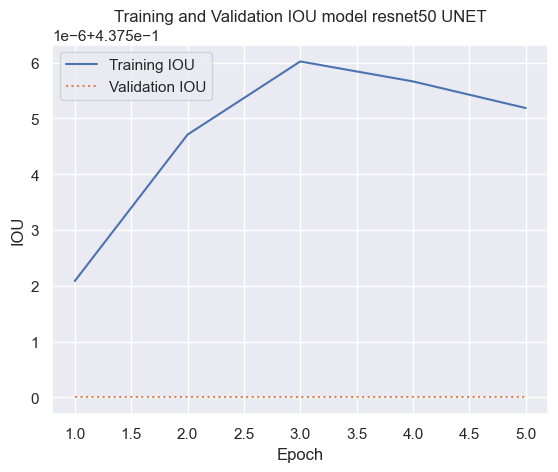

In [83]:
# Affichage des courbes pour le mean_IOU d'entraînement et de validation
sns.set()
acc = hist_resnet50_unet.history['mean_io_u_3']
val = hist_resnet50_unet.history['val_mean_io_u_3']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training IOU')
plt.plot(epochs, val, ':', label='Validation IOU')
plt.title('Training and Validation IOU model resnet50 UNET')
plt.xlabel('Epoch')
plt.ylabel('IOU')
plt.legend(loc='upper left')
plt.plot()

[]

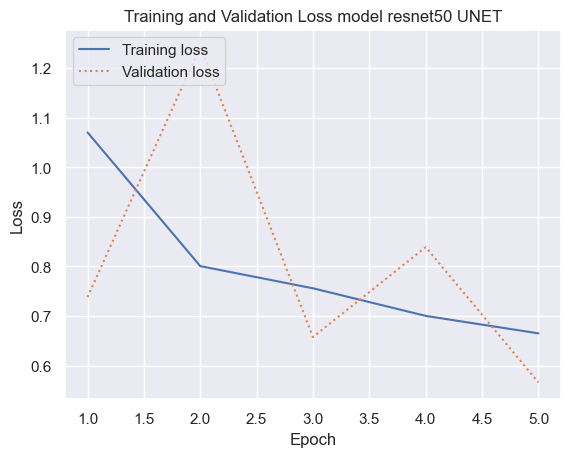

In [84]:
# Affichage des courbes pour la perte d’entraînement et pour la perte de validation 
sns.set()
acc = hist_resnet50_unet.history['loss']
val = hist_resnet50_unet.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training loss')
plt.plot(epochs, val, ':', label='Validation loss')
plt.title('Training and Validation Loss model resnet50 UNET')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.plot()

In [85]:
start_eval = time()
score_resnet50_unet = resnet50_unet.evaluate_segmentation(inp_images_dir=test_input_dir , annotations_dir=test_target_dir)
eval_time = time() - start_eval
score_resnet50_unet

0it [00:00, ?it/s]

1/1 [==============================] - 1s 1s/step


1it [00:01,  1.65s/it]

1/1 [==============================] - 0s 24ms/step


2it [00:01,  1.31it/s]

1/1 [==============================] - 0s 23ms/step


3it [00:01,  2.07it/s]

1/1 [==============================] - 0s 24ms/step


4it [00:02,  2.86it/s]

1/1 [==============================] - 0s 24ms/step


5it [00:02,  3.63it/s]

1/1 [==============================] - 0s 23ms/step


6it [00:02,  4.32it/s]

1/1 [==============================] - 0s 24ms/step


7it [00:02,  4.90it/s]

1/1 [==============================] - 0s 23ms/step


8it [00:02,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


9it [00:02,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


10it [00:02,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


11it [00:03,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


12it [00:03,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


13it [00:03,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


14it [00:03,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


15it [00:03,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


16it [00:03,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


17it [00:04,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


18it [00:04,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


19it [00:04,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


20it [00:04,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


21it [00:04,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


22it [00:04,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


23it [00:05,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


24it [00:05,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


25it [00:05,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


26it [00:05,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


27it [00:05,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


28it [00:05,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


29it [00:06,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


30it [00:06,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


31it [00:06,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


32it [00:06,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


33it [00:06,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


34it [00:06,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


35it [00:07,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


36it [00:07,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


37it [00:07,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


38it [00:07,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


39it [00:07,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


40it [00:08,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


41it [00:08,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


42it [00:08,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


43it [00:08,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


44it [00:08,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


45it [00:08,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


46it [00:09,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


47it [00:09,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


48it [00:09,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


49it [00:09,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


50it [00:09,  4.96it/s]

1/1 [==============================] - 0s 25ms/step


51it [00:10,  4.85it/s]

1/1 [==============================] - 0s 24ms/step


52it [00:10,  4.79it/s]

1/1 [==============================] - 0s 23ms/step


53it [00:10,  4.78it/s]

1/1 [==============================] - 0s 24ms/step


54it [00:10,  4.72it/s]

1/1 [==============================] - 0s 23ms/step


55it [00:11,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


56it [00:11,  4.74it/s]

1/1 [==============================] - 0s 24ms/step


57it [00:11,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


58it [00:11,  4.66it/s]

1/1 [==============================] - 0s 24ms/step


59it [00:11,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


60it [00:12,  4.63it/s]

1/1 [==============================] - 0s 23ms/step


61it [00:12,  4.69it/s]

1/1 [==============================] - 0s 22ms/step


62it [00:12,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


63it [00:12,  4.77it/s]

1/1 [==============================] - 0s 21ms/step


64it [00:12,  4.73it/s]

1/1 [==============================] - 0s 23ms/step


65it [00:13,  4.78it/s]

1/1 [==============================] - 0s 22ms/step


66it [00:13,  4.77it/s]

1/1 [==============================] - 0s 22ms/step


67it [00:13,  4.82it/s]

1/1 [==============================] - 0s 23ms/step


68it [00:13,  4.70it/s]

1/1 [==============================] - 0s 22ms/step


69it [00:13,  4.70it/s]

1/1 [==============================] - 0s 22ms/step


70it [00:14,  4.79it/s]

1/1 [==============================] - 0s 24ms/step


71it [00:14,  4.77it/s]

1/1 [==============================] - 0s 24ms/step


72it [00:14,  4.73it/s]

1/1 [==============================] - 0s 24ms/step


73it [00:14,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


74it [00:14,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


75it [00:15,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


76it [00:15,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


77it [00:15,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


78it [00:15,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


79it [00:15,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


80it [00:15,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


81it [00:15,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


82it [00:16,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


83it [00:16,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


84it [00:16,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


85it [00:16,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


86it [00:16,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


87it [00:16,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


88it [00:17,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


89it [00:17,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


90it [00:17,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


91it [00:17,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


92it [00:17,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


93it [00:17,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


94it [00:18,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


95it [00:18,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


96it [00:18,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


97it [00:18,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


98it [00:18,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


99it [00:18,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


100it [00:19,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


101it [00:19,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


102it [00:19,  4.90it/s]

1/1 [==============================] - 0s 22ms/step


103it [00:19,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


104it [00:20,  4.74it/s]

1/1 [==============================] - 0s 24ms/step


105it [00:20,  4.72it/s]

1/1 [==============================] - 0s 23ms/step


106it [00:20,  4.75it/s]

1/1 [==============================] - 0s 22ms/step


107it [00:20,  4.71it/s]

1/1 [==============================] - 0s 22ms/step


108it [00:20,  4.76it/s]

1/1 [==============================] - 0s 23ms/step


109it [00:21,  4.75it/s]

1/1 [==============================] - 0s 21ms/step


110it [00:21,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


111it [00:21,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


112it [00:21,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


113it [00:21,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


114it [00:21,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


115it [00:22,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


116it [00:22,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


117it [00:22,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


118it [00:22,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


119it [00:22,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


120it [00:22,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


121it [00:22,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


122it [00:23,  6.62it/s]

1/1 [==============================] - 0s 23ms/step


123it [00:23,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


124it [00:23,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


125it [00:23,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


126it [00:23,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


127it [00:23,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


128it [00:24,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


129it [00:24,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


130it [00:24,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


131it [00:24,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


132it [00:24,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


133it [00:25,  4.94it/s]

1/1 [==============================] - 0s 22ms/step


134it [00:25,  4.87it/s]

1/1 [==============================] - 0s 23ms/step


135it [00:25,  4.75it/s]

1/1 [==============================] - 0s 21ms/step


136it [00:25,  4.75it/s]

1/1 [==============================] - 0s 22ms/step


137it [00:25,  4.72it/s]

1/1 [==============================] - 0s 22ms/step


138it [00:26,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


139it [00:26,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


140it [00:26,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


141it [00:26,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


142it [00:26,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


143it [00:26,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


144it [00:27,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


145it [00:27,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


146it [00:27,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


147it [00:27,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


148it [00:27,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


149it [00:27,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


150it [00:27,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


151it [00:28,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


152it [00:28,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


153it [00:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


154it [00:28,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


155it [00:28,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


156it [00:28,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


157it [00:29,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


158it [00:29,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


159it [00:29,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


160it [00:29,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


161it [00:29,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


162it [00:30,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


163it [00:30,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


164it [00:30,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


165it [00:30,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


166it [00:30,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


167it [00:31,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


168it [00:31,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


169it [00:31,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


170it [00:31,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


171it [00:31,  5.04it/s]

1/1 [==============================] - 0s 25ms/step


172it [00:32,  4.53it/s]

1/1 [==============================] - 0s 22ms/step


173it [00:32,  4.60it/s]

1/1 [==============================] - 0s 22ms/step


174it [00:32,  4.59it/s]

1/1 [==============================] - 0s 22ms/step


175it [00:32,  4.65it/s]

1/1 [==============================] - 0s 21ms/step


176it [00:32,  4.71it/s]

1/1 [==============================] - 0s 23ms/step


177it [00:33,  4.71it/s]

1/1 [==============================] - 0s 22ms/step


178it [00:33,  4.80it/s]

1/1 [==============================] - 0s 22ms/step


179it [00:33,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


180it [00:33,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


181it [00:33,  4.78it/s]

1/1 [==============================] - 0s 21ms/step


182it [00:34,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


183it [00:34,  4.85it/s]

1/1 [==============================] - 0s 23ms/step


184it [00:34,  4.82it/s]

1/1 [==============================] - 0s 23ms/step


185it [00:34,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


186it [00:35,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


187it [00:35,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


188it [00:35,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


189it [00:35,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


190it [00:35,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


191it [00:35,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


192it [00:35,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


193it [00:36,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


194it [00:36,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


195it [00:36,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


196it [00:36,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


197it [00:36,  6.76it/s]

1/1 [==============================] - 0s 22ms/step


198it [00:36,  6.78it/s]

1/1 [==============================] - 0s 23ms/step


199it [00:36,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


200it [00:37,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


201it [00:37,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


202it [00:37,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


203it [00:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


204it [00:37,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


205it [00:37,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


206it [00:38,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


207it [00:38,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


208it [00:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


209it [00:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


210it [00:38,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


211it [00:38,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


212it [00:39,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


213it [00:39,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


214it [00:39,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


215it [00:39,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


216it [00:39,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


217it [00:40,  4.96it/s]

1/1 [==============================] - 0s 22ms/step


218it [00:40,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


219it [00:40,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


220it [00:40,  4.94it/s]

1/1 [==============================] - 0s 23ms/step


221it [00:41,  4.91it/s]

1/1 [==============================] - 0s 21ms/step


222it [00:41,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


223it [00:41,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


224it [00:41,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


225it [00:41,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


226it [00:41,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


227it [00:41,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


228it [00:42,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


229it [00:42,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


230it [00:42,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


231it [00:42,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


232it [00:42,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


233it [00:42,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


234it [00:43,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


235it [00:43,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


236it [00:43,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


237it [00:43,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


238it [00:43,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


239it [00:43,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


240it [00:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


241it [00:44,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


242it [00:44,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


243it [00:44,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


244it [00:44,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


245it [00:44,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


246it [00:45,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


247it [00:45,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


248it [00:45,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


249it [00:45,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


250it [00:45,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


251it [00:46,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


252it [00:46,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


253it [00:46,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


254it [00:46,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


255it [00:46,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


256it [00:47,  4.89it/s]

1/1 [==============================] - 0s 23ms/step


257it [00:47,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


258it [00:47,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


259it [00:47,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


260it [00:47,  4.84it/s]

1/1 [==============================] - 0s 21ms/step


261it [00:48,  4.82it/s]

1/1 [==============================] - 0s 23ms/step


262it [00:48,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


263it [00:48,  4.84it/s]

1/1 [==============================] - 0s 23ms/step


264it [00:48,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


265it [00:48,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


266it [00:49,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


267it [00:49,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


268it [00:49,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


269it [00:49,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


270it [00:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


271it [00:49,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


272it [00:49,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


273it [00:50,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


274it [00:50,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


275it [00:50,  6.71it/s]

1/1 [==============================] - 0s 23ms/step


276it [00:50,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


277it [00:50,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


278it [00:50,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


279it [00:51,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


280it [00:51,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


281it [00:51,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


282it [00:51,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


283it [00:51,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


284it [00:51,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


285it [00:52,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


286it [00:52,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


287it [00:52,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


288it [00:52,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


289it [00:52,  4.93it/s]

1/1 [==============================] - 0s 22ms/step


290it [00:53,  4.95it/s]

1/1 [==============================] - 0s 22ms/step


291it [00:53,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


292it [00:53,  4.94it/s]

1/1 [==============================] - 0s 22ms/step


293it [00:53,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


294it [00:53,  4.83it/s]

1/1 [==============================] - 0s 21ms/step


295it [00:54,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


296it [00:54,  4.80it/s]

1/1 [==============================] - 0s 21ms/step


297it [00:54,  4.83it/s]

1/1 [==============================] - 0s 21ms/step


298it [00:54,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


299it [00:54,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


300it [00:54,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


301it [00:55,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


302it [00:55,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


303it [00:55,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


304it [00:55,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


305it [00:55,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


306it [00:55,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


307it [00:56,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


308it [00:56,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


309it [00:56,  6.65it/s]

1/1 [==============================] - 0s 22ms/step


310it [00:56,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


311it [00:56,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


312it [00:56,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


313it [00:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


314it [00:57,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


315it [00:57,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


316it [00:57,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


317it [00:57,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


318it [00:57,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


319it [00:58,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


320it [00:58,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


321it [00:58,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


322it [00:58,  4.96it/s]

1/1 [==============================] - 0s 22ms/step


323it [00:58,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


324it [00:59,  4.84it/s]

1/1 [==============================] - 0s 23ms/step


325it [00:59,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


326it [00:59,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


327it [00:59,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


328it [00:59,  4.90it/s]

1/1 [==============================] - 0s 22ms/step


329it [01:00,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


330it [01:00,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


331it [01:00,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


332it [01:00,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


333it [01:00,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


334it [01:00,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


335it [01:01,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


336it [01:01,  6.56it/s]

1/1 [==============================] - 0s 24ms/step


337it [01:01,  6.63it/s]

1/1 [==============================] - 0s 23ms/step


338it [01:01,  6.68it/s]

1/1 [==============================] - 0s 22ms/step


339it [01:01,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


340it [01:01,  6.73it/s]

1/1 [==============================] - 0s 21ms/step


341it [01:01,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


342it [01:02,  6.58it/s]

1/1 [==============================] - 0s 23ms/step


343it [01:02,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


344it [01:02,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


345it [01:02,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


346it [01:02,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


347it [01:02,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


348it [01:03,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


349it [01:03,  2.57it/s]

1/1 [==============================] - 0s 22ms/step


350it [01:04,  2.99it/s]

1/1 [==============================] - 0s 22ms/step


351it [01:04,  3.35it/s]

1/1 [==============================] - 0s 23ms/step


352it [01:04,  3.71it/s]

1/1 [==============================] - 0s 22ms/step


353it [01:04,  3.97it/s]

1/1 [==============================] - 0s 22ms/step


354it [01:05,  4.23it/s]

1/1 [==============================] - 0s 22ms/step


355it [01:05,  4.42it/s]

1/1 [==============================] - 0s 21ms/step


356it [01:05,  4.58it/s]

1/1 [==============================] - 0s 22ms/step


357it [01:05,  4.69it/s]

1/1 [==============================] - 0s 21ms/step


358it [01:05,  4.71it/s]

1/1 [==============================] - 0s 22ms/step


359it [01:06,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


360it [01:06,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


361it [01:06,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


362it [01:06,  4.88it/s]

1/1 [==============================] - 0s 23ms/step


363it [01:06,  4.91it/s]

1/1 [==============================] - 0s 25ms/step


364it [01:07,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


365it [01:07,  4.87it/s]

1/1 [==============================] - 0s 21ms/step


366it [01:07,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


367it [01:07,  4.90it/s]

1/1 [==============================] - 0s 22ms/step


368it [01:07,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


369it [01:08,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


370it [01:08,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


371it [01:08,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


372it [01:08,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


373it [01:08,  4.78it/s]

1/1 [==============================] - 0s 22ms/step


374it [01:09,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


375it [01:09,  4.85it/s]

1/1 [==============================] - 0s 23ms/step


376it [01:09,  4.88it/s]

1/1 [==============================] - 0s 23ms/step


377it [01:09,  4.83it/s]

1/1 [==============================] - 0s 21ms/step


378it [01:09,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


379it [01:10,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


380it [01:10,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


381it [01:10,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


382it [01:10,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


383it [01:10,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


384it [01:10,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


385it [01:11,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


386it [01:11,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


387it [01:11,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


388it [01:11,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


389it [01:11,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


390it [01:11,  6.68it/s]

1/1 [==============================] - 0s 23ms/step


391it [01:11,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


392it [01:12,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


393it [01:12,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


394it [01:12,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


395it [01:12,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


396it [01:12,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


397it [01:12,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


398it [01:13,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


399it [01:13,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


400it [01:13,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


401it [01:13,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


402it [01:13,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


403it [01:13,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


404it [01:14,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


405it [01:14,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


406it [01:14,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


407it [01:14,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


408it [01:15,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


409it [01:15,  4.95it/s]

1/1 [==============================] - 0s 22ms/step


410it [01:15,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


411it [01:15,  4.92it/s]

1/1 [==============================] - 0s 23ms/step


412it [01:15,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


413it [01:16,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


414it [01:16,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


415it [01:16,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


416it [01:16,  4.83it/s]

1/1 [==============================] - 0s 24ms/step


417it [01:16,  4.80it/s]

1/1 [==============================] - 0s 22ms/step


418it [01:17,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


419it [01:17,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


420it [01:17,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


421it [01:17,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


422it [01:17,  4.87it/s]

1/1 [==============================] - 0s 23ms/step


423it [01:18,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


424it [01:18,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


425it [01:18,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


426it [01:18,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


427it [01:18,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


428it [01:18,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


429it [01:18,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


430it [01:19,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


431it [01:19,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


432it [01:19,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


433it [01:19,  6.72it/s]

1/1 [==============================] - 0s 22ms/step


434it [01:19,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


435it [01:19,  6.75it/s]

1/1 [==============================] - 0s 22ms/step


436it [01:20,  6.65it/s]

1/1 [==============================] - 0s 24ms/step


437it [01:20,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


438it [01:20,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


439it [01:20,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


440it [01:20,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


441it [01:20,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


442it [01:20,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


443it [01:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


444it [01:21,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


445it [01:21,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


446it [01:21,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


447it [01:21,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


448it [01:22,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


449it [01:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


450it [01:22,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


451it [01:22,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


452it [01:22,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


453it [01:23,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


454it [01:23,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


455it [01:23,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


456it [01:23,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


457it [01:23,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


458it [01:24,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


459it [01:24,  4.95it/s]

1/1 [==============================] - 0s 22ms/step


460it [01:24,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


461it [01:24,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


462it [01:24,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


463it [01:25,  4.79it/s]

1/1 [==============================] - 0s 22ms/step


464it [01:25,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


465it [01:25,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


466it [01:25,  4.83it/s]

1/1 [==============================] - 0s 24ms/step


467it [01:25,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


468it [01:26,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


469it [01:26,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


470it [01:26,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


471it [01:26,  4.81it/s]

1/1 [==============================] - 0s 22ms/step


472it [01:26,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


473it [01:27,  4.84it/s]

1/1 [==============================] - 0s 24ms/step


474it [01:27,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


475it [01:27,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


476it [01:27,  4.91it/s]

1/1 [==============================] - 0s 21ms/step


477it [01:27,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


478it [01:28,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


479it [01:28,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


480it [01:28,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


481it [01:28,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


482it [01:28,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


483it [01:28,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


484it [01:28,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


485it [01:29,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


486it [01:29,  6.63it/s]

1/1 [==============================] - 0s 24ms/step


487it [01:29,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


488it [01:29,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


489it [01:29,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


490it [01:29,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


491it [01:30,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


492it [01:30,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


493it [01:30,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


494it [01:30,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


495it [01:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


496it [01:30,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


497it [01:31,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


498it [01:31,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


499it [01:31,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


500it [01:31,  5.45it/s]


{'frequency_weighted_IU': 0.6897910297500853,
 'mean_IU': 0.49764610195482617,
 'class_wise_IU': array([0.49672409, 0.8590391 , 0.63267197, 0.02892556, 0.69455069,
        0.69117149, 0.00088727, 0.57719864])}

In [86]:
# Insertion du score d'évaluation pour le modèle Resnet50 Unet
tab_compare.append(['Resnet50 Unet', score_resnet50_unet['mean_IU'], hist_resnet50_unet.history['loss'],training_time,eval_time])

[ 96 291 347 446  18]
1/1 [==============================] - 0s 22ms/step


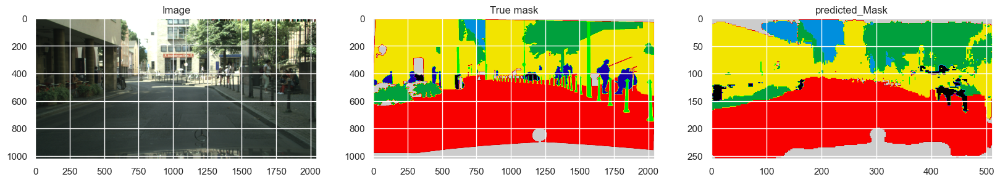

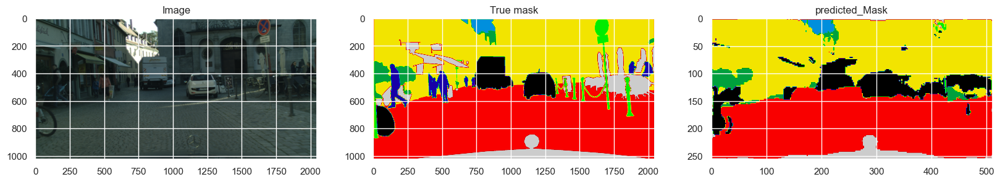

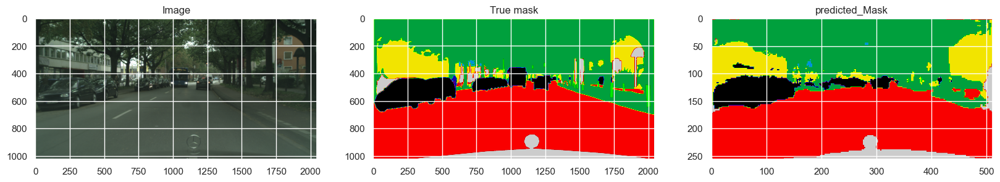

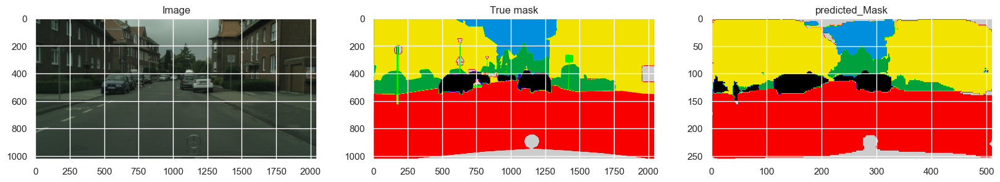

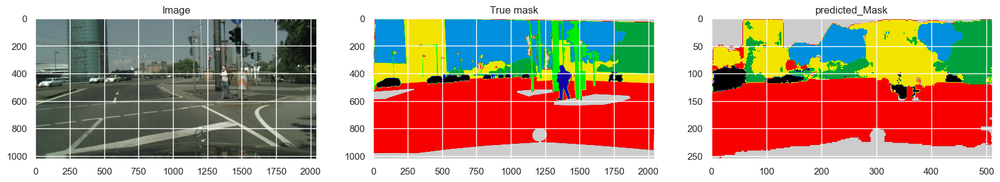

In [87]:
# Plot image, mask and prediction
plot_image_mask_prediction(resnet50_unet, test_input_path, test_target_path, 
                           img_height, img_width, random=True, n=5)

### Test du modèle resnet50_SegNet du projet image-segmentation-keras

In [88]:
model_name= 'resnet50_segnet'
resnet50_segnet = resnet50_segnet(n_classes=8 , input_height=256, input_width=512)

In [89]:
# Set checkpoints
callbacks = [ModelCheckpoint(checkpoint_path +f'/{model_name}.h5', 
                             save_best_only=True)]
start_train = time()

hist_resnet50_segnet = resnet50_segnet.train(
    train_images =  "datas/images/train_clean",
    train_annotations = "datas/masks/train_clean_normalized",
    n_classes=8,
    input_height=img_height,
    input_width=img_width,
    val_images="datas/images/val_clean",
    val_annotations="datas/masks/val_clean_normalized",
    validate=True,
    do_augment=True, # enable augmentation
    checkpoints_path = "tmp/resnet50_segnet_1" , epochs=5
)

training_time = time() - start_train
# Save the model
resnet50_segnet.save('resnet50_segnet.h5')

Verifying training dataset


100%|██████████████████████████████████████████████████████████████████████████████| 2380/2380 [02:10<00:00, 18.22it/s]


Dataset verified! 
Verifying validation dataset


100%|████████████████████████████████████████████████████████████████████████████████| 595/595 [00:32<00:00, 18.50it/s]


Dataset verified! 
Epoch 1/5
512/512 [==============================] - ETA: 0s - loss: 0.9899 - accuracy: 0.6844 - mean_io_u_4: 0.4375
Epoch 1: saving model to tmp\resnet50_segnet_1.00001
512/512 [==============================] - 719s 1s/step - loss: 0.9899 - accuracy: 0.6844 - mean_io_u_4: 0.4375 - val_loss: 1.0486 - val_accuracy: 0.6964 - val_mean_io_u_4: 0.4375
Epoch 2/5
512/512 [==============================] - ETA: 0s - loss: 0.7858 - accuracy: 0.7422 - mean_io_u_4: 0.4375
Epoch 2: saving model to tmp\resnet50_segnet_1.00002
512/512 [==============================] - 2932s 6s/step - loss: 0.7858 - accuracy: 0.7422 - mean_io_u_4: 0.4375 - val_loss: 0.6820 - val_accuracy: 0.7802 - val_mean_io_u_4: 0.4375
Epoch 3/5
512/512 [==============================] - ETA: 0s - loss: 0.6843 - accuracy: 0.7781 - mean_io_u_4: 0.4375
Epoch 3: saving model to tmp\resnet50_segnet_1.00003
512/512 [==============================] - 617s 1s/step - loss: 0.6843 - accuracy: 0.7781 - mean_io_u_4: 0.437

In [90]:
hist_resnet50_segnet.history

{'loss': [0.9899129867553711,
  0.7857523560523987,
  0.6842809915542603,
  0.6662725210189819,
  0.6471371650695801],
 'accuracy': [0.6844471096992493,
  0.7422478199005127,
  0.7781102061271667,
  0.7844575643539429,
  0.7919082641601562],
 'mean_io_u_4': [0.4375,
  0.4375000298023224,
  0.437503457069397,
  0.43751880526542664,
  0.4375172257423401],
 'val_loss': [1.0486273765563965,
  0.6819782853126526,
  0.6462010145187378,
  0.8572622537612915,
  0.5294113755226135],
 'val_accuracy': [0.6964070796966553,
  0.780218243598938,
  0.8137244582176208,
  0.7191781997680664,
  0.8376975059509277],
 'val_mean_io_u_4': [0.4375,
  0.4375,
  0.4375,
  0.4375007450580597,
  0.43758052587509155]}

[]

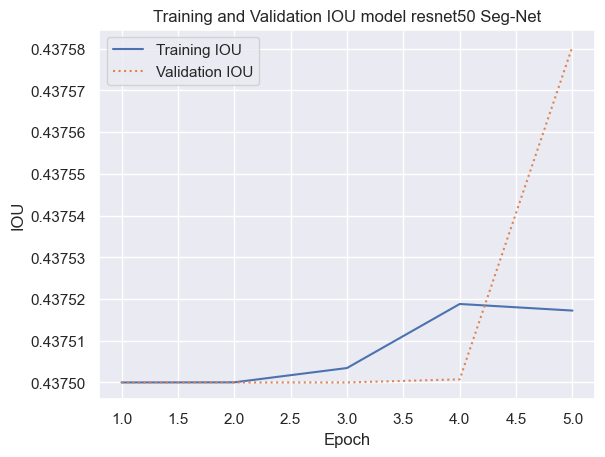

In [91]:
# Affichage des courbes pour le mean_IOU d'entraînement et de validation
sns.set()
acc = hist_resnet50_segnet.history['mean_io_u_4']
val = hist_resnet50_segnet.history['val_mean_io_u_4']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training IOU')
plt.plot(epochs, val, ':', label='Validation IOU')
plt.title('Training and Validation IOU model resnet50 Seg-Net')
plt.xlabel('Epoch')
plt.ylabel('IOU')
plt.legend(loc='upper left')
plt.plot()

[]

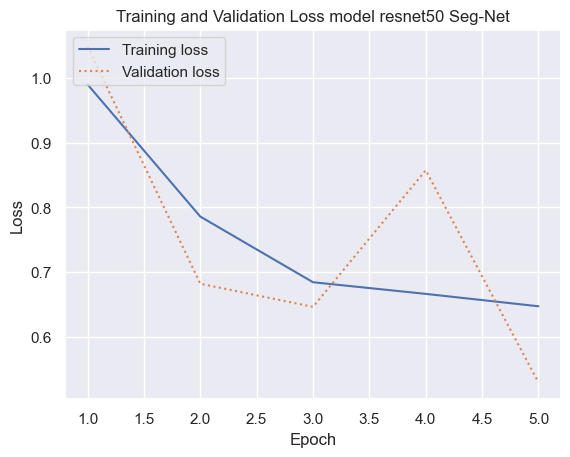

In [92]:
# Affichage des courbes pour la perte d’entraînement et pour la perte de validation 
sns.set()
acc = hist_resnet50_segnet.history['loss']
val = hist_resnet50_segnet.history['val_loss']
epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, '-', label='Training loss')
plt.plot(epochs, val, ':', label='Validation loss')
plt.title('Training and Validation Loss model resnet50 Seg-Net')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.plot()

In [93]:
start_eval = time()
score_resnet50_segnet = resnet50_segnet.evaluate_segmentation(inp_images_dir=test_input_dir , annotations_dir=test_target_dir)
eval_time = time() - start_eval
score_resnet50_segnet

0it [00:00, ?it/s]

1/1 [==============================] - 3s 3s/step


1it [00:03,  3.24s/it]

1/1 [==============================] - 0s 29ms/step


2it [00:03,  1.45s/it]

1/1 [==============================] - 0s 30ms/step


3it [00:03,  1.15it/s]

1/1 [==============================] - 0s 30ms/step


4it [00:03,  1.65it/s]

1/1 [==============================] - 0s 28ms/step


5it [00:03,  2.21it/s]

1/1 [==============================] - 0s 29ms/step


6it [00:04,  2.79it/s]

1/1 [==============================] - 0s 32ms/step


7it [00:04,  3.36it/s]

1/1 [==============================] - 0s 31ms/step


8it [00:06,  1.33it/s]

1/1 [==============================] - 0s 27ms/step


9it [00:06,  1.74it/s]

1/1 [==============================] - 0s 34ms/step


10it [00:06,  2.20it/s]

1/1 [==============================] - 0s 32ms/step


11it [00:06,  2.70it/s]

1/1 [==============================] - 0s 31ms/step


12it [00:06,  3.17it/s]

1/1 [==============================] - 0s 33ms/step


13it [00:07,  3.54it/s]

1/1 [==============================] - 0s 36ms/step


14it [00:07,  3.95it/s]

1/1 [==============================] - 0s 30ms/step


15it [00:07,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


16it [00:07,  4.69it/s]

1/1 [==============================] - 0s 30ms/step


17it [00:07,  4.92it/s]

1/1 [==============================] - 0s 32ms/step


18it [00:07,  5.10it/s]

1/1 [==============================] - 0s 31ms/step


19it [00:08,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


20it [00:08,  5.31it/s]

1/1 [==============================] - 0s 31ms/step


21it [00:08,  5.36it/s]

1/1 [==============================] - 0s 34ms/step


22it [00:08,  5.32it/s]

1/1 [==============================] - 0s 34ms/step


23it [00:08,  5.27it/s]

1/1 [==============================] - 0s 30ms/step


24it [00:09,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


25it [00:09,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


26it [00:09,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


27it [00:09,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


28it [00:09,  5.39it/s]

1/1 [==============================] - 0s 33ms/step


29it [00:09,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


30it [00:10,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


31it [00:10,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


32it [00:10,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


33it [00:10,  5.50it/s]

1/1 [==============================] - 0s 33ms/step


34it [00:13,  1.15it/s]

1/1 [==============================] - 0s 28ms/step


35it [00:13,  1.51it/s]

1/1 [==============================] - 0s 28ms/step


36it [00:13,  1.94it/s]

1/1 [==============================] - 0s 30ms/step


37it [00:13,  2.42it/s]

1/1 [==============================] - 0s 32ms/step


38it [00:14,  2.54it/s]

1/1 [==============================] - 0s 32ms/step


39it [00:14,  3.03it/s]

1/1 [==============================] - 0s 30ms/step


40it [00:14,  3.54it/s]

1/1 [==============================] - 0s 30ms/step


41it [00:14,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


42it [00:14,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


43it [00:14,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


44it [00:15,  5.01it/s]

1/1 [==============================] - 0s 28ms/step


45it [00:15,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


46it [00:15,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


47it [00:15,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


48it [00:15,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


49it [00:15,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


50it [00:16,  5.42it/s]

1/1 [==============================] - 0s 31ms/step


51it [00:16,  5.39it/s]

1/1 [==============================] - 0s 31ms/step


52it [00:16,  5.39it/s]

1/1 [==============================] - 0s 37ms/step


53it [00:16,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


54it [00:16,  5.34it/s]

1/1 [==============================] - 0s 30ms/step


55it [00:17,  3.41it/s]

1/1 [==============================] - 0s 28ms/step


56it [00:17,  3.69it/s]

1/1 [==============================] - 0s 28ms/step


57it [00:17,  4.14it/s]

1/1 [==============================] - 0s 29ms/step


58it [00:17,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


59it [00:18,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


60it [00:18,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


61it [00:18,  5.12it/s]

1/1 [==============================] - 0s 29ms/step


62it [00:19,  3.07it/s]

1/1 [==============================] - 0s 28ms/step


63it [00:19,  3.58it/s]

1/1 [==============================] - 0s 28ms/step


64it [00:19,  3.99it/s]

1/1 [==============================] - 0s 29ms/step


65it [00:19,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


66it [00:19,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


67it [00:20,  4.97it/s]

1/1 [==============================] - 0s 30ms/step


68it [00:20,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


69it [00:20,  5.37it/s]

1/1 [==============================] - 0s 29ms/step


70it [00:20,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


71it [00:20,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


72it [00:20,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


73it [00:21,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


74it [00:21,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


75it [00:21,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


76it [00:21,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


77it [00:21,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


78it [00:21,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


79it [00:22,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


80it [00:22,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


81it [00:22,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


82it [00:23,  2.80it/s]

1/1 [==============================] - 0s 28ms/step


83it [00:23,  3.28it/s]

1/1 [==============================] - 0s 32ms/step


84it [00:23,  3.69it/s]

1/1 [==============================] - 0s 29ms/step


85it [00:23,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


86it [00:24,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


87it [00:26,  1.14it/s]

1/1 [==============================] - 0s 32ms/step


88it [00:26,  1.50it/s]

1/1 [==============================] - 0s 29ms/step


89it [00:28,  1.10s/it]

1/1 [==============================] - 0s 28ms/step


90it [00:28,  1.22it/s]

1/1 [==============================] - 0s 29ms/step


91it [00:29,  1.60it/s]

1/1 [==============================] - 0s 28ms/step


92it [00:29,  2.04it/s]

1/1 [==============================] - 0s 32ms/step


93it [00:30,  1.42it/s]

1/1 [==============================] - 0s 28ms/step


94it [00:30,  1.84it/s]

1/1 [==============================] - 0s 31ms/step


95it [00:30,  2.31it/s]

1/1 [==============================] - 0s 29ms/step


96it [00:30,  2.83it/s]

1/1 [==============================] - 0s 29ms/step


97it [00:31,  3.34it/s]

1/1 [==============================] - 0s 30ms/step


98it [00:31,  3.82it/s]

1/1 [==============================] - 0s 30ms/step


99it [00:31,  4.21it/s]

1/1 [==============================] - 0s 33ms/step


100it [00:31,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


101it [00:31,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


102it [00:31,  5.14it/s]

1/1 [==============================] - 0s 30ms/step


103it [00:32,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


104it [00:32,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


105it [00:32,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


106it [00:35,  1.06it/s]

1/1 [==============================] - 0s 28ms/step


107it [00:35,  1.41it/s]

1/1 [==============================] - 0s 27ms/step


108it [00:35,  1.82it/s]

1/1 [==============================] - 0s 35ms/step


109it [00:35,  2.28it/s]

1/1 [==============================] - 0s 26ms/step


110it [00:35,  2.81it/s]

1/1 [==============================] - 0s 29ms/step


111it [00:36,  3.29it/s]

1/1 [==============================] - 0s 32ms/step


112it [00:36,  3.78it/s]

1/1 [==============================] - 0s 31ms/step


113it [00:36,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


114it [00:36,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


115it [00:36,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


116it [00:36,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


117it [00:37,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


118it [00:37,  5.33it/s]

1/1 [==============================] - 0s 30ms/step


119it [00:37,  5.42it/s]

1/1 [==============================] - 0s 31ms/step


120it [00:37,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


121it [00:37,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


122it [00:38,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


123it [00:38,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


124it [00:38,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


125it [00:38,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


126it [00:38,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


127it [00:38,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


128it [00:42,  1.09s/it]

1/1 [==============================] - 0s 29ms/step


129it [00:42,  1.23it/s]

1/1 [==============================] - 0s 30ms/step


130it [00:42,  1.61it/s]

1/1 [==============================] - 0s 30ms/step


131it [00:42,  2.06it/s]

1/1 [==============================] - 0s 29ms/step


132it [00:42,  2.56it/s]

1/1 [==============================] - 0s 28ms/step


133it [00:42,  3.08it/s]

1/1 [==============================] - 0s 28ms/step


134it [00:43,  3.62it/s]

1/1 [==============================] - 0s 29ms/step


135it [00:43,  4.10it/s]

1/1 [==============================] - 0s 28ms/step


136it [00:43,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


137it [00:43,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


138it [00:43,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


139it [00:43,  5.39it/s]

1/1 [==============================] - 0s 30ms/step


140it [00:44,  2.96it/s]

1/1 [==============================] - 0s 30ms/step


141it [00:44,  3.31it/s]

1/1 [==============================] - 0s 28ms/step


142it [00:45,  3.80it/s]

1/1 [==============================] - 0s 28ms/step


143it [00:45,  4.28it/s]

1/1 [==============================] - 0s 26ms/step


144it [00:45,  2.64it/s]

1/1 [==============================] - 0s 31ms/step


145it [00:46,  3.15it/s]

1/1 [==============================] - 0s 28ms/step


146it [00:46,  3.66it/s]

1/1 [==============================] - 0s 28ms/step


147it [00:46,  4.06it/s]

1/1 [==============================] - 0s 30ms/step


148it [00:46,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


149it [00:52,  1.80s/it]

1/1 [==============================] - 0s 28ms/step


150it [00:52,  1.31s/it]

1/1 [==============================] - 0s 28ms/step


151it [00:52,  1.03it/s]

1/1 [==============================] - 0s 29ms/step


152it [00:52,  1.36it/s]

1/1 [==============================] - 0s 29ms/step


153it [00:52,  1.77it/s]

1/1 [==============================] - 0s 28ms/step


154it [00:52,  2.23it/s]

1/1 [==============================] - 0s 27ms/step


155it [00:53,  1.80it/s]

1/1 [==============================] - 0s 30ms/step


156it [00:53,  2.26it/s]

1/1 [==============================] - 0s 28ms/step


157it [00:54,  2.76it/s]

1/1 [==============================] - 0s 29ms/step


158it [00:54,  3.27it/s]

1/1 [==============================] - 0s 28ms/step


159it [00:54,  3.77it/s]

1/1 [==============================] - 0s 28ms/step


160it [00:54,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


161it [00:54,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


162it [00:55,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


163it [00:55,  5.14it/s]

1/1 [==============================] - 0s 29ms/step


164it [00:55,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


165it [00:55,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


166it [00:55,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


167it [00:56,  4.96it/s]

1/1 [==============================] - 0s 30ms/step


168it [00:56,  5.09it/s]

1/1 [==============================] - 0s 29ms/step


169it [00:56,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


170it [00:56,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


171it [00:56,  5.43it/s]

1/1 [==============================] - 0s 31ms/step


172it [00:56,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


173it [00:57,  5.54it/s]

1/1 [==============================] - 0s 30ms/step


174it [00:57,  5.61it/s]

1/1 [==============================] - 0s 30ms/step


175it [00:58,  2.37it/s]

1/1 [==============================] - 0s 28ms/step


176it [00:58,  2.86it/s]

1/1 [==============================] - 0s 30ms/step


177it [00:58,  3.36it/s]

1/1 [==============================] - 0s 32ms/step


178it [00:58,  3.79it/s]

1/1 [==============================] - 0s 29ms/step


179it [00:58,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


180it [00:59,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


181it [00:59,  4.97it/s]

1/1 [==============================] - 0s 30ms/step


182it [00:59,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


183it [00:59,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


184it [00:59,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


185it [00:59,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


186it [01:00,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


187it [01:00,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


188it [01:00,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


189it [01:00,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


190it [01:00,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


191it [01:01,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


192it [01:01,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


193it [01:01,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


194it [01:01,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


195it [01:01,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


196it [01:01,  5.61it/s]

1/1 [==============================] - 0s 31ms/step


197it [01:02,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


198it [01:02,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


199it [01:02,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


200it [01:02,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


201it [01:02,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


202it [01:03,  4.11it/s]

1/1 [==============================] - 0s 31ms/step


203it [01:03,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


204it [01:03,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


205it [01:03,  4.98it/s]

1/1 [==============================] - 0s 30ms/step


206it [01:03,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


207it [01:04,  5.41it/s]

1/1 [==============================] - 0s 30ms/step


208it [01:04,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


209it [01:04,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


210it [01:04,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


211it [01:04,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


212it [01:04,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


213it [01:05,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


214it [01:05,  3.74it/s]

1/1 [==============================] - 0s 27ms/step


215it [01:05,  4.17it/s]

1/1 [==============================] - 0s 30ms/step


216it [01:05,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


217it [01:06,  4.90it/s]

1/1 [==============================] - 0s 28ms/step


218it [01:06,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


219it [01:06,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


220it [01:06,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


221it [01:06,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


222it [01:07,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


223it [01:07,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


224it [01:07,  5.31it/s]

1/1 [==============================] - 0s 29ms/step


225it [01:07,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


226it [01:07,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


227it [01:07,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


228it [01:08,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


229it [01:08,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


230it [01:08,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


231it [01:09,  2.22it/s]

1/1 [==============================] - 0s 28ms/step


232it [01:09,  2.74it/s]

1/1 [==============================] - 0s 28ms/step


233it [01:09,  3.26it/s]

1/1 [==============================] - 0s 30ms/step


234it [01:10,  3.75it/s]

1/1 [==============================] - 0s 28ms/step


235it [01:10,  4.22it/s]

1/1 [==============================] - 0s 27ms/step


236it [01:10,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


237it [01:10,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


238it [01:10,  5.16it/s]

1/1 [==============================] - 0s 29ms/step


239it [01:10,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


240it [01:11,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


241it [01:11,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


242it [01:11,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


243it [01:11,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


244it [01:11,  5.52it/s]

1/1 [==============================] - 0s 28ms/step


245it [01:11,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


246it [01:12,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


247it [01:12,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


248it [01:12,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


249it [01:12,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


250it [01:12,  5.76it/s]

1/1 [==============================] - 0s 33ms/step


251it [01:13,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


252it [01:13,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


253it [01:13,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


254it [01:13,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


255it [01:15,  1.34it/s]

1/1 [==============================] - 0s 29ms/step


256it [01:15,  1.74it/s]

1/1 [==============================] - 0s 28ms/step


257it [01:15,  2.21it/s]

1/1 [==============================] - 0s 30ms/step


258it [01:16,  2.70it/s]

1/1 [==============================] - 0s 28ms/step


259it [01:16,  3.23it/s]

1/1 [==============================] - 0s 28ms/step


260it [01:16,  3.75it/s]

1/1 [==============================] - 0s 29ms/step


261it [01:16,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


262it [01:16,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


263it [01:17,  4.96it/s]

1/1 [==============================] - 0s 28ms/step


264it [01:17,  5.27it/s]

1/1 [==============================] - 0s 29ms/step


265it [01:17,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


266it [01:17,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


267it [01:17,  5.53it/s]

1/1 [==============================] - 0s 30ms/step


268it [01:17,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


269it [01:18,  5.62it/s]

1/1 [==============================] - 0s 31ms/step


270it [01:18,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


271it [01:18,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


272it [01:18,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


273it [01:18,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


274it [01:18,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


275it [01:19,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


276it [01:19,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


277it [01:19,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


278it [01:19,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


279it [01:19,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


280it [01:19,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


281it [01:20,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


282it [01:20,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


283it [01:20,  5.85it/s]

1/1 [==============================] - 0s 30ms/step


284it [01:20,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


285it [01:20,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


286it [01:20,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


287it [01:21,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


288it [01:21,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


289it [01:21,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


290it [01:21,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


291it [01:21,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


292it [01:22,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


293it [01:22,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


294it [01:22,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


295it [01:22,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


296it [01:22,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


297it [01:22,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


298it [01:23,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


299it [01:23,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


300it [01:23,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


301it [01:24,  3.03it/s]

1/1 [==============================] - 0s 27ms/step


302it [01:24,  3.49it/s]

1/1 [==============================] - 0s 29ms/step


303it [01:24,  3.95it/s]

1/1 [==============================] - 0s 28ms/step


304it [01:24,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


305it [01:24,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


306it [01:24,  5.02it/s]

1/1 [==============================] - 0s 29ms/step


307it [01:25,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


308it [01:25,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


309it [01:25,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


310it [01:25,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


311it [01:25,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


312it [01:25,  5.73it/s]

1/1 [==============================] - 0s 30ms/step


313it [01:26,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


314it [01:26,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


315it [01:26,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


316it [01:26,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


317it [01:27,  4.90it/s]

1/1 [==============================] - 0s 30ms/step


318it [01:27,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


319it [01:27,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


320it [01:27,  5.40it/s]

1/1 [==============================] - 0s 31ms/step


321it [01:27,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


322it [01:27,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


323it [01:28,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


324it [01:28,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


325it [01:28,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


326it [01:28,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


327it [01:28,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


328it [01:30,  1.52it/s]

1/1 [==============================] - 0s 28ms/step


329it [01:30,  1.95it/s]

1/1 [==============================] - 0s 29ms/step


330it [01:30,  2.45it/s]

1/1 [==============================] - 0s 27ms/step


331it [01:31,  2.95it/s]

1/1 [==============================] - 0s 28ms/step


332it [01:31,  3.48it/s]

1/1 [==============================] - 0s 28ms/step


333it [01:31,  3.97it/s]

1/1 [==============================] - 0s 28ms/step


334it [01:31,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


335it [01:31,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


336it [01:31,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


337it [01:32,  5.30it/s]

1/1 [==============================] - 0s 30ms/step


338it [01:32,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


339it [01:32,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


340it [01:32,  5.51it/s]

1/1 [==============================] - 0s 31ms/step


341it [01:33,  3.61it/s]

1/1 [==============================] - 0s 29ms/step


342it [01:33,  4.05it/s]

1/1 [==============================] - 0s 29ms/step


343it [01:35,  1.14it/s]

1/1 [==============================] - 0s 31ms/step


344it [01:35,  1.51it/s]

1/1 [==============================] - 0s 30ms/step


345it [01:35,  1.93it/s]

1/1 [==============================] - 0s 28ms/step


346it [01:36,  2.43it/s]

1/1 [==============================] - 0s 28ms/step


347it [01:36,  2.97it/s]

1/1 [==============================] - 0s 27ms/step


348it [01:36,  3.53it/s]

1/1 [==============================] - 0s 27ms/step


349it [01:36,  4.04it/s]

1/1 [==============================] - 0s 33ms/step


350it [01:36,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


351it [01:36,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


352it [01:37,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


353it [01:37,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


354it [01:37,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


355it [01:37,  5.59it/s]

1/1 [==============================] - 0s 31ms/step


356it [01:37,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


357it [01:38,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


358it [01:38,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


359it [01:38,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


360it [01:38,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


361it [01:38,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


362it [01:38,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


363it [01:39,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


364it [01:39,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


365it [01:39,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


366it [01:40,  3.34it/s]

1/1 [==============================] - 0s 28ms/step


367it [01:40,  3.83it/s]

1/1 [==============================] - 0s 29ms/step


368it [01:40,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


369it [01:40,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


370it [01:40,  4.98it/s]

1/1 [==============================] - 0s 27ms/step


371it [01:40,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


372it [01:41,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


373it [01:41,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


374it [01:41,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


375it [01:41,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


376it [01:41,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


377it [01:41,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


378it [01:42,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


379it [01:42,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


380it [01:42,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


381it [01:42,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


382it [01:42,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


383it [01:42,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


384it [01:43,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


385it [01:43,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


386it [01:43,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


387it [01:43,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


388it [01:43,  5.89it/s]

1/1 [==============================] - 0s 31ms/step


389it [01:43,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


390it [01:44,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


391it [01:44,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


392it [01:44,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


393it [01:44,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


394it [01:44,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


395it [01:44,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


396it [01:45,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


397it [01:45,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


398it [01:45,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


399it [01:45,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


400it [01:45,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


401it [01:46,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


402it [01:46,  2.63it/s]

1/1 [==============================] - 0s 29ms/step


403it [01:47,  3.18it/s]

1/1 [==============================] - 0s 28ms/step


404it [01:47,  3.71it/s]

1/1 [==============================] - 0s 28ms/step


405it [01:47,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


406it [01:47,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


407it [01:47,  4.97it/s]

1/1 [==============================] - 0s 27ms/step


408it [01:47,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


409it [01:48,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


410it [01:48,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


411it [01:48,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


412it [01:48,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


413it [01:48,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


414it [01:49,  3.88it/s]

1/1 [==============================] - 0s 29ms/step


415it [01:49,  4.34it/s]

1/1 [==============================] - 0s 28ms/step


416it [01:49,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


417it [01:49,  5.00it/s]

1/1 [==============================] - 0s 31ms/step


418it [01:50,  3.75it/s]

1/1 [==============================] - 0s 28ms/step


419it [01:50,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


420it [01:50,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


421it [01:50,  4.90it/s]

1/1 [==============================] - 0s 25ms/step


422it [01:50,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


423it [01:50,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


424it [01:51,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


425it [01:51,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


426it [01:51,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


427it [01:51,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


428it [01:51,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


429it [01:51,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


430it [01:52,  5.71it/s]

1/1 [==============================] - 0s 29ms/step


431it [01:52,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


432it [01:52,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


433it [01:52,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


434it [01:52,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


435it [01:52,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


436it [01:53,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


437it [01:53,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


438it [01:53,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


439it [01:53,  5.68it/s]

1/1 [==============================] - 0s 34ms/step


440it [01:53,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


441it [01:54,  5.52it/s]

1/1 [==============================] - 0s 32ms/step


442it [01:54,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


443it [01:54,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


444it [01:54,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


445it [01:54,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


446it [01:54,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


447it [01:55,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


448it [01:55,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


449it [01:55,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


450it [01:55,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


451it [01:55,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


452it [01:55,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


453it [01:56,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


454it [01:56,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


455it [01:56,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


456it [01:56,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


457it [01:56,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


458it [01:56,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


459it [01:57,  6.07it/s]

1/1 [==============================] - 0s 28ms/step


460it [01:57,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


461it [01:57,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


462it [01:57,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


463it [01:57,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


464it [01:57,  5.97it/s]

1/1 [==============================] - 0s 30ms/step


465it [01:58,  5.96it/s]

1/1 [==============================] - 0s 30ms/step


466it [01:58,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


467it [01:58,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


468it [01:58,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


469it [01:58,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


470it [01:58,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


471it [01:59,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


472it [01:59,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


473it [01:59,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


474it [01:59,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


475it [01:59,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


476it [02:00,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


477it [02:00,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


478it [02:00,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


479it [02:00,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


480it [02:00,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


481it [02:00,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


482it [02:01,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


483it [02:01,  3.10it/s]

1/1 [==============================] - 0s 27ms/step


484it [02:01,  3.66it/s]

1/1 [==============================] - 0s 27ms/step


485it [02:02,  4.14it/s]

1/1 [==============================] - 0s 28ms/step


486it [02:02,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


487it [02:02,  4.95it/s]

1/1 [==============================] - 0s 28ms/step


488it [02:02,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


489it [02:03,  2.08it/s]

1/1 [==============================] - 0s 30ms/step


490it [02:03,  2.58it/s]

1/1 [==============================] - 0s 29ms/step


491it [02:04,  3.12it/s]

1/1 [==============================] - 0s 29ms/step


492it [02:04,  3.66it/s]

1/1 [==============================] - 0s 27ms/step


493it [02:04,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


494it [02:04,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


495it [02:04,  4.90it/s]

1/1 [==============================] - 0s 31ms/step


496it [02:04,  5.22it/s]

1/1 [==============================] - 0s 28ms/step


497it [02:05,  5.43it/s]

1/1 [==============================] - 0s 30ms/step


498it [02:05,  5.52it/s]

1/1 [==============================] - 0s 29ms/step


499it [02:05,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


500it [02:05,  3.98it/s]


{'frequency_weighted_IU': 0.6913065990680667,
 'mean_IU': 0.5094239590036904,
 'class_wise_IU': array([0.51915778, 0.86132261, 0.62886555, 0.        , 0.69128729,
        0.71491702, 0.11533001, 0.5445114 ])}

In [94]:
# Insertion du score d'évaluation pour le modèle Resnet50 Segnet
tab_compare.append(['Resnet50 Segnet', score_resnet50_segnet['mean_IU'], hist_resnet50_segnet.history['loss'],training_time,eval_time])

[386 157 491 280  28]
1/1 [==============================] - 0s 26ms/step


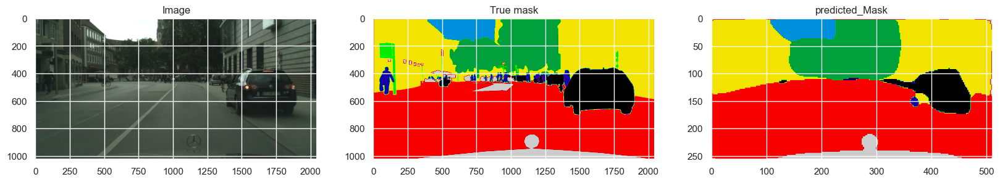

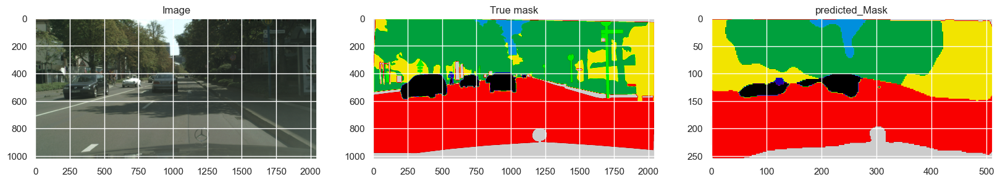

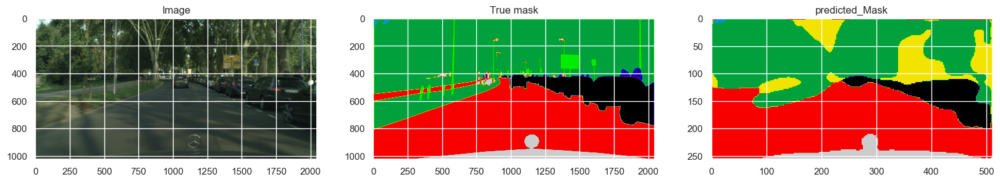

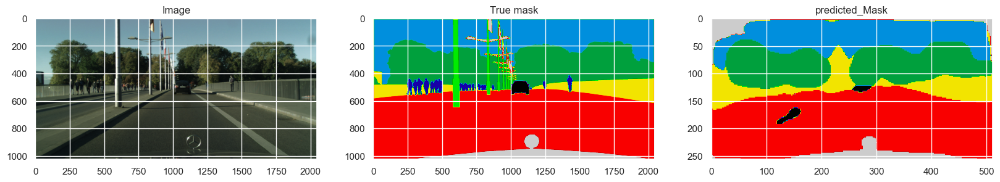

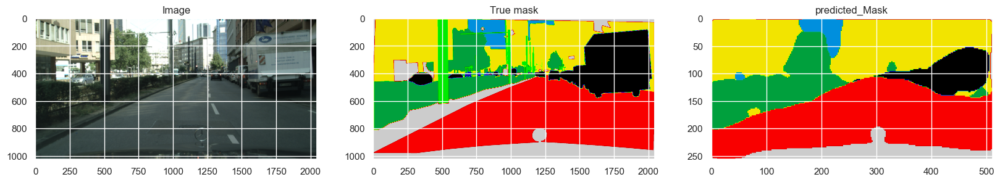

In [95]:
# Plot image, mask and prediction
plot_image_mask_prediction(resnet50_segnet, test_input_path, test_target_path, 
                           img_height, img_width, random=True, n=5)

## Création du dataframe de comparaison
Dataframe qui permet de comparer les résultats de tous les modèles

In [96]:
# On transforme tab_compare en dataframe 
df_tab_compare = pd.DataFrame(tab_compare, columns = ['Model testé', 'Score du modèle', 'Loss', 'Temps entraînement', 'Temps évaluation'])
df_tab_compare

,Model testé,Score du modèle,Loss,Temps entraînement,Temps évaluation
0,VGG16 Unet Data augmentation,0.453120,"[0.3314744532108307, 0.16966237127780914, 0.10...",7826.674315,44.129630
1,VGG16 Unet,0.441896,"[0.3303050994873047, 0.16311286389827728, 0.10...",7043.661672,39.022350
2,VGG16 Unet image-segmentation,0.421792,"[1.1589802503585815, 0.9805290699005127, 0.908...",3604.311468,82.808913
3,fcn_8_vgg,0.486791,"[1.895797848701477, 0.7345683574676514, 0.5958...",1538.020195,154.564079
4,VGG16 Segnet,0.313856,"[1.3174656629562378, 1.1828336715698242, 1.084...",3722.346663,84.760703
5,Resnet50 Unet,0.497646,"[1.0705024003982544, 0.8006688356399536, 0.755...",7322.738726,91.864505
6,Resnet50 Segnet,0.509424,"[0.9899129867553711, 0.7857523560523987, 0.684...",5813.350016,125.645732


#### Comparaison des différents modèles
- Le modèle avec le meilleur score mean_io_u est le modèle VGG16 FCN de la librairie keras-segmentation (0.51 > 0.45)
- Cependant ils possèdent un temps d'évaluation plus long ce qui est une problématique pour l'intégrer dans une voiture autonome (120.90 temps d'évaluation)
- Le second modèle au niveau du score mean_IOU est le modèle interne VGG16 Unet avec de la Data augmentation où le temps d'entraînement est plus long mais le temps d'évaluation est nettement plus rapide (38.0 temps d'évaluation)
- En comparant la segmentation de certaines images aléatoires de tests, les images du modèle interne ont une meilleure rendue

**En prenant en compte toutes ses raisons, on choisit le modèle interne VGG16 Unet avec de la Data augmentation pour être déployé**

In [54]:
build_vgg16_dm.save("best_model")

INFO:tensorflow:Assets written to: best_model\assets


INFO:tensorflow:Assets written to: best_model\assets
